<a href="https://colab.research.google.com/github/aalvarez359/3dunet-vs-medam-brain-tumor/blob/main/inference/msd/medsam2_inference_msd_brain_flair.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Run 1-2, 3a, 4, 5a, 6, 7a to for MSD MedSAM2 3-Modality Inference

Run 1-2, 3b, 4, 5b, 6, 7b to for MSD MedSAM2 FLAIR-Only Inference

#1

In [ ]:
# Cell 1: Install dependencies and clone MedSAM2
!pip install SimpleITK nibabel scikit-image --quiet

!git clone https://github.com/bowang-lab/MedSAM2.git
%cd MedSAM2

# Install MedSAM2 as an editable package
%pip install -e . --quiet

# Download MedSAM2 checkpoint
!mkdir -p checkpoints
!wget -q -P checkpoints https://huggingface.co/wanglab/MedSAM2/resolve/main/MedSAM2_2411.pt


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.6/52.6 MB 36.9 MB/s eta 0:00:00
Cloning into 'MedSAM2'...
remote: Enumerating objects: 297, done.
remote: Counting objects: 100% (153/153), done.
remote: Compressing objects: 100% (90/90), done.
remote: Total 297 (delta 90), reused 63 (delta 63), pack-reused 144 (from 1)
Receiving objects: 100% (297/297), 18.82 MiB | 12.46 MiB/s, done.
Resolving deltas: 100% (122/122), done.
/content/MedSAM2
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 3.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 10.2 MB/s eta 0:00:00
  Building editable for MedSAM2 (pyproject.toml) ... done


#2

In [ ]:
# Cell 2: Mount Google Drive and define paths
from google.colab import drive
drive.mount('/content/drive')

import os, json

# Path to your dataset_split.json (from the file you uploaded)
SPLIT_JSON_PATH = "/content/drive/MyDrive/BrainTumor_Checkpoints/dataset_split.json"

# Directory where you want to save MedSAM2 segmentations
OUTPUT_ROOT = "/content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results"
os.makedirs(OUTPUT_ROOT, exist_ok=True)

# MedSAM2 config and checkpoint
MODEL_CFG = "configs/sam2.1_hiera_t512.yaml"
CHECKPOINT = "./checkpoints/MedSAM2_2411.pt"

# Load split file (has 'train', 'val', 'test')
with open(SPLIT_JSON_PATH, "r") as f:
    splits = json.load(f)

test_cases = splits["test"]   # list of dicts {"image": "...BRATS_XXX.nii.gz", "label": "...labelsTr/BRATS_XXX.nii.gz"}
len(test_cases)


Mounted at /content/drive


97

#3a MSD 3-Mod

In [ ]:
# Cell 3: Helper functions for BRATS multi-modal (FLAIR, T1gd, T2w) + MedSAM2

import numpy as np
import nibabel as nib
import SimpleITK as sitk
import torch
from collections import OrderedDict
import matplotlib.pyplot as plt
from skimage import measure
from PIL import Image

from sam2.build_sam import build_sam2_video_predictor_npz

torch.set_float32_matmul_precision('high')
torch.manual_seed(2024)
torch.cuda.manual_seed(2024)
np.random.seed(2024)

# ---- Basic utilities ----

def getLargestCC(segmentation):
    """Keep only the largest connected component."""
    labels = measure.label(segmentation)
    if labels.max() == 0:
        return segmentation
    largestCC = labels == (np.argmax(np.bincount(labels.flat)[1:]) + 1)
    return largestCC

def show_box(box, ax, edgecolor='red'):
    """Visualize bounding box on an image."""
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle(
        (x0, y0), w, h,
        edgecolor=edgecolor,
        facecolor=(0, 0, 0, 0),
        lw=2
    ))

def show_mask(mask, ax, mask_color=None, alpha=0.5):
    """Overlay segmentation mask on image."""
    if mask_color is not None:
        color = np.concatenate([mask_color, np.array([alpha])], axis=0)
    else:
        color = np.array([251/255, 252/255, 30/255, alpha])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def normalize_to_uint8(volume):
    """
    Normalize a 2D or 3D volume to [0, 255] uint8.
    Simple min-max normalization.
    """
    v = volume.astype(np.float32)
    v_min, v_max = np.min(v), np.max(v)
    if v_max <= v_min:
        return np.zeros_like(v, dtype=np.uint8)
    v = (v - v_min) / (v_max - v_min)
    v = (v * 255.0).clip(0, 255)
    return v.astype(np.uint8)

# ---- BRATS multi-modal loader ----

def load_multimodal_and_label(image_path, label_path, modality_indices=(0, 2, 3)):
    """
    Load 4D BRATS image and label and extract 3 modalities.

    BRATS image shape: (X, Y, Z, 4)
      - 0: FLAIR
      - 1: T1w
      - 2: T1gd
      - 3: T2w

    We:
      1. Take the channels given by modality_indices -> 3 volumes (X, Y, Z)
      2. Reorder each to (Z, X, Y) = (D, H, W) like before
      3. Stack to (C=3, D, H, W)
      4. Label is also reordered to (D, H, W)
    """
    img_nii = nib.load(image_path)
    lbl_nii = nib.load(label_path)

    img = img_nii.get_fdata()    # (X, Y, Z, 4)
    lbl = lbl_nii.get_fdata()    # (X, Y, Z)

    vols = []
    for ch in modality_indices:
        v_xyz = img[..., ch]                    # (X, Y, Z)
        v_dhw = np.moveaxis(v_xyz, 2, 0)        # (Z, X, Y) -> treat as (D, H, W)
        vols.append(v_dhw)

    # Stack to (C=3, D, H, W)
    multi_cdhw = np.stack(vols, axis=0)         # (3, D, H, W)

    # Label -> (D, H, W)
    lbl_dhw = np.moveaxis(lbl, 2, 0)

    return multi_cdhw, lbl_dhw, img_nii, lbl_nii

def build_rgb_video_from_modalities(vol_cdhw, image_size=512):
    """
    vol_cdhw: (C=3, D, H, W) three MRI modalities.
    Returns: 'video' tensor of shape (D, 3, image_size, image_size)
             ready for MedSAM2.

    Steps:
      1. Normalize each modality (3D) to [0, 255] uint8
      2. For each slice z:
           - assemble (H, W, 3) from the 3 modalities
           - resize to (image_size, image_size)
           - transpose to (3, H, W)
    """
    C, D, H, W = vol_cdhw.shape
    assert C == 3, f"Expected 3 modalities, got {C}"

    # Per-modality 3D normalization -> uint8
    vol_uint8 = np.zeros_like(vol_cdhw, dtype=np.uint8)
    for c in range(C):
        vol_uint8[c] = normalize_to_uint8(vol_cdhw[c])  # (D, H, W)

    video = np.zeros((D, 3, image_size, image_size), dtype=np.float32)

    for z in range(D):
        # (H, W, 3): [FLAIR, T1gd, T2w] at this slice
        slice_hw3 = np.stack(
            [vol_uint8[c, z] for c in range(C)],
            axis=-1
        )  # (H, W, 3)

        img_pil = Image.fromarray(slice_hw3, mode="RGB")
        img_resized = img_pil.resize((image_size, image_size))
        img_array = np.array(img_resized).transpose(2, 0, 1)  # (3, H, W)

        video[z] = img_array

    return video  # (D, 3, image_size, image_size)
def get_key_slice_and_bbox_from_label(lbl_3d):
    """
    Given a 3D label volume (D, H, W), choose:
      - key_slice_idx = mid-slice of the tumor in Z
      - bbox = [x_min, y_min, x_max, y_max] in that slice
    Uses all labels > 0 as 'tumor'.
    """
    z_idx, y_idx, x_idx = np.where(lbl_3d > 0)
    if len(z_idx) == 0:
        return None, None  # no tumor

    z_min, z_max = z_idx.min(), z_idx.max()
    key_slice_idx = int((z_min + z_max) // 2)

    slice_mask = lbl_3d[key_slice_idx] > 0
    y2, x2 = np.where(slice_mask)
    if len(y2) == 0:
        return None, None

    x_min, x_max = x2.min(), x2.max()
    y_min, y_max = y2.min(), y2.max()

    bbox = np.array([x_min, y_min, x_max, y_max], dtype=np.int32)
    return key_slice_idx, bbox


# ---- MedSAM2 predictor initialization ----

device = "cuda" if torch.cuda.is_available() else "cpu"
print("Using device:", device)

predictor = build_sam2_video_predictor_npz(MODEL_CFG, CHECKPOINT)

# ---- MedSAM2 multi-modal runner ----

def run_medsam2_on_multimodal_volume(multi_cdhw, key_slice_idx, bbox, image_size=512):
    """
    Run MedSAM2 propagation on a 3-modality 3D volume.

    multi_cdhw: (C=3, D, H, W) = (FLAIR, T1gd, T2w)
    key_slice_idx: int, chosen from label (mid tumor slice)
    bbox: [x_min, y_min, x_max, y_max] on that slice, in (H,W) coords

    Returns: 3D binary mask (D, H, W) for "whole tumor" (MedSAM2 single-class).
    """
    C, D, H, W = multi_cdhw.shape
    assert C == 3, "Expected 3 modalities (FLAIR, T1gd, T2w)"

    segs_3D = np.zeros((D, H, W), dtype=np.uint8)

    # Build "video" from the 3 modalities
    video = build_rgb_video_from_modalities(multi_cdhw, image_size=image_size)  # (D, 3, 512, 512)

    video = video / 255.0
    video = torch.from_numpy(video).to(device)  # (D, 3, 512, 512)

    # You *can* keep ImageNet-style normalization (as in the CT demo).
    img_mean = torch.tensor((0.485, 0.456, 0.406), dtype=torch.float32)[:, None, None].to(device)
    img_std  = torch.tensor((0.229, 0.224, 0.225), dtype=torch.float32)[:, None, None].to(device)
    video = (video - img_mean) / img_std

    key_slice_idx = int(key_slice_idx)
    video_height = H   # original in-plane height
    video_width  = W   # original in-plane width

    with torch.inference_mode(), torch.autocast(
        device_type=device,
        dtype=torch.bfloat16 if device == "cuda" else torch.float16
    ):
        # --- Forward propagation ---
        inference_state = predictor.init_state(video, video_height, video_width)

        _, out_obj_ids, out_mask_logits = predictor.add_new_points_or_box(
            inference_state=inference_state,
            frame_idx=key_slice_idx,
            obj_id=1,
            box=bbox,
        )

        for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state):
            mask = (out_mask_logits[0] > 0.0).detach().cpu().numpy()[0]  # (H, W)
            segs_3D[out_frame_idx][mask] = 1

        predictor.reset_state(inference_state)

        # --- Reverse propagation ---
        _, out_obj_ids, out_mask_logits = predictor.add_new_points_or_box(
            inference_state=inference_state,
            frame_idx=key_slice_idx,
            obj_id=1,
            box=bbox,
        )

        for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(
            inference_state,
            reverse=True
        ):
            mask = (out_mask_logits[0] > 0.0).detach().cpu().numpy()[0]
            segs_3D[out_frame_idx][mask] = 1

        predictor.reset_state(inference_state)

    # Keep only largest connected component (whole tumor)
    if segs_3D.max() > 0:
        segs_3D = getLargestCC(segs_3D).astype(np.uint8)

    return segs_3D


Using device: cuda


#3b MSD Flair

In [ ]:
# Cell 3: Helper functions for MSD FLAIR + MedSAM2

import numpy as np
import nibabel as nib
import SimpleITK as sitk
import torch
from collections import OrderedDict
import matplotlib.pyplot as plt
from skimage import measure
from PIL import Image

from sam2.build_sam import build_sam2_video_predictor_npz

torch.set_float32_matmul_precision('high')
torch.manual_seed(2024)
torch.cuda.manual_seed(2024)
np.random.seed(2024)

# ---- Basic utilities ----

def getLargestCC(segmentation):
    """Keep only the largest connected component."""
    labels = measure.label(segmentation)
    if labels.max() == 0:
        return segmentation
    largestCC = labels == np.argmax(np.bincount(labels.flat)[1:]) + 1
    return largestCC

def resize_grayscale_to_rgb_and_resize(array, image_size):
    """
    Resize a 3D grayscale NumPy array (D, H, W) to an RGB 'video' (D, 3, image_size, image_size).
    """
    d, h, w = array.shape
    resized_array = np.zeros((d, 3, image_size, image_size), dtype=np.float32)

    for i in range(d):
        img_pil = Image.fromarray(array[i].astype(np.uint8))
        img_rgb = img_pil.convert("RGB")
        img_resized = img_rgb.resize((image_size, image_size))
        img_array = np.array(img_resized).transpose(2, 0, 1)  # (3, H, W)
        resized_array[i] = img_array

    return resized_array

def show_box(box, ax, edgecolor='red'):
    """Visualize bounding box on an image."""
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor=edgecolor,
                               facecolor=(0,0,0,0), lw=2))

def show_mask(mask, ax, mask_color=None, alpha=0.5):
    """Overlay segmentation mask on image."""
    if mask_color is not None:
        color = np.concatenate([mask_color, np.array([alpha])], axis=0)
    else:
        color = np.array([251/255, 252/255, 30/255, alpha])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

# ---- BRATS-specific utilities ----

def load_flair_and_label(image_path, label_path, flair_channel_index=0):
    """
    Load 4D BRATS image and label.
    - image shape: (X, Y, Z, 4)
    - label shape: (X, Y, Z)
    We:
      1. Take FLAIR channel (index 0) -> (X, Y, Z)
      2. Reorder to (Z, Y, X) ~ (D, H, W) to match MedSAM2 expectation.
    """
    img_nii = nib.load(image_path)
    lbl_nii = nib.load(label_path)

    img = img_nii.get_fdata()    # (X, Y, Z, 4)
    lbl = lbl_nii.get_fdata()    # (X, Y, Z)

    flair_xyz = img[..., flair_channel_index]   # (X, Y, Z)
    # Move Z axis to front: (Z, X, Y) then swap to (Z, Y, X) if you prefer; but
    # MedSAM2 only cares that we are consistent. We'll use (Z, Y, X) = (D, H, W).
    flair_dhw = np.moveaxis(flair_xyz, 2, 0)  # (Z, X, Y) = (D, H, W) since X,Y symmetric in BRATS
    lbl_dhw   = np.moveaxis(lbl, 2, 0)        # same reorder

    return flair_dhw, lbl_dhw, img_nii, lbl_nii

def get_key_slice_and_bbox_from_label(lbl_3d):
    """
    Given a 3D label volume (D, H, W), choose:
      - key_slice_idx = mid-slice of the tumor in Z
      - bbox = [x_min, y_min, x_max, y_max] in that slice
    Uses all labels > 0 as 'tumor'.
    """
    # voxels belonging to tumor
    z_idx, y_idx, x_idx = np.where(lbl_3d > 0)
    if len(z_idx) == 0:
        return None, None  # no tumor

    z_min, z_max = z_idx.min(), z_idx.max()
    key_slice_idx = int((z_min + z_max) // 2)

    # in that slice, compute 2D bbox from tumor pixels
    slice_mask = lbl_3d[key_slice_idx] > 0
    y2, x2 = np.where(slice_mask)
    if len(y2) == 0:
        return None, None

    x_min, x_max = x2.min(), x2.max()
    y_min, y_max = y2.min(), y2.max()

    bbox = np.array([x_min, y_min, x_max, y_max], dtype=np.int32)
    return key_slice_idx, bbox

def normalize_to_uint8(volume):
    """
    Normalize a 3D volume (D, H, W) to [0, 255] uint8.
    Simple min-max normalization.
    """
    v = volume.astype(np.float32)
    v_min, v_max = np.min(v), np.max(v)
    if v_max <= v_min:
        return np.zeros_like(v, dtype=np.uint8)
    v = (v - v_min) / (v_max - v_min)
    v = (v * 255.0).clip(0, 255)
    return v.astype(np.uint8)

# ---- MedSAM2 predictor initialization ----

device = "cuda" if torch.cuda.is_available() else "cpu"
print("Using device:", device)

predictor = build_sam2_video_predictor_npz(MODEL_CFG, CHECKPOINT)


Using device: cuda


#4

Sample image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_137.nii.gz
Sample label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_137.nii.gz
FLAIR shape (D,H,W): (155, 240, 240)
Label  shape (D,H,W): (155, 240, 240)
key_slice_idx: 68
bbox [x_min, y_min, x_max, y_max]: [ 52  62 148 183]


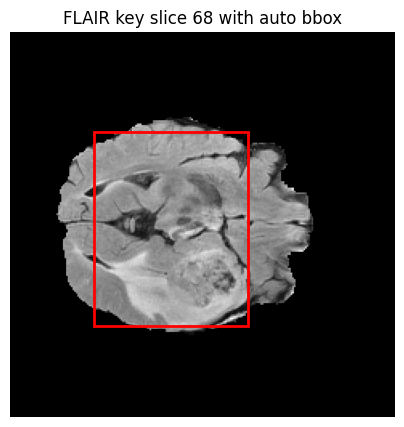

In [ ]:
# Cell 4: Preview - run ROI selection + MedSAM2 on a single test case

from tqdm import tqdm

# Pick the first test case
sample_case = test_cases[0]
image_path = sample_case["image"]
label_path = sample_case["label"]

print("Sample image:", image_path)
print("Sample label:", label_path)

# Load FLAIR + label in (D, H, W)
flair_3d, lbl_3d, img_nii, lbl_nii = load_flair_and_label(image_path, label_path)

print("FLAIR shape (D,H,W):", flair_3d.shape)
print("Label  shape (D,H,W):", lbl_3d.shape)

# Compute key slice and bbox from ground truth
key_slice_idx, bbox = get_key_slice_and_bbox_from_label(lbl_3d)

print("key_slice_idx:", key_slice_idx)
print("bbox [x_min, y_min, x_max, y_max]:", bbox)

# Visualize the slice with bbox
slice_img = normalize_to_uint8(flair_3d[key_slice_idx])

fig, ax = plt.subplots(1, 1, figsize=(5,5))
ax.imshow(slice_img, cmap="gray")
if bbox is not None:
    show_box(bbox, ax, edgecolor="red")
ax.set_title(f"FLAIR key slice {key_slice_idx} with auto bbox")
ax.axis("off")
plt.show()


#5a multi-mod

Modalities shapes (D,H,W):
  FLAIR: (155, 240, 240)
  T1   : (155, 240, 240)
  T1ce : (155, 240, 240)
  T2   : (155, 240, 240)
Using key_slice_idx: 68
Using bbox: [ 52  62 148 183]


propagate in video: 100%|██████████| 69/69 [00:01<00:00, 38.05it/s]


Individual MedSAM2 prediction shapes:
  FLAIR: (155, 240, 240)
  T1   : (155, 240, 240)
  T1ce : (155, 240, 240)
  T2   : (155, 240, 240)
Combined majority-vote prediction shape: (155, 240, 240)


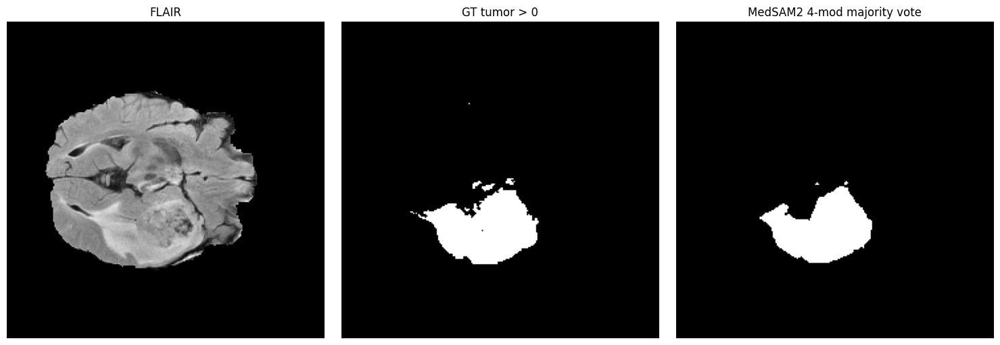

In [ ]:
# Cell 5: Run MedSAM2 on a single BRATS case with 4-modality majority vote

def run_medsam2_on_volume(volume_3d, key_slice_idx, bbox):
    """
    Run MedSAM2 propagation on a generic 3D volume (D,H,W).
    Uses a single bounding box on key_slice_idx.
    Returns a 3D binary mask (D,H,W).
    """
    D, H, W = volume_3d.shape
    segs_3D = np.zeros((D, H, W), dtype=np.uint8)

    # Normalize to [0,255] and ensure uint8 for resizing
    vol_uint8 = normalize_to_uint8(volume_3d)

    # Resize to 512x512 for MedSAM2, but keep original H/W for mapping back
    video_height = H
    video_width  = W
    img_resized = resize_grayscale_to_rgb_and_resize(vol_uint8, 512)  # (D, 3, 512, 512)
    img_resized = img_resized / 255.0
    img_resized = torch.from_numpy(img_resized).to(device)

    # ImageNet-style normalization (same as CT demo)
    img_mean = torch.tensor((0.485, 0.456, 0.406), dtype=torch.float32)[:, None, None].to(device)
    img_std  = torch.tensor((0.229, 0.224, 0.225), dtype=torch.float32)[:, None, None].to(device)
    img_resized = (img_resized - img_mean) / img_std

    key_slice_idx = int(key_slice_idx)

    with torch.inference_mode(), torch.autocast(
        device_type=device,
        dtype=torch.bfloat16 if device == "cuda" else torch.float16
    ):
        # Init state with full volume as a "video"
        inference_state = predictor.init_state(img_resized, video_height, video_width)

        # Forward propagation
        _, out_obj_ids, out_mask_logits = predictor.add_new_points_or_box(
            inference_state=inference_state,
            frame_idx=key_slice_idx,
            obj_id=1,
            box=bbox,
        )

        for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state):
            mask = (out_mask_logits[0] > 0.0).detach().cpu().numpy()[0]
            segs_3D[out_frame_idx][mask] = 1

        predictor.reset_state(inference_state)

        # Reverse propagation
        _, out_obj_ids, out_mask_logits = predictor.add_new_points_or_box(
            inference_state=inference_state,
            frame_idx=key_slice_idx,
            obj_id=1,
            box=bbox,
        )

        for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state, reverse=True):
            mask = (out_mask_logits[0] > 0.0).detach().cpu().numpy()[0]
            segs_3D[out_frame_idx][mask] = 1

        predictor.reset_state(inference_state)

    # Keep only largest connected component (optional but usually good for single tumor)
    if segs_3D.max() > 0:
        segs_3D = getLargestCC(segs_3D).astype(np.uint8)

    return segs_3D

# --- Now: run MedSAM2 on ALL FOUR modalities for the sample case, then majority vote ---

# Reload all modalities + label in (D,H,W) for the same sample case
vols_3d, lbl_3d, img_nii, lbl_nii = load_all_modalities_and_label(image_path, label_path)

flair_3d = vols_3d["flair"]
t1_3d    = vols_3d["t1"]
t1ce_3d  = vols_3d["t1ce"]
t2_3d    = vols_3d["t2"]

print("Modalities shapes (D,H,W):")
print("  FLAIR:", flair_3d.shape)
print("  T1   :", t1_3d.shape)
print("  T1ce :", t1ce_3d.shape)
print("  T2   :", t2_3d.shape)

# Use key_slice_idx and bbox computed in Cell 4 from the label
print("Using key_slice_idx:", key_slice_idx)
print("Using bbox:", bbox)

# Run MedSAM2 on each modality separately
pred_flair_3d = run_medsam2_on_volume(flair_3d, key_slice_idx, bbox)
pred_t1_3d    = run_medsam2_on_volume(t1_3d,    key_slice_idx, bbox)
pred_t1ce_3d  = run_medsam2_on_volume(t1ce_3d,  key_slice_idx, bbox)
pred_t2_3d    = run_medsam2_on_volume(t2_3d,    key_slice_idx, bbox)

print("Individual MedSAM2 prediction shapes:")
print("  FLAIR:", pred_flair_3d.shape)
print("  T1   :", pred_t1_3d.shape)
print("  T1ce :", pred_t1ce_3d.shape)
print("  T2   :", pred_t2_3d.shape)

# Binarize, just in case
pred_flair_bin = (pred_flair_3d > 0).astype(np.uint8)
pred_t1_bin    = (pred_t1_3d    > 0).astype(np.uint8)
pred_t1ce_bin  = (pred_t1ce_3d  > 0).astype(np.uint8)
pred_t2_bin    = (pred_t2_3d    > 0).astype(np.uint8)

# Majority vote (>= 2 out of 4)
stack = np.stack(
    [pred_flair_bin, pred_t1_bin, pred_t1ce_bin, pred_t2_bin],
    axis=0
)  # (4, D,H,W)

votes = stack.sum(axis=0)           # (D,H,W)
pred_3d = (votes >= 2).astype(np.uint8)  # final combined mask

print("Combined majority-vote prediction shape:", pred_3d.shape)

# Visualize FLAIR slice vs GT vs combined MedSAM2 mask on key_slice_idx
fig, axs = plt.subplots(1, 3, figsize=(15,5))

axs[0].imshow(normalize_to_uint8(flair_3d[key_slice_idx]), cmap="gray")
axs[0].set_title("FLAIR")

axs[1].imshow(lbl_3d[key_slice_idx] > 0, cmap="gray")
axs[1].set_title("GT tumor > 0")

axs[2].imshow(pred_3d[key_slice_idx] > 0, cmap="gray")
axs[2].set_title("MedSAM2 4-mod majority vote")

for ax in axs:
    ax.axis("off")

plt.tight_layout()
plt.show()


#5b flair only

propagate in video: 100%|██████████| 69/69 [00:01<00:00, 36.53it/s]


Predicted mask shape: (155, 240, 240)


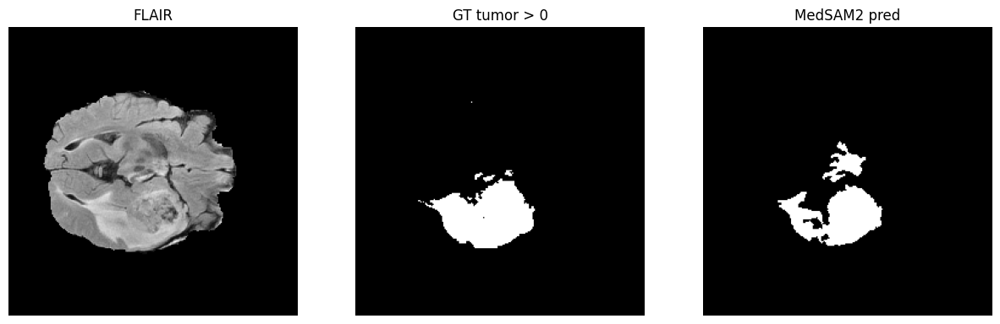

In [ ]:
# Cell 5: Function to run MedSAM2 on a single BRATS FLAIR volume

def run_medsam2_on_flair_volume(flair_3d, key_slice_idx, bbox):
    """
    Run MedSAM2 propagation on a 3D FLAIR volume (D,H,W).
    Uses a single bounding box on key_slice_idx.
    Returns a 3D binary mask (D,H,W).
    """
    D, H, W = flair_3d.shape
    segs_3D = np.zeros((D, H, W), dtype=np.uint8)

    # Normalize to [0,255] and ensure uint8 for display/resizing
    flair_uint8 = normalize_to_uint8(flair_3d)

    # Resize to 512x512 for MedSAM2, but keep original H/W for mapping back
    video_height = H
    video_width  = W
    img_resized = resize_grayscale_to_rgb_and_resize(flair_uint8, 512)  # (D, 3, 512, 512)
    img_resized = img_resized / 255.0
    img_resized = torch.from_numpy(img_resized).to(device)

    # ImageNet-style normalization (same as CT demo)
    img_mean = torch.tensor((0.485, 0.456, 0.406), dtype=torch.float32)[:, None, None].to(device)
    img_std  = torch.tensor((0.229, 0.224, 0.225), dtype=torch.float32)[:, None, None].to(device)
    img_resized = (img_resized - img_mean) / img_std

    key_slice_idx = int(key_slice_idx)

    with torch.inference_mode(), torch.autocast(device_type=device, dtype=torch.bfloat16 if device == "cuda" else torch.float16):
        inference_state = predictor.init_state(img_resized, video_height, video_width)

        # Forward propagation
        _, out_obj_ids, out_mask_logits = predictor.add_new_points_or_box(
            inference_state=inference_state,
            frame_idx=key_slice_idx,
            obj_id=1,
            box=bbox,
        )

        for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state):
            mask = (out_mask_logits[0] > 0.0).detach().cpu().numpy()[0]
            segs_3D[out_frame_idx][mask] = 1

        predictor.reset_state(inference_state)

        # Reverse propagation
        _, out_obj_ids, out_mask_logits = predictor.add_new_points_or_box(
            inference_state=inference_state,
            frame_idx=key_slice_idx,
            obj_id=1,
            box=bbox,
        )

        for out_frame_idx, out_obj_ids, out_mask_logits in predictor.propagate_in_video(inference_state, reverse=True):
            mask = (out_mask_logits[0] > 0.0).detach().cpu().numpy()[0]
            segs_3D[out_frame_idx][mask] = 1

        predictor.reset_state(inference_state)

    # Keep only largest connected component (optional but usually good for single tumor)
    if segs_3D.max() > 0:
        segs_3D = getLargestCC(segs_3D).astype(np.uint8)

    return segs_3D

# Quick test on the sample case
pred_3d = run_medsam2_on_flair_volume(flair_3d, key_slice_idx, bbox)
print("Predicted mask shape:", pred_3d.shape)

# Visualize prediction vs GT on key slice
fig, axs = plt.subplots(1, 3, figsize=(15,5))
axs[0].imshow(normalize_to_uint8(flair_3d[key_slice_idx]), cmap="gray")
axs[0].set_title("FLAIR")

axs[1].imshow(lbl_3d[key_slice_idx] > 0, cmap="gray")
axs[1].set_title("GT tumor > 0")

axs[2].imshow(pred_3d[key_slice_idx] > 0, cmap="gray")
axs[2].set_title("MedSAM2 pred")

for ax in axs:
    ax.axis("off")
plt.show()


#6

In [ ]:
# Cell 6: Save MedSAM2 prediction as NIfTI with correct BRATS orientation

import os
import nibabel as nib
import numpy as np

def save_pred_as_nifti(pred_3d, reference_nii, out_path):
    """
    pred_3d : (D,H,W) = (Z,X,Y) MedSAM2 prediction
    reference_nii : original BRATS image NIfTI (img_nii)
    out_path : where to save the .nii.gz file
    """

    # We originally did: (X,Y,Z) -> (Z,X,Y) via np.moveaxis(..., 2, 0)
    # So we now invert: (Z,X,Y) -> (X,Y,Z)
    pred_xyz = np.moveaxis(pred_3d, 0, 2)  # back to (X,Y,Z)

    pred_img = nib.Nifti1Image(
        pred_xyz.astype(np.uint8),
        affine=reference_nii.affine,
        header=reference_nii.header,
    )

    os.makedirs(os.path.dirname(out_path), exist_ok=True)
    nib.save(pred_img, out_path)
    print("Saved:", out_path)

print("Cell 6 loaded successfully — save_pred_as_nifti() is ready.")


Cell 6 loaded successfully — save_pred_as_nifti() is ready.


In [ ]:
out_path = "/content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_137_MedSAM2_FLAIR_mask.nii.gz"

save_pred_as_nifti(
    pred_3d,  # from Cell 5
    img_nii,  # from Cell 4/5 (the original BRATS_137 image nib object)
    out_path
)


Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_137_MedSAM2_FLAIR_mask.nii.gz


#7a msd 3-mod

MedSAM2 3-modality on BRATS test set:   0%|          | 0/97 [00:00<?, ?it/s]


=== Processing case: BRATS_137 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_137.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_137.nii.gz
  -> key_slice_idx: 68
  -> bbox [x_min, y_min, x_max, y_max]: [ 52  62 148 183]


/tmp/ipython-input-3992117271.py:131: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  img_pil = Image.fromarray(slice_hw3, mode="RGB")

propagate in video: 100%|██████████| 87/87 [00:02<00:00, 36.00it/s]

propagate in video: 100%|██████████| 69/69 [00:01<00:00, 35.88it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7037


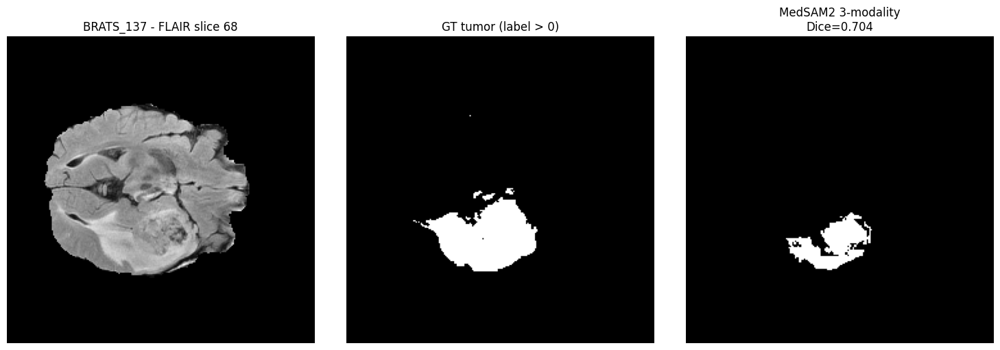

MedSAM2 3-modality on BRATS test set:   1%|          | 1/97 [00:07<12:00,  7.50s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_137_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_441 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_441.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_441.nii.gz
  -> key_slice_idx: 74
  -> bbox [x_min, y_min, x_max, y_max]: [ 40 115 141 185]



propagate in video: 100%|██████████| 81/81 [00:02<00:00, 35.13it/s]

propagate in video: 100%|██████████| 75/75 [00:02<00:00, 36.06it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8644


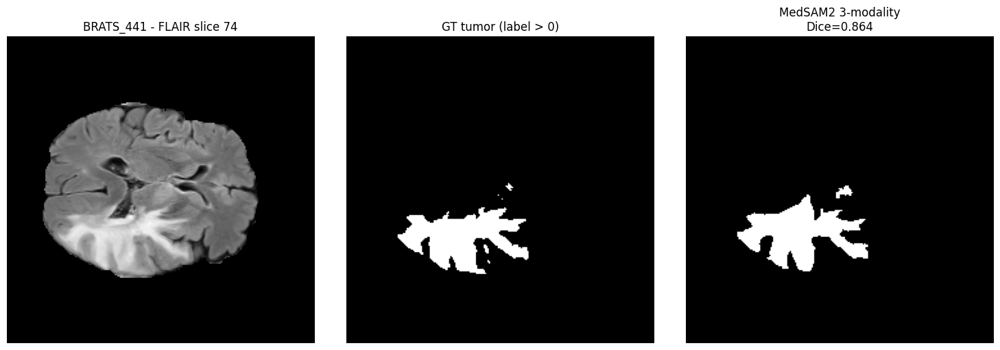

MedSAM2 3-modality on BRATS test set:   2%|▏         | 2/97 [00:17<14:34,  9.20s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_441_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_302 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_302.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_302.nii.gz
  -> key_slice_idx: 48
  -> bbox [x_min, y_min, x_max, y_max]: [ 97 137 157 171]



propagate in video: 100%|██████████| 107/107 [00:02<00:00, 35.73it/s]

propagate in video: 100%|██████████| 49/49 [00:01<00:00, 36.69it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7548


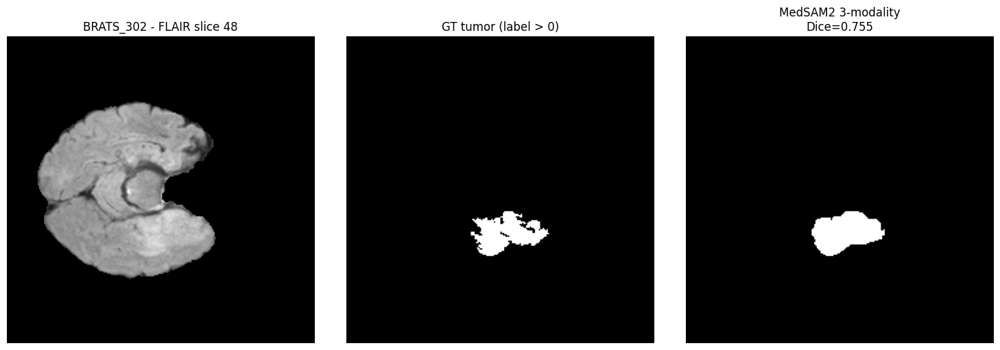

MedSAM2 3-modality on BRATS test set:   3%|▎         | 3/97 [00:28<15:16,  9.75s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_302_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_456 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_456.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_456.nii.gz
  -> key_slice_idx: 75
  -> bbox [x_min, y_min, x_max, y_max]: [ 53 122 158 185]



propagate in video: 100%|██████████| 80/80 [00:02<00:00, 35.62it/s]

propagate in video: 100%|██████████| 76/76 [00:02<00:00, 35.03it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8960


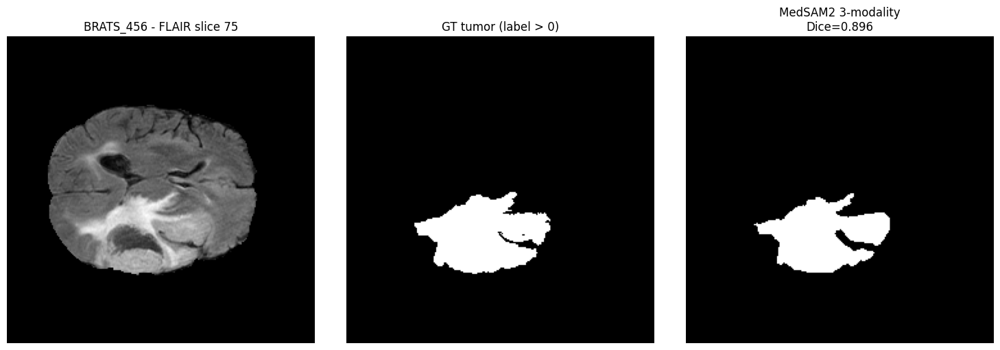

MedSAM2 3-modality on BRATS test set:   4%|▍         | 4/97 [00:38<15:25,  9.95s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_456_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_136 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_136.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_136.nii.gz
  -> key_slice_idx: 69
  -> bbox [x_min, y_min, x_max, y_max]: [ 54 123 136 169]



propagate in video: 100%|██████████| 86/86 [00:02<00:00, 36.24it/s]

propagate in video: 100%|██████████| 70/70 [00:01<00:00, 36.14it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.5069


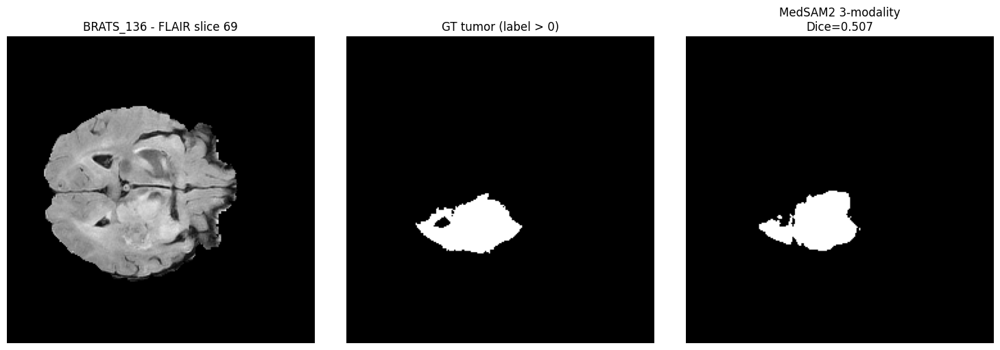

MedSAM2 3-modality on BRATS test set:   5%|▌         | 5/97 [00:49<15:44, 10.27s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_136_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_167 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_167.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_167.nii.gz
  -> key_slice_idx: 54
  -> bbox [x_min, y_min, x_max, y_max]: [ 41  67  76 101]



propagate in video: 100%|██████████| 101/101 [00:02<00:00, 35.85it/s]

propagate in video: 100%|██████████| 55/55 [00:01<00:00, 36.29it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8811


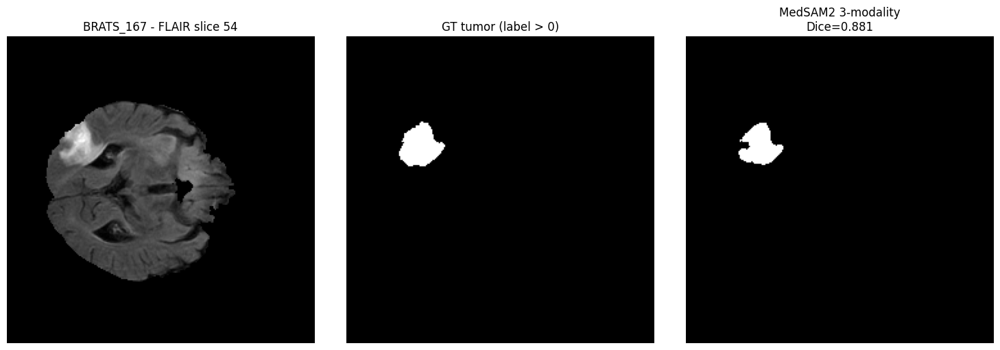

MedSAM2 3-modality on BRATS test set:   6%|▌         | 6/97 [01:00<16:12, 10.68s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_167_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_348 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_348.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_348.nii.gz
  -> key_slice_idx: 72
  -> bbox [x_min, y_min, x_max, y_max]: [ 51 131 136 179]



propagate in video: 100%|██████████| 83/83 [00:02<00:00, 35.91it/s]

propagate in video: 100%|██████████| 73/73 [00:01<00:00, 36.63it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8983


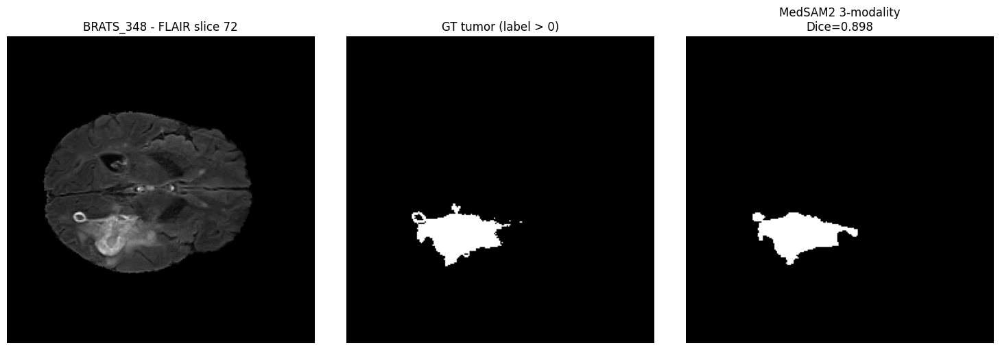

MedSAM2 3-modality on BRATS test set:   7%|▋         | 7/97 [01:11<15:54, 10.60s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_348_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_211 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_211.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_211.nii.gz
  -> key_slice_idx: 70
  -> bbox [x_min, y_min, x_max, y_max]: [ 49  63 125 103]



propagate in video: 100%|██████████| 85/85 [00:02<00:00, 34.29it/s]

propagate in video: 100%|██████████| 71/71 [00:01<00:00, 36.13it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7770


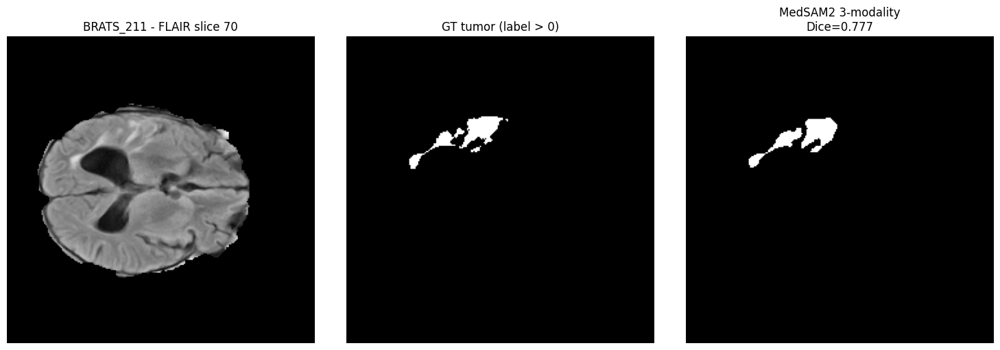

MedSAM2 3-modality on BRATS test set:   8%|▊         | 8/97 [01:22<16:12, 10.93s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_211_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_315 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_315.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_315.nii.gz
  -> key_slice_idx: 106
  -> bbox [x_min, y_min, x_max, y_max]: [ 97  93 169 154]



propagate in video: 100%|██████████| 49/49 [00:01<00:00, 35.68it/s]

propagate in video: 100%|██████████| 107/107 [00:03<00:00, 35.63it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.4313


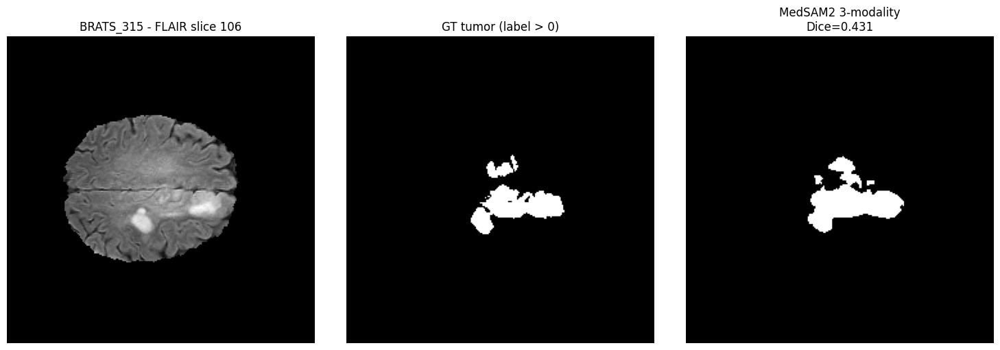

MedSAM2 3-modality on BRATS test set:   9%|▉         | 9/97 [01:33<15:56, 10.87s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_315_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_069 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_069.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_069.nii.gz
  -> key_slice_idx: 71
  -> bbox [x_min, y_min, x_max, y_max]: [ 76 131 158 166]



propagate in video: 100%|██████████| 84/84 [00:02<00:00, 35.87it/s]

propagate in video: 100%|██████████| 72/72 [00:02<00:00, 34.68it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7978


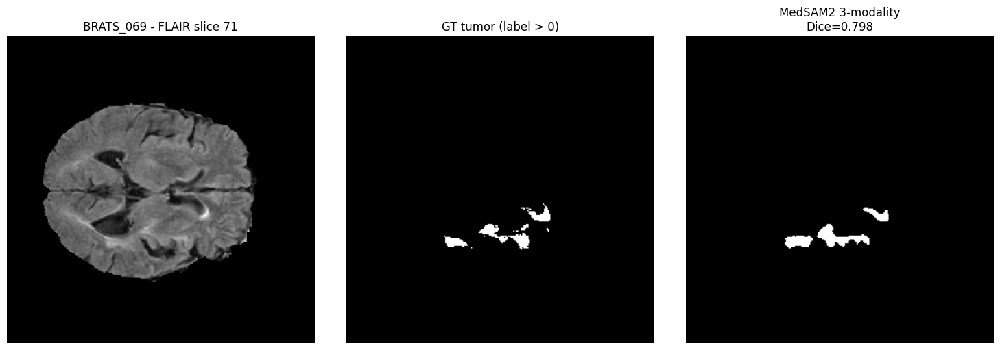

MedSAM2 3-modality on BRATS test set:  10%|█         | 10/97 [01:44<15:31, 10.71s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_069_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_297 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_297.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_297.nii.gz
  -> key_slice_idx: 83
  -> bbox [x_min, y_min, x_max, y_max]: [ 57  64 106 103]



propagate in video: 100%|██████████| 72/72 [00:02<00:00, 35.53it/s]

propagate in video: 100%|██████████| 84/84 [00:02<00:00, 35.41it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.6782


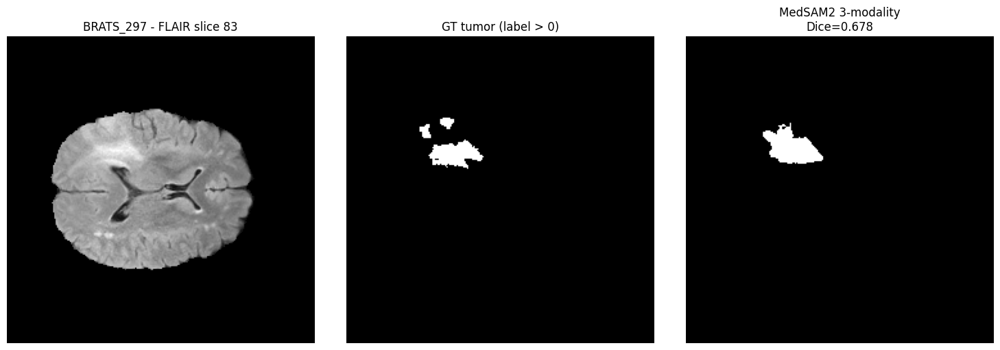

MedSAM2 3-modality on BRATS test set:  11%|█▏        | 11/97 [01:54<15:08, 10.57s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_297_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_345 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_345.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_345.nii.gz
  -> key_slice_idx: 95
  -> bbox [x_min, y_min, x_max, y_max]: [ 68 127 150 182]



propagate in video: 100%|██████████| 60/60 [00:01<00:00, 33.59it/s]

propagate in video: 100%|██████████| 96/96 [00:02<00:00, 34.89it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8219


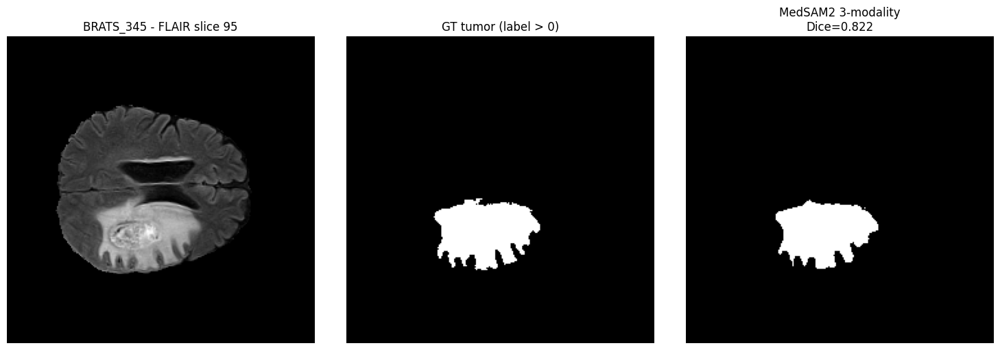

MedSAM2 3-modality on BRATS test set:  12%|█▏        | 12/97 [02:06<15:44, 11.11s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_345_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_404 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_404.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_404.nii.gz
  -> key_slice_idx: 67
  -> bbox [x_min, y_min, x_max, y_max]: [ 62  56 162 130]



propagate in video: 100%|██████████| 88/88 [00:02<00:00, 34.78it/s]

propagate in video: 100%|██████████| 68/68 [00:01<00:00, 35.80it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8620


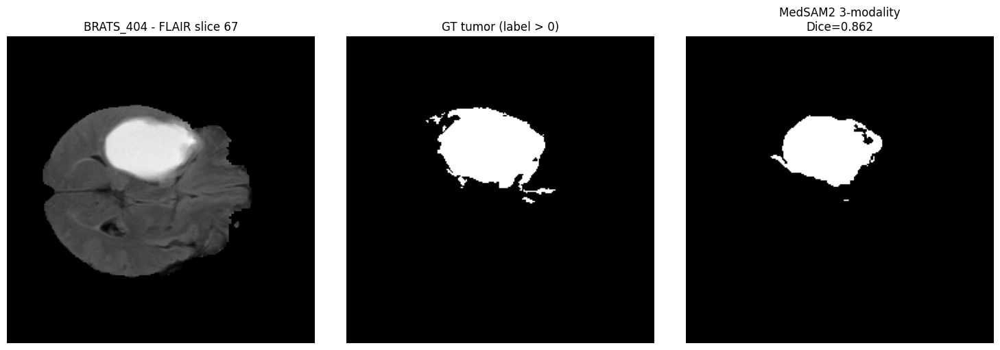

MedSAM2 3-modality on BRATS test set:  13%|█▎        | 13/97 [02:19<16:18, 11.65s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_404_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_296 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_296.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_296.nii.gz
  -> key_slice_idx: 54
  -> bbox [x_min, y_min, x_max, y_max]: [ 85 126 154 181]



propagate in video: 100%|██████████| 101/101 [00:02<00:00, 34.84it/s]

propagate in video: 100%|██████████| 55/55 [00:01<00:00, 35.38it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8229


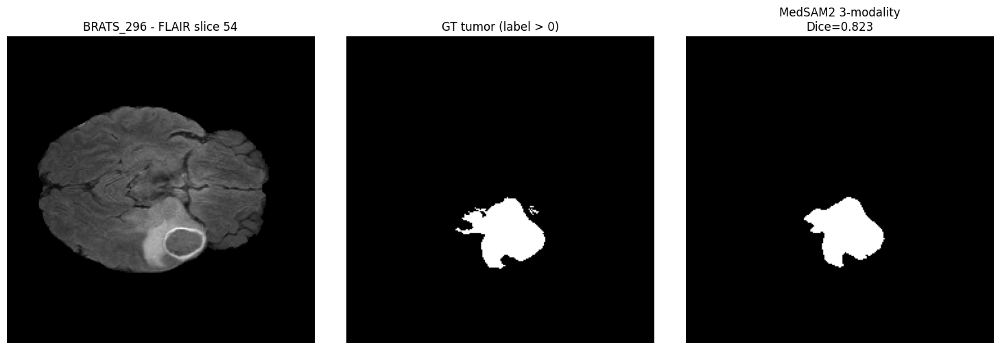

MedSAM2 3-modality on BRATS test set:  14%|█▍        | 14/97 [02:30<15:42, 11.36s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_296_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_261 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_261.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_261.nii.gz
  -> key_slice_idx: 81
  -> bbox [x_min, y_min, x_max, y_max]: [110  67 199 137]



propagate in video: 100%|██████████| 74/74 [00:02<00:00, 34.87it/s]

propagate in video: 100%|██████████| 82/82 [00:02<00:00, 34.80it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9042


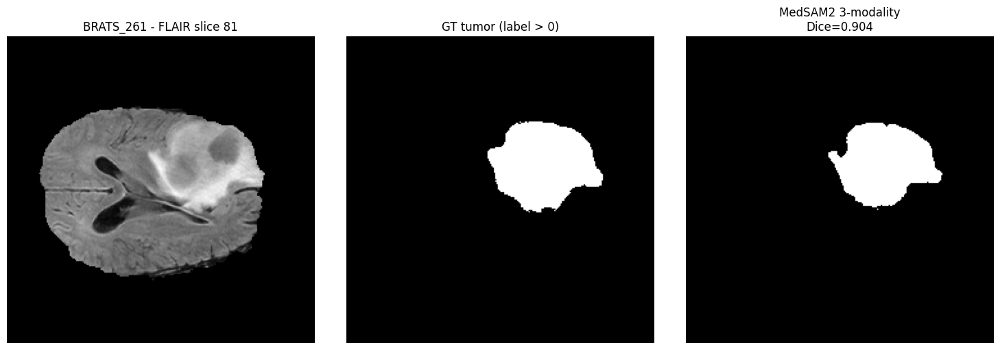

MedSAM2 3-modality on BRATS test set:  15%|█▌        | 15/97 [02:41<15:20, 11.22s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_261_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_405 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_405.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_405.nii.gz
  -> key_slice_idx: 92
  -> bbox [x_min, y_min, x_max, y_max]: [104 120 164 165]



propagate in video: 100%|██████████| 63/63 [00:01<00:00, 35.66it/s]

propagate in video: 100%|██████████| 93/93 [00:02<00:00, 35.34it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8814


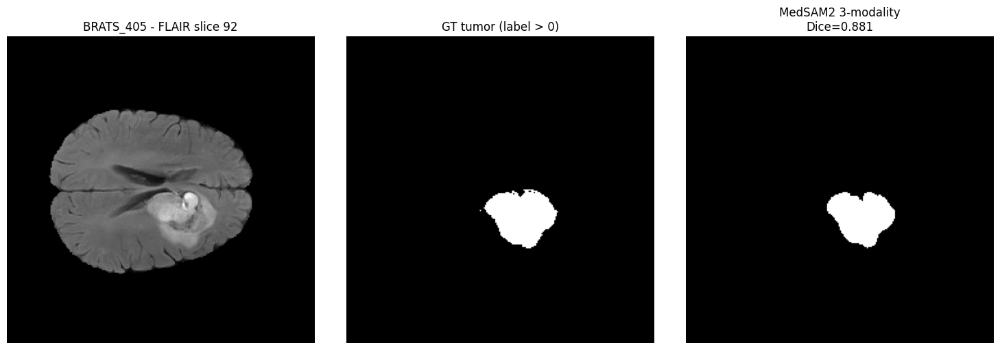

MedSAM2 3-modality on BRATS test set:  16%|█▋        | 16/97 [02:52<15:04, 11.16s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_405_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_234 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_234.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_234.nii.gz
  -> key_slice_idx: 87
  -> bbox [x_min, y_min, x_max, y_max]: [ 52  96 124 162]



propagate in video: 100%|██████████| 68/68 [00:01<00:00, 35.36it/s]

propagate in video: 100%|██████████| 88/88 [00:02<00:00, 36.26it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9230


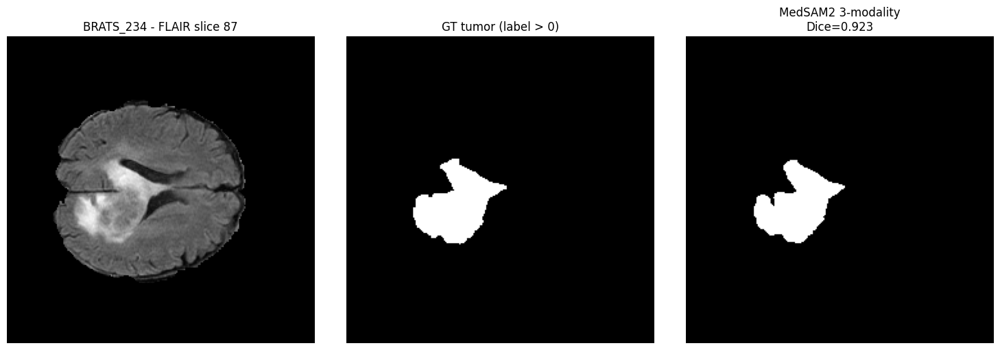

MedSAM2 3-modality on BRATS test set:  18%|█▊        | 17/97 [03:02<14:28, 10.85s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_234_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_462 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_462.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_462.nii.gz
  -> key_slice_idx: 52
  -> bbox [x_min, y_min, x_max, y_max]: [ 99  51 152 107]



propagate in video: 100%|██████████| 103/103 [00:02<00:00, 35.98it/s]

propagate in video: 100%|██████████| 53/53 [00:01<00:00, 35.28it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.6679


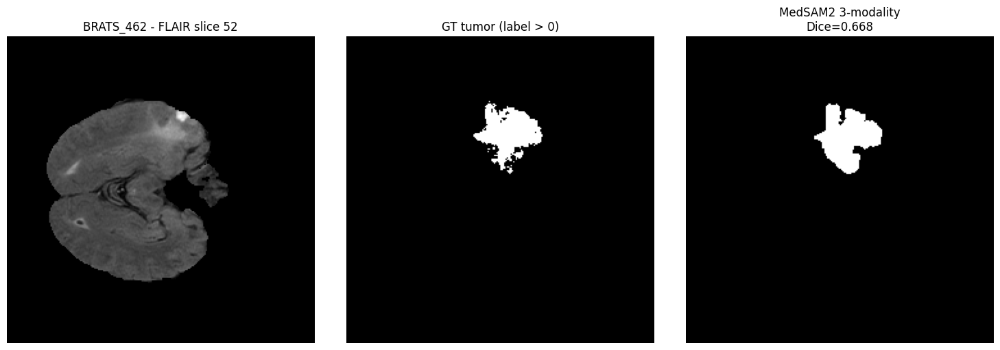

MedSAM2 3-modality on BRATS test set:  19%|█▊        | 18/97 [03:12<13:55, 10.58s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_462_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_032 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_032.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_032.nii.gz
  -> key_slice_idx: 89
  -> bbox [x_min, y_min, x_max, y_max]: [ 69  62 181 145]



propagate in video: 100%|██████████| 66/66 [00:01<00:00, 35.46it/s]

propagate in video: 100%|██████████| 90/90 [00:02<00:00, 36.18it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8216


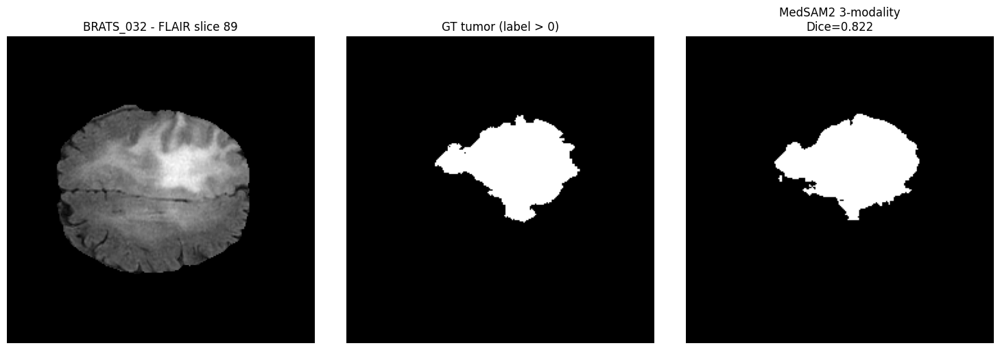

MedSAM2 3-modality on BRATS test set:  20%|█▉        | 19/97 [03:23<13:50, 10.65s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_032_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_428 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_428.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_428.nii.gz
  -> key_slice_idx: 66
  -> bbox [x_min, y_min, x_max, y_max]: [ 57  58 118 109]



propagate in video: 100%|██████████| 89/89 [00:02<00:00, 34.81it/s]

propagate in video: 100%|██████████| 67/67 [00:01<00:00, 35.67it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8859


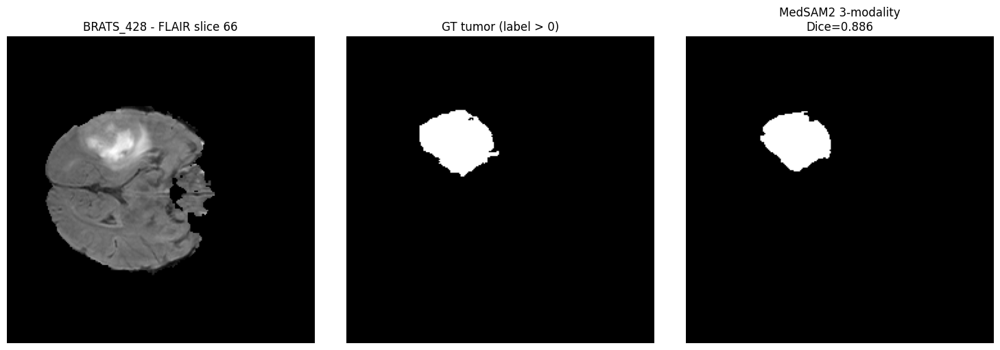

MedSAM2 3-modality on BRATS test set:  21%|██        | 20/97 [03:33<13:37, 10.61s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_428_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_109 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_109.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_109.nii.gz
  -> key_slice_idx: 93
  -> bbox [x_min, y_min, x_max, y_max]: [ 91  67 168 115]



propagate in video: 100%|██████████| 62/62 [00:01<00:00, 34.38it/s]

propagate in video: 100%|██████████| 94/94 [00:02<00:00, 35.44it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8465


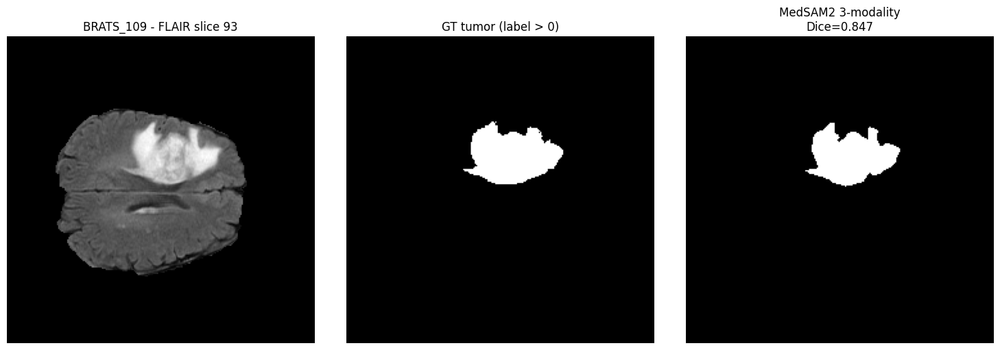

MedSAM2 3-modality on BRATS test set:  22%|██▏       | 21/97 [03:44<13:30, 10.67s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_109_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_346 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_346.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_346.nii.gz
  -> key_slice_idx: 98
  -> bbox [x_min, y_min, x_max, y_max]: [ 42 124  96 162]



propagate in video: 100%|██████████| 57/57 [00:01<00:00, 35.45it/s]

propagate in video: 100%|██████████| 99/99 [00:02<00:00, 34.69it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8380


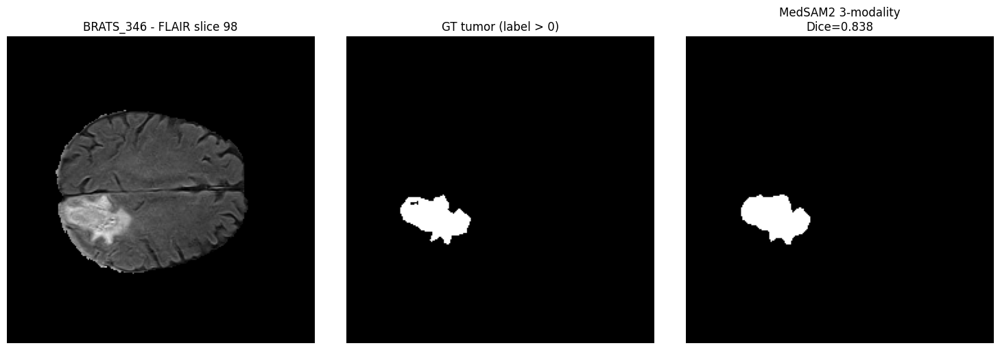

MedSAM2 3-modality on BRATS test set:  23%|██▎       | 22/97 [03:55<13:21, 10.69s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_346_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_306 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_306.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_306.nii.gz
  -> key_slice_idx: 63
  -> bbox [x_min, y_min, x_max, y_max]: [ 91  54 146  90]



propagate in video: 100%|██████████| 92/92 [00:02<00:00, 35.25it/s]

propagate in video: 100%|██████████| 64/64 [00:01<00:00, 35.39it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8244


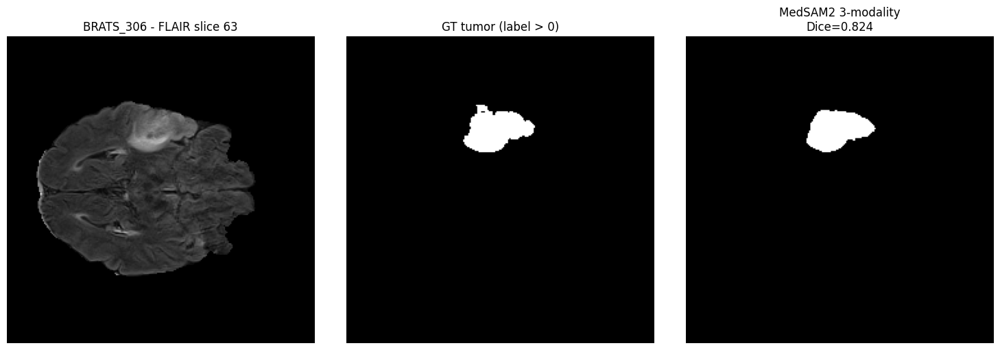

MedSAM2 3-modality on BRATS test set:  24%|██▎       | 23/97 [04:05<13:10, 10.69s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_306_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_047 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_047.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_047.nii.gz
  -> key_slice_idx: 97
  -> bbox [x_min, y_min, x_max, y_max]: [110 102 184 178]



propagate in video: 100%|██████████| 58/58 [00:01<00:00, 35.84it/s]

propagate in video: 100%|██████████| 98/98 [00:02<00:00, 35.42it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7773


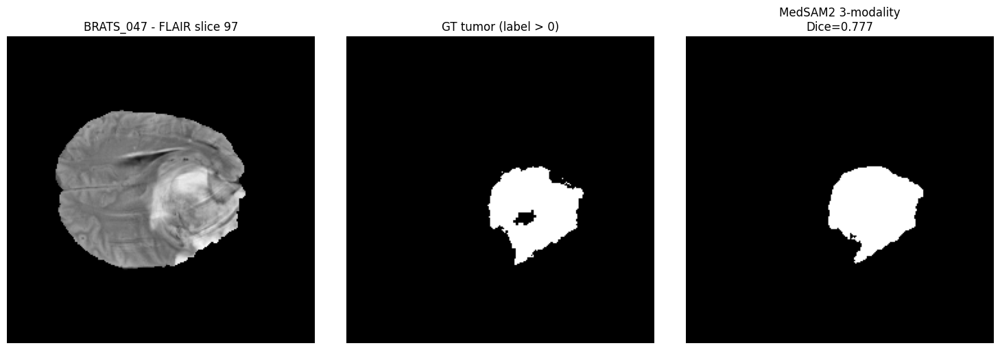

MedSAM2 3-modality on BRATS test set:  25%|██▍       | 24/97 [04:16<12:51, 10.57s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_047_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_339 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_339.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_339.nii.gz
  -> key_slice_idx: 87
  -> bbox [x_min, y_min, x_max, y_max]: [ 50 118 116 172]



propagate in video: 100%|██████████| 68/68 [00:01<00:00, 35.31it/s]

propagate in video: 100%|██████████| 88/88 [00:02<00:00, 35.85it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8823


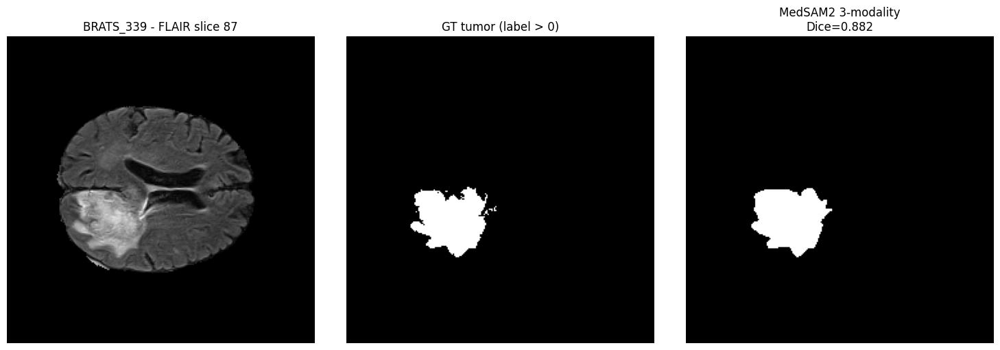

MedSAM2 3-modality on BRATS test set:  26%|██▌       | 25/97 [04:27<12:51, 10.71s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_339_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_142 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_142.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_142.nii.gz
  -> key_slice_idx: 73
  -> bbox [x_min, y_min, x_max, y_max]: [ 37  60 122 131]



propagate in video: 100%|██████████| 82/82 [00:02<00:00, 35.87it/s]

propagate in video: 100%|██████████| 74/74 [00:02<00:00, 36.02it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9396


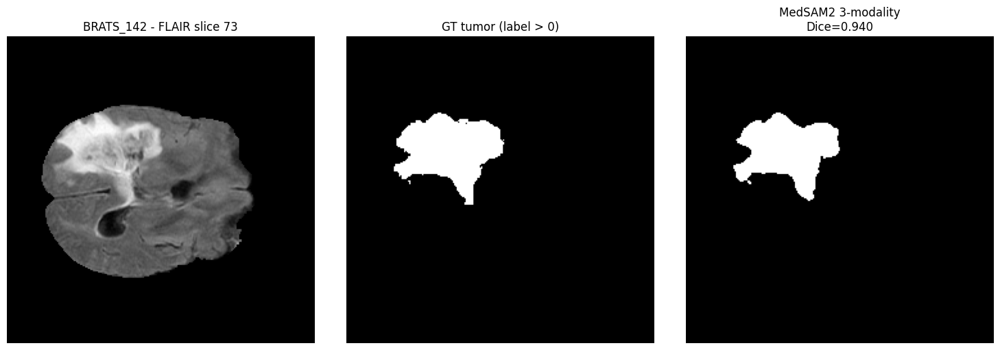

MedSAM2 3-modality on BRATS test set:  27%|██▋       | 26/97 [04:37<12:38, 10.68s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_142_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_164 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_164.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_164.nii.gz
  -> key_slice_idx: 82
  -> bbox [x_min, y_min, x_max, y_max]: [ 34  78  93 120]



propagate in video: 100%|██████████| 73/73 [00:02<00:00, 35.32it/s]

propagate in video: 100%|██████████| 83/83 [00:02<00:00, 36.03it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8652


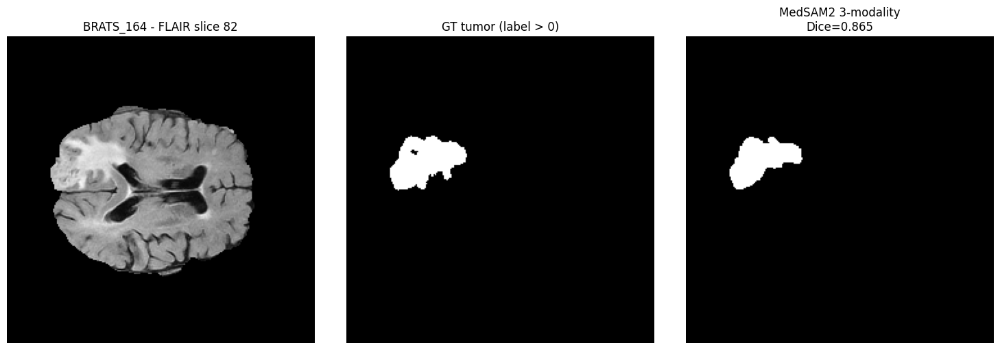

MedSAM2 3-modality on BRATS test set:  28%|██▊       | 27/97 [04:48<12:29, 10.71s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_164_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_469 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_469.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_469.nii.gz
  -> key_slice_idx: 108
  -> bbox [x_min, y_min, x_max, y_max]: [ 91 118 173 170]



propagate in video: 100%|██████████| 47/47 [00:01<00:00, 34.86it/s]

propagate in video: 100%|██████████| 109/109 [00:02<00:00, 36.41it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8969


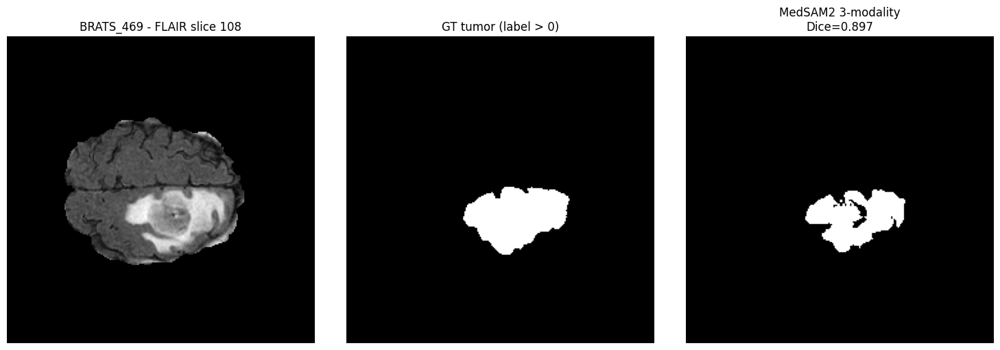

MedSAM2 3-modality on BRATS test set:  29%|██▉       | 28/97 [04:59<12:15, 10.65s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_469_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_402 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_402.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_402.nii.gz
  -> key_slice_idx: 62
  -> bbox [x_min, y_min, x_max, y_max]: [ 71  58 185 113]



propagate in video: 100%|██████████| 93/93 [00:02<00:00, 35.63it/s]

propagate in video: 100%|██████████| 63/63 [00:01<00:00, 35.47it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.5366


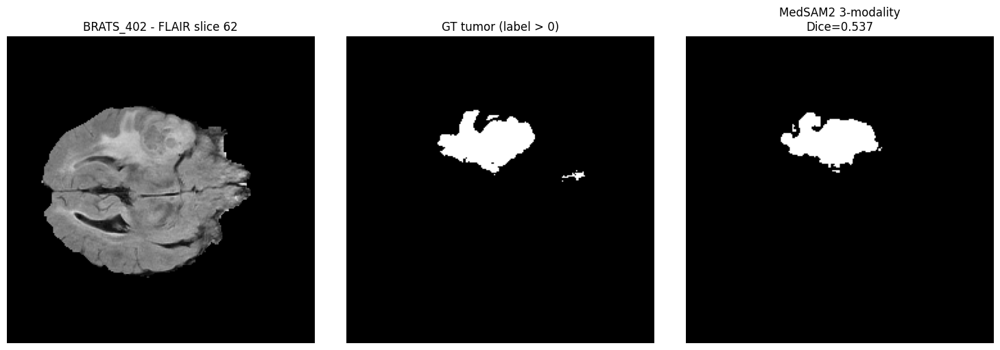

MedSAM2 3-modality on BRATS test set:  30%|██▉       | 29/97 [05:08<11:44, 10.36s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_402_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_043 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_043.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_043.nii.gz
  -> key_slice_idx: 93
  -> bbox [x_min, y_min, x_max, y_max]: [ 83  89 123 117]



propagate in video: 100%|██████████| 62/62 [00:01<00:00, 35.44it/s]

propagate in video: 100%|██████████| 94/94 [00:02<00:00, 36.22it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8188


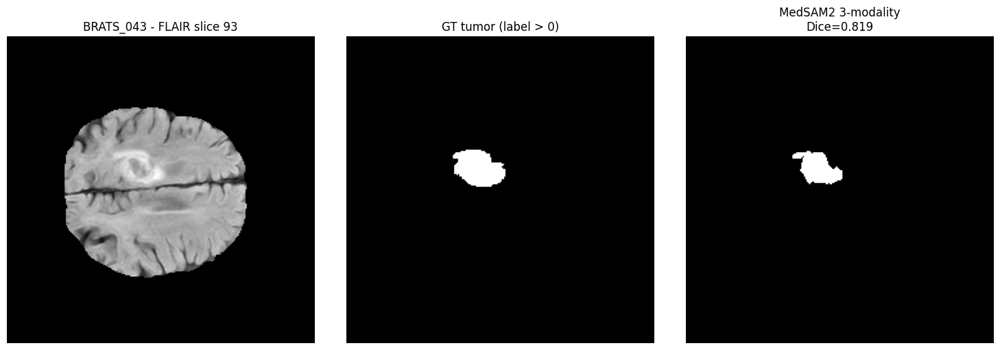

MedSAM2 3-modality on BRATS test set:  31%|███       | 30/97 [05:19<11:40, 10.45s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_043_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_153 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_153.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_153.nii.gz
  -> key_slice_idx: 95
  -> bbox [x_min, y_min, x_max, y_max]: [ 68 104 135 173]



propagate in video: 100%|██████████| 60/60 [00:01<00:00, 36.25it/s]

propagate in video: 100%|██████████| 96/96 [00:02<00:00, 36.12it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.4906


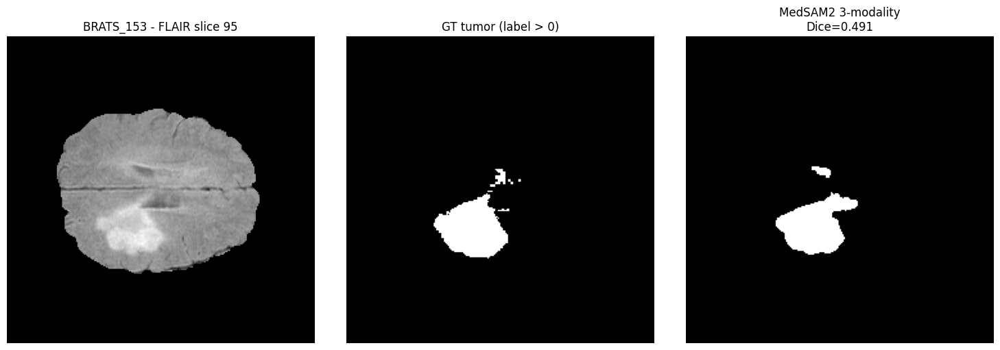

MedSAM2 3-modality on BRATS test set:  32%|███▏      | 31/97 [05:30<11:36, 10.55s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_153_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_308 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_308.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_308.nii.gz
  -> key_slice_idx: 57
  -> bbox [x_min, y_min, x_max, y_max]: [ 54 143 143 187]



propagate in video: 100%|██████████| 98/98 [00:02<00:00, 35.27it/s]

propagate in video: 100%|██████████| 58/58 [00:01<00:00, 36.34it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8640


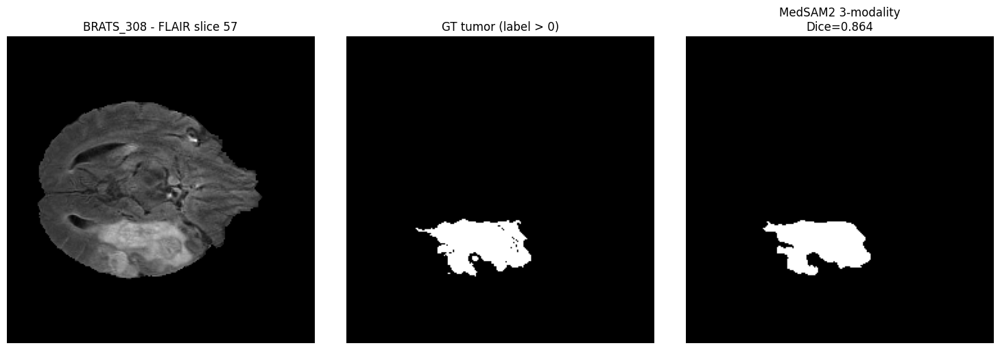

MedSAM2 3-modality on BRATS test set:  33%|███▎      | 32/97 [05:41<11:32, 10.66s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_308_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_266 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_266.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_266.nii.gz
  -> key_slice_idx: 92
  -> bbox [x_min, y_min, x_max, y_max]: [ 96 100 188 177]



propagate in video: 100%|██████████| 63/63 [00:01<00:00, 35.24it/s]

propagate in video: 100%|██████████| 93/93 [00:02<00:00, 36.22it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9204


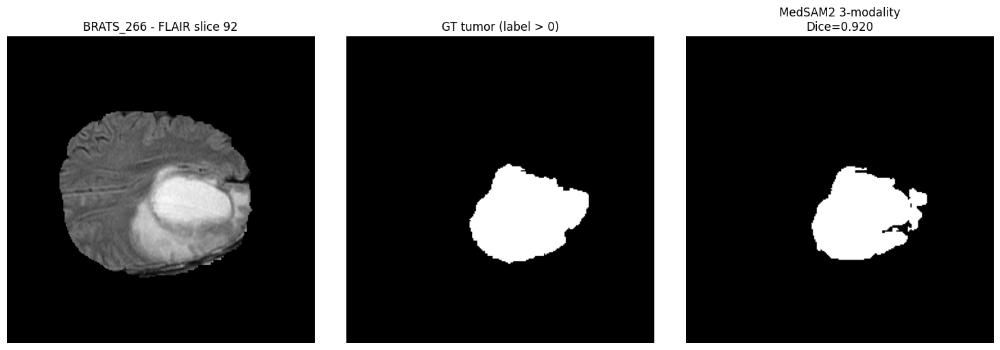

MedSAM2 3-modality on BRATS test set:  34%|███▍      | 33/97 [05:51<11:20, 10.63s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_266_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_360 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_360.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_360.nii.gz
  -> key_slice_idx: 91
  -> bbox [x_min, y_min, x_max, y_max]: [ 93 132 145 184]



propagate in video: 100%|██████████| 64/64 [00:01<00:00, 35.68it/s]

propagate in video: 100%|██████████| 92/92 [00:02<00:00, 36.19it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7167


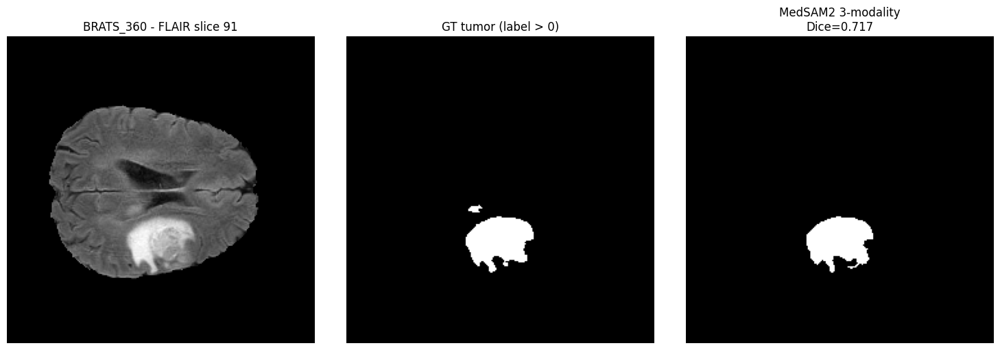

MedSAM2 3-modality on BRATS test set:  35%|███▌      | 34/97 [06:02<11:07, 10.60s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_360_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_009 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_009.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_009.nii.gz
  -> key_slice_idx: 88
  -> bbox [x_min, y_min, x_max, y_max]: [ 88  97 189 174]



propagate in video: 100%|██████████| 67/67 [00:01<00:00, 36.48it/s]

propagate in video: 100%|██████████| 89/89 [00:02<00:00, 33.31it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7698


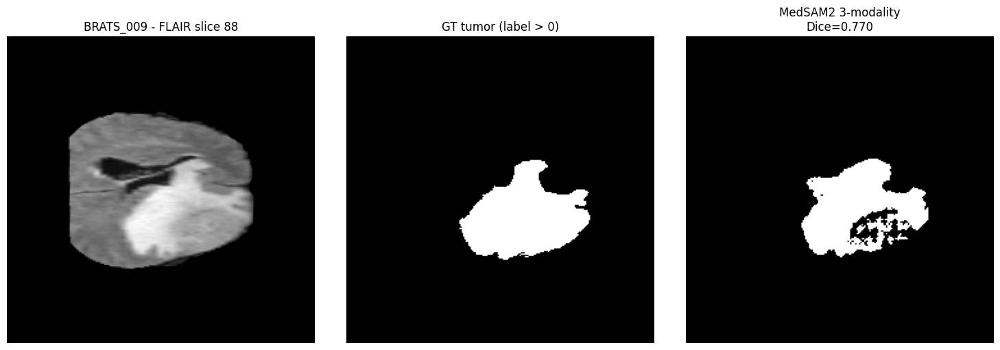

MedSAM2 3-modality on BRATS test set:  36%|███▌      | 35/97 [06:12<11:01, 10.66s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_009_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_483 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_483.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_483.nii.gz
  -> key_slice_idx: 55
  -> bbox [x_min, y_min, x_max, y_max]: [ 77 141 154 185]



propagate in video: 100%|██████████| 100/100 [00:02<00:00, 34.81it/s]

propagate in video: 100%|██████████| 56/56 [00:01<00:00, 35.69it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8143


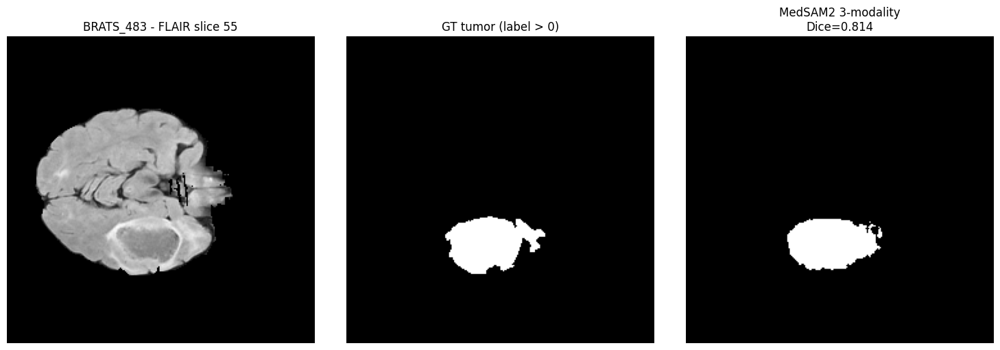

MedSAM2 3-modality on BRATS test set:  37%|███▋      | 36/97 [06:23<10:53, 10.71s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_483_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_389 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_389.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_389.nii.gz
  -> key_slice_idx: 91
  -> bbox [x_min, y_min, x_max, y_max]: [ 83  89 136 117]



propagate in video: 100%|██████████| 64/64 [00:01<00:00, 35.33it/s]

propagate in video: 100%|██████████| 92/92 [00:02<00:00, 36.25it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8082


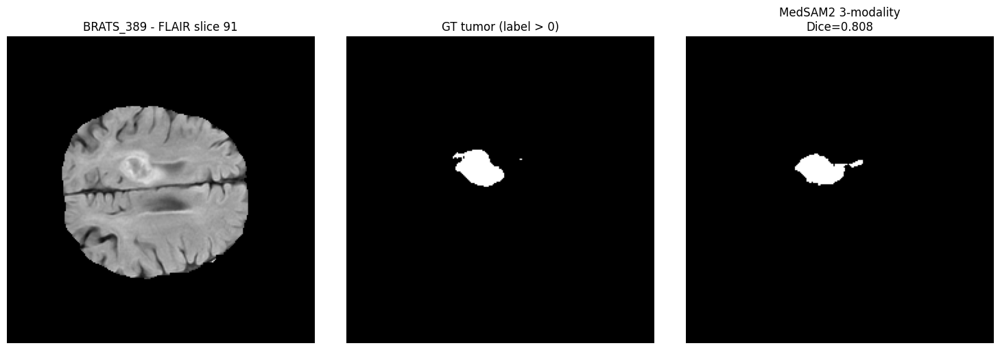

MedSAM2 3-modality on BRATS test set:  38%|███▊      | 37/97 [06:33<10:32, 10.54s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_389_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_129 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_129.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_129.nii.gz
  -> key_slice_idx: 87
  -> bbox [x_min, y_min, x_max, y_max]: [ 85  64 188 146]



propagate in video: 100%|██████████| 68/68 [00:01<00:00, 35.91it/s]

propagate in video: 100%|██████████| 88/88 [00:02<00:00, 35.38it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7796


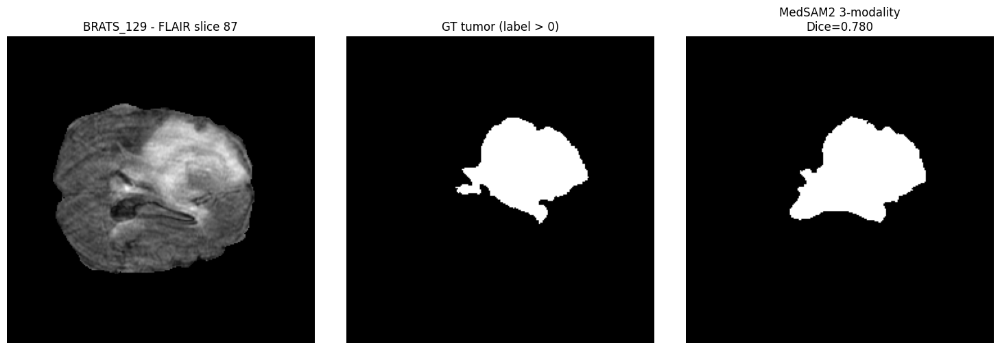

MedSAM2 3-modality on BRATS test set:  39%|███▉      | 38/97 [06:43<10:13, 10.39s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_129_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_369 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_369.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_369.nii.gz
  -> key_slice_idx: 77
  -> bbox [x_min, y_min, x_max, y_max]: [ 95  67 186 134]



propagate in video: 100%|██████████| 78/78 [00:02<00:00, 35.99it/s]

propagate in video: 100%|██████████| 78/78 [00:02<00:00, 36.13it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9340


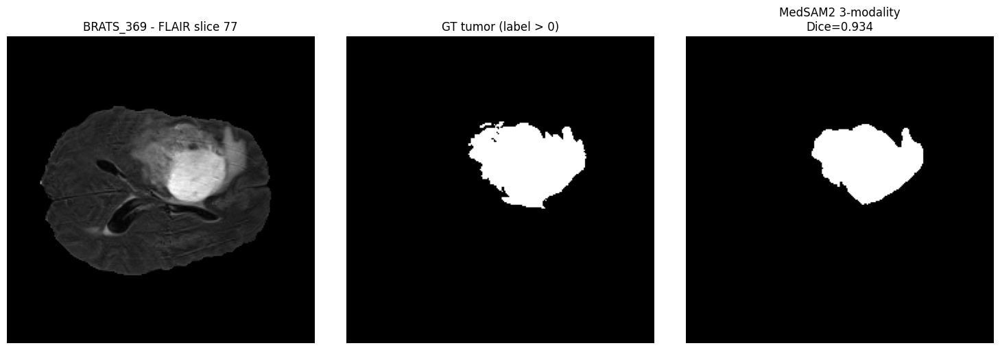

MedSAM2 3-modality on BRATS test set:  40%|████      | 39/97 [06:54<10:08, 10.49s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_369_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_470 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_470.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_470.nii.gz
  -> key_slice_idx: 85
  -> bbox [x_min, y_min, x_max, y_max]: [ 72  82 147 137]



propagate in video: 100%|██████████| 70/70 [00:01<00:00, 36.34it/s]

propagate in video: 100%|██████████| 86/86 [00:02<00:00, 35.57it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8705


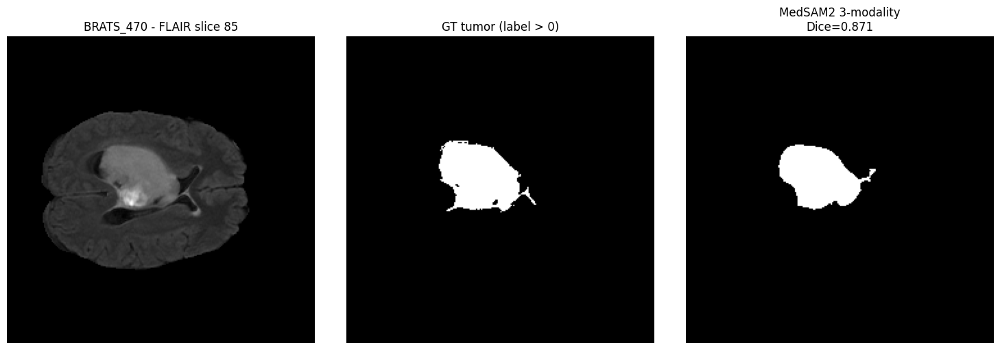

MedSAM2 3-modality on BRATS test set:  41%|████      | 40/97 [07:05<10:00, 10.54s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_470_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_068 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_068.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_068.nii.gz
  -> key_slice_idx: 68
  -> bbox [x_min, y_min, x_max, y_max]: [ 92 151 144 181]



propagate in video: 100%|██████████| 87/87 [00:02<00:00, 35.07it/s]

propagate in video: 100%|██████████| 69/69 [00:01<00:00, 36.62it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.6051


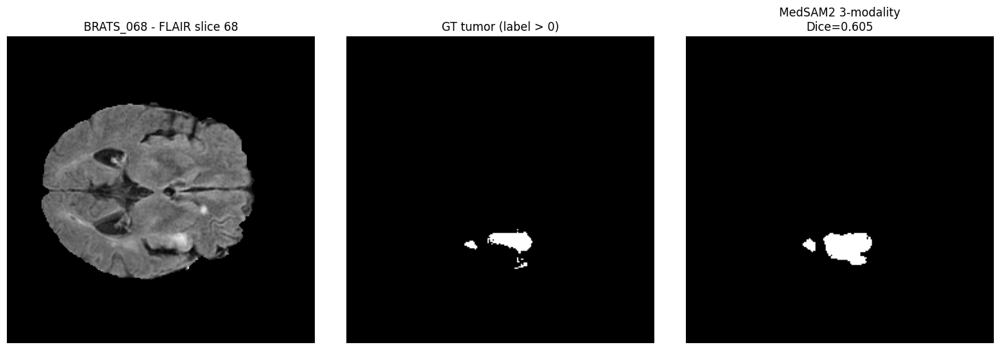

MedSAM2 3-modality on BRATS test set:  42%|████▏     | 41/97 [07:17<10:10, 10.90s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_068_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_409 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_409.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_409.nii.gz
  -> key_slice_idx: 94
  -> bbox [x_min, y_min, x_max, y_max]: [110 109 195 171]



propagate in video: 100%|██████████| 61/61 [00:01<00:00, 36.63it/s]

propagate in video: 100%|██████████| 95/95 [00:02<00:00, 36.67it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9267


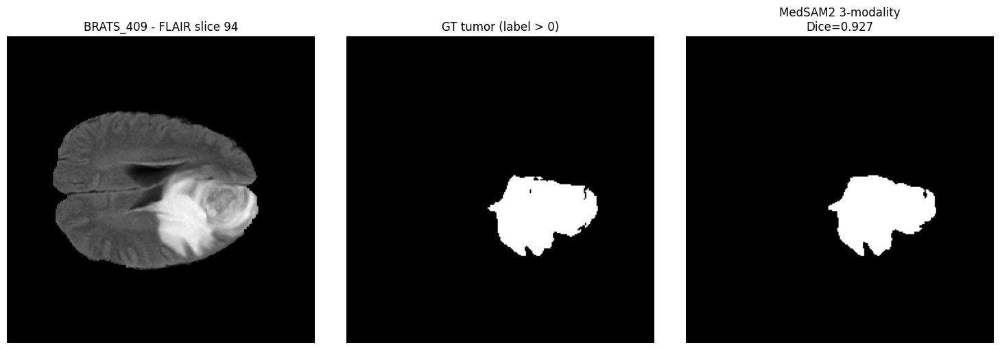

MedSAM2 3-modality on BRATS test set:  43%|████▎     | 42/97 [07:27<09:46, 10.66s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_409_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_194 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_194.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_194.nii.gz
  -> key_slice_idx: 97
  -> bbox [x_min, y_min, x_max, y_max]: [114  72 186 119]



propagate in video: 100%|██████████| 58/58 [00:01<00:00, 36.23it/s]

propagate in video: 100%|██████████| 98/98 [00:02<00:00, 37.21it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7512


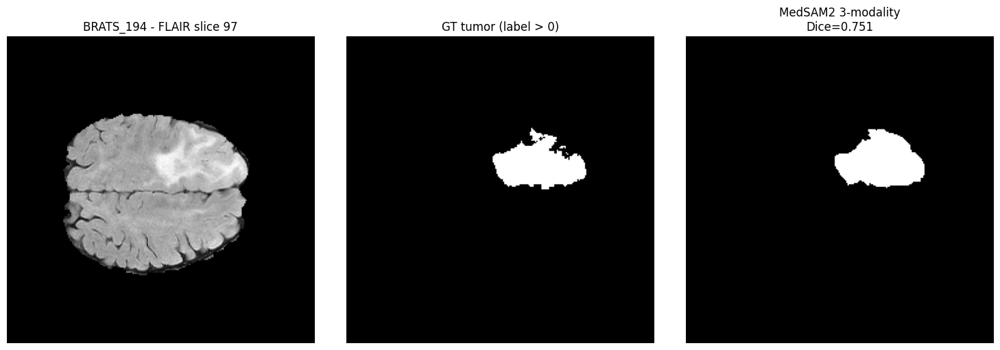

MedSAM2 3-modality on BRATS test set:  44%|████▍     | 43/97 [07:37<09:23, 10.44s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_194_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_228 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_228.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_228.nii.gz
  -> key_slice_idx: 84
  -> bbox [x_min, y_min, x_max, y_max]: [111  70 168 136]



propagate in video: 100%|██████████| 71/71 [00:02<00:00, 34.80it/s]

propagate in video: 100%|██████████| 85/85 [00:02<00:00, 35.55it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7345


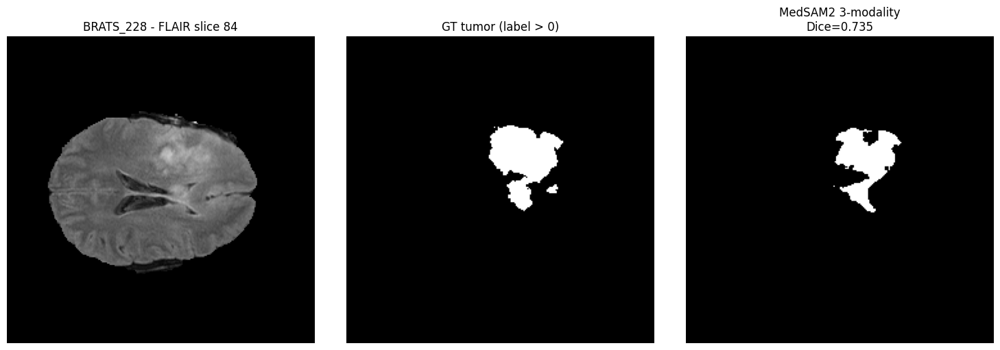

MedSAM2 3-modality on BRATS test set:  45%|████▌     | 44/97 [07:47<09:09, 10.38s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_228_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_425 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_425.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_425.nii.gz
  -> key_slice_idx: 82
  -> bbox [x_min, y_min, x_max, y_max]: [ 30  76  93 139]



propagate in video: 100%|██████████| 73/73 [00:01<00:00, 36.77it/s]

propagate in video: 100%|██████████| 83/83 [00:02<00:00, 36.16it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9195


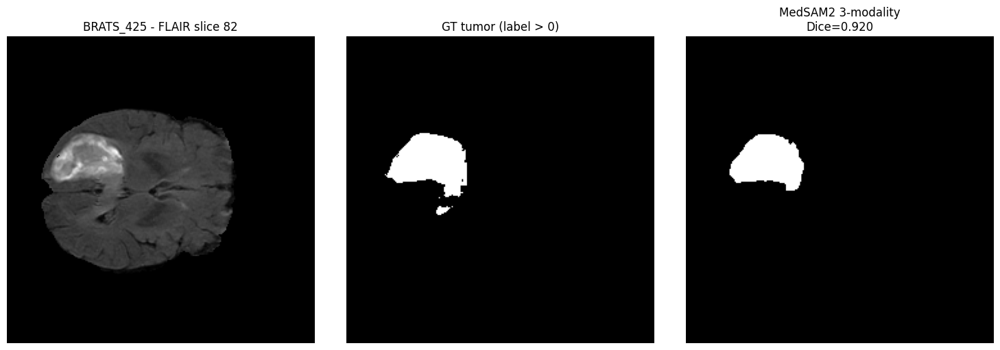

MedSAM2 3-modality on BRATS test set:  46%|████▋     | 45/97 [07:57<09:00, 10.40s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_425_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_344 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_344.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_344.nii.gz
  -> key_slice_idx: 71
  -> bbox [x_min, y_min, x_max, y_max]: [ 53 136 109 188]



propagate in video: 100%|██████████| 84/84 [00:02<00:00, 36.27it/s]

propagate in video: 100%|██████████| 72/72 [00:01<00:00, 37.24it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8841


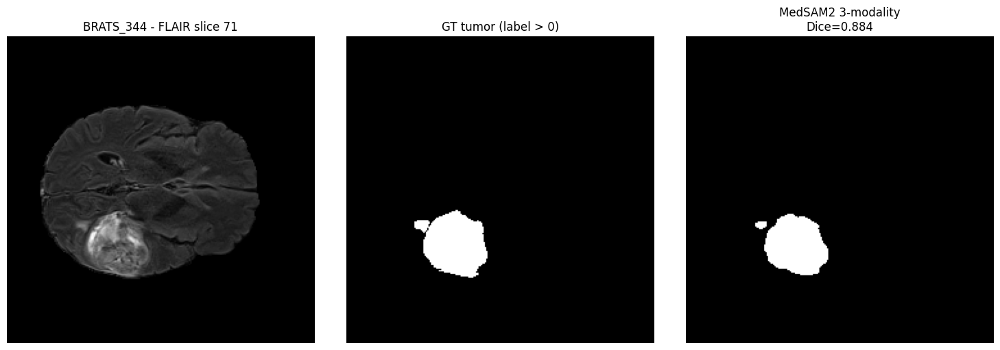

MedSAM2 3-modality on BRATS test set:  47%|████▋     | 46/97 [08:08<08:52, 10.44s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_344_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_156 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_156.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_156.nii.gz
  -> key_slice_idx: 77
  -> bbox [x_min, y_min, x_max, y_max]: [ 30  68 170 149]



propagate in video: 100%|██████████| 78/78 [00:02<00:00, 35.33it/s]

propagate in video: 100%|██████████| 78/78 [00:02<00:00, 36.76it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8095


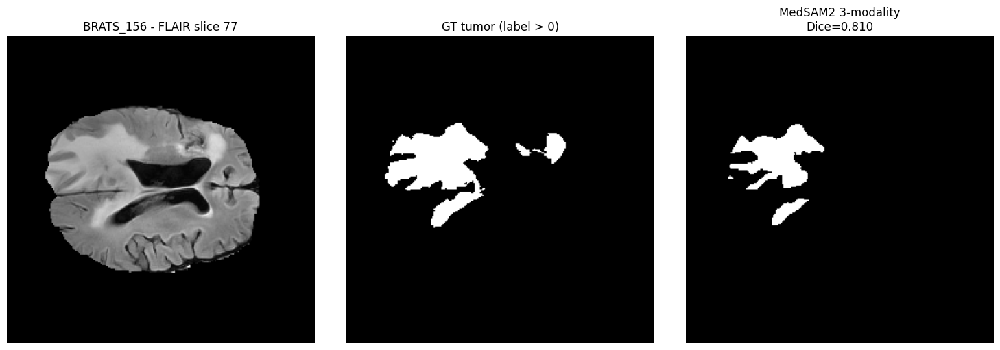

MedSAM2 3-modality on BRATS test set:  48%|████▊     | 47/97 [08:18<08:39, 10.39s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_156_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_233 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_233.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_233.nii.gz
  -> key_slice_idx: 65
  -> bbox [x_min, y_min, x_max, y_max]: [118  65 142  92]



propagate in video: 100%|██████████| 90/90 [00:02<00:00, 36.40it/s]

propagate in video: 100%|██████████| 66/66 [00:01<00:00, 35.76it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8167


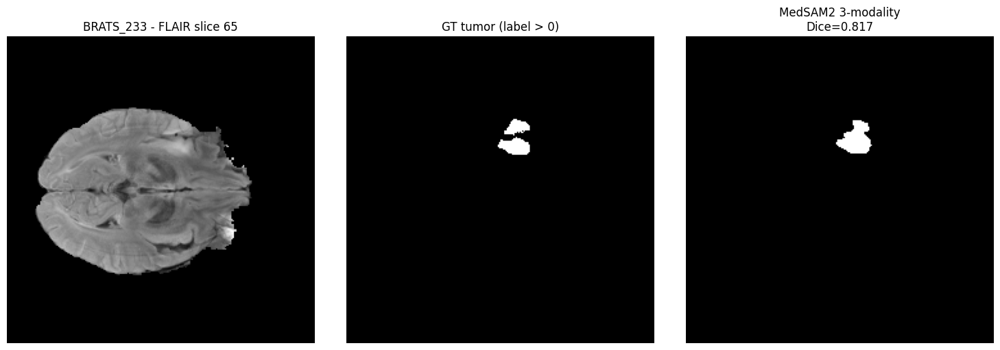

MedSAM2 3-modality on BRATS test set:  49%|████▉     | 48/97 [08:29<08:35, 10.51s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_233_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_356 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_356.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_356.nii.gz
  -> key_slice_idx: 101
  -> bbox [x_min, y_min, x_max, y_max]: [ 91  96 175 174]



propagate in video: 100%|██████████| 54/54 [00:01<00:00, 36.42it/s]

propagate in video: 100%|██████████| 102/102 [00:02<00:00, 36.13it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.6757


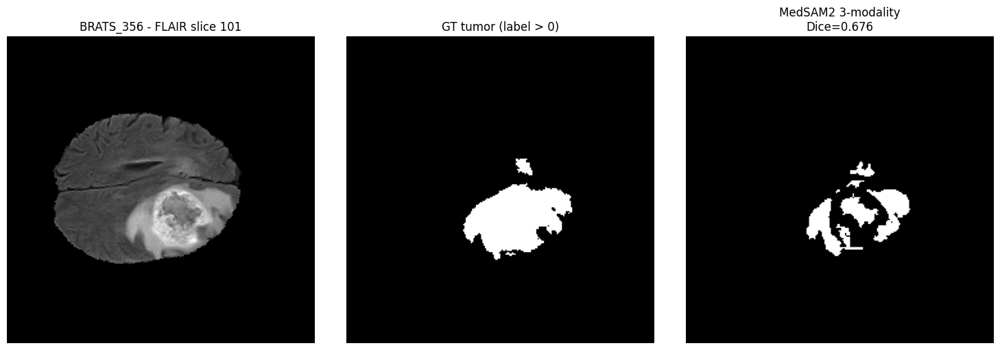

MedSAM2 3-modality on BRATS test set:  51%|█████     | 49/97 [08:41<08:41, 10.86s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_356_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_413 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_413.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_413.nii.gz
  -> key_slice_idx: 86
  -> bbox [x_min, y_min, x_max, y_max]: [ 56  58  99 105]



propagate in video: 100%|██████████| 69/69 [00:01<00:00, 35.78it/s]

propagate in video: 100%|██████████| 87/87 [00:02<00:00, 36.80it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8166


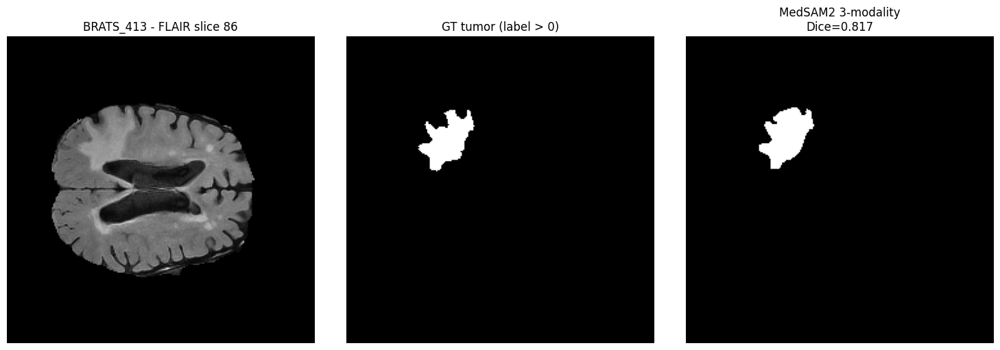

MedSAM2 3-modality on BRATS test set:  52%|█████▏    | 50/97 [08:52<08:31, 10.89s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_413_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_175 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_175.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_175.nii.gz
  -> key_slice_idx: 52
  -> bbox [x_min, y_min, x_max, y_max]: [102 162 142 176]



propagate in video: 100%|██████████| 103/103 [00:02<00:00, 36.23it/s]

propagate in video: 100%|██████████| 53/53 [00:01<00:00, 36.93it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7392


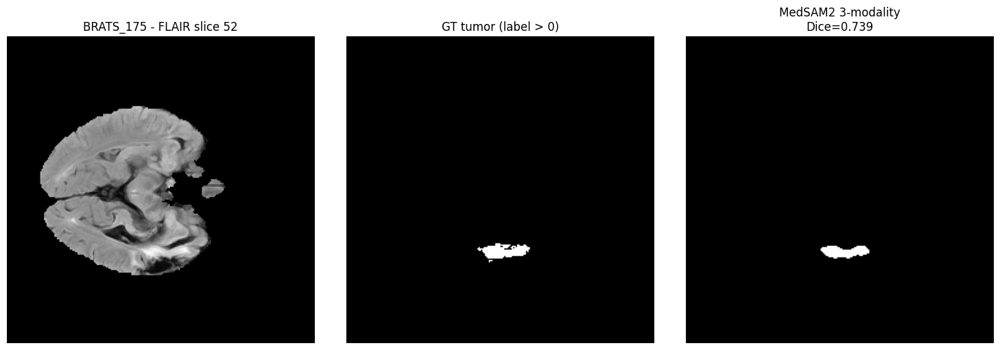

MedSAM2 3-modality on BRATS test set:  53%|█████▎    | 51/97 [09:01<08:06, 10.58s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_175_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_074 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_074.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_074.nii.gz
  -> key_slice_idx: 77
  -> bbox [x_min, y_min, x_max, y_max]: [ 62 118 173 178]



propagate in video: 100%|██████████| 78/78 [00:02<00:00, 34.78it/s]

propagate in video: 100%|██████████| 78/78 [00:02<00:00, 35.22it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8063


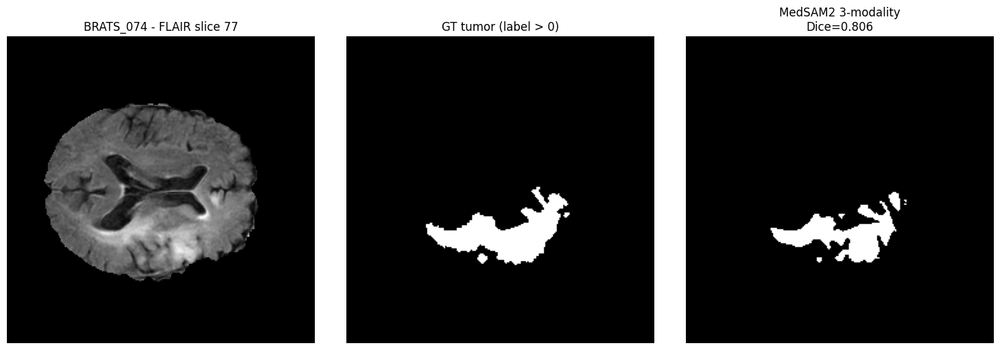

MedSAM2 3-modality on BRATS test set:  54%|█████▎    | 52/97 [09:12<07:55, 10.56s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_074_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_387 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_387.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_387.nii.gz
  -> key_slice_idx: 76
  -> bbox [x_min, y_min, x_max, y_max]: [ 37 105 133 173]



propagate in video: 100%|██████████| 79/79 [00:02<00:00, 35.96it/s]

propagate in video: 100%|██████████| 77/77 [00:02<00:00, 35.49it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8665


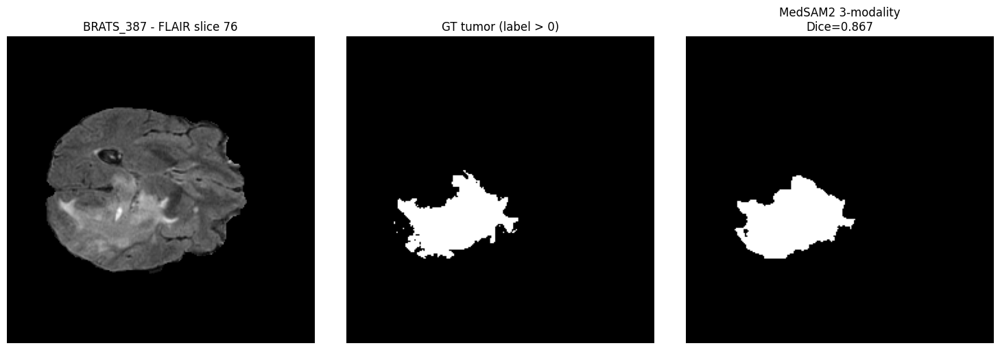

MedSAM2 3-modality on BRATS test set:  55%|█████▍    | 53/97 [09:22<07:41, 10.49s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_387_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_017 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_017.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_017.nii.gz
  -> key_slice_idx: 68
  -> bbox [x_min, y_min, x_max, y_max]: [ 64 137 147 185]



propagate in video: 100%|██████████| 87/87 [00:02<00:00, 36.65it/s]

propagate in video: 100%|██████████| 69/69 [00:01<00:00, 35.99it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8630


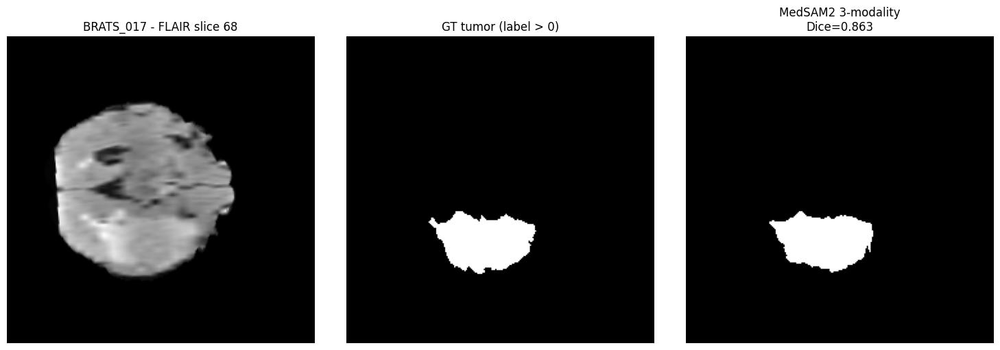

MedSAM2 3-modality on BRATS test set:  56%|█████▌    | 54/97 [09:32<07:19, 10.22s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_017_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_263 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_263.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_263.nii.gz
  -> key_slice_idx: 64
  -> bbox [x_min, y_min, x_max, y_max]: [ 61  55 148 122]



propagate in video: 100%|██████████| 91/91 [00:02<00:00, 36.47it/s]

propagate in video: 100%|██████████| 65/65 [00:01<00:00, 37.22it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8795


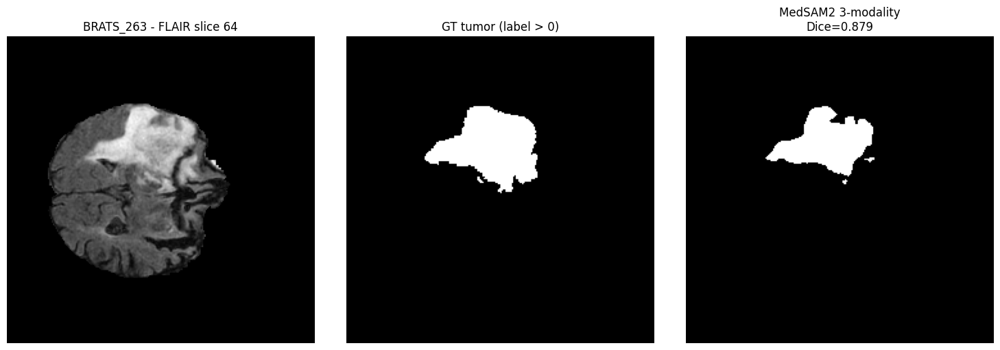

MedSAM2 3-modality on BRATS test set:  57%|█████▋    | 55/97 [09:44<07:31, 10.76s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_263_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_183 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_183.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_183.nii.gz
  -> key_slice_idx: 105
  -> bbox [x_min, y_min, x_max, y_max]: [126 131 157 155]



propagate in video: 100%|██████████| 50/50 [00:01<00:00, 36.70it/s]

propagate in video: 100%|██████████| 106/106 [00:03<00:00, 35.25it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.6620


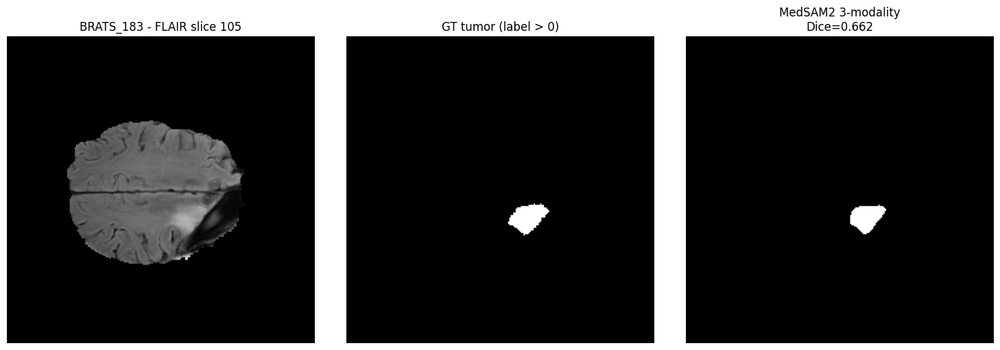

MedSAM2 3-modality on BRATS test set:  58%|█████▊    | 56/97 [09:55<07:26, 10.89s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_183_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_327 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_327.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_327.nii.gz
  -> key_slice_idx: 100
  -> bbox [x_min, y_min, x_max, y_max]: [ 83 125 158 182]



propagate in video: 100%|██████████| 55/55 [00:01<00:00, 35.60it/s]

propagate in video: 100%|██████████| 101/101 [00:02<00:00, 35.63it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8795


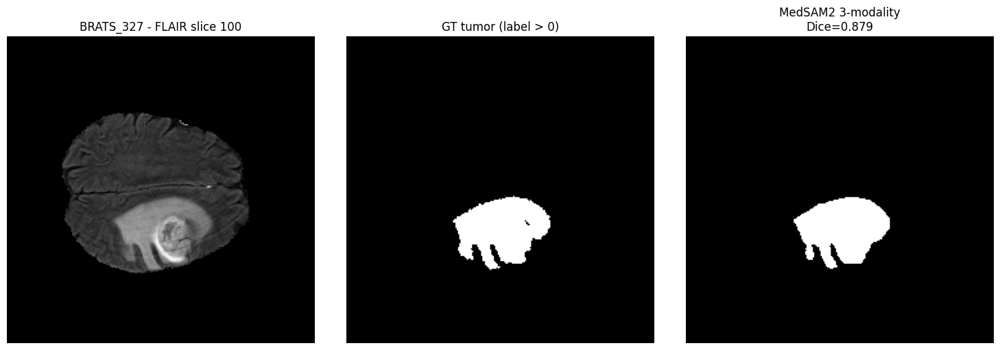

MedSAM2 3-modality on BRATS test set:  59%|█████▉    | 57/97 [10:06<07:14, 10.86s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_327_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_465 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_465.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_465.nii.gz
  -> key_slice_idx: 86
  -> bbox [x_min, y_min, x_max, y_max]: [127 101 191 170]



propagate in video: 100%|██████████| 69/69 [00:01<00:00, 36.45it/s]

propagate in video: 100%|██████████| 87/87 [00:02<00:00, 36.51it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9079


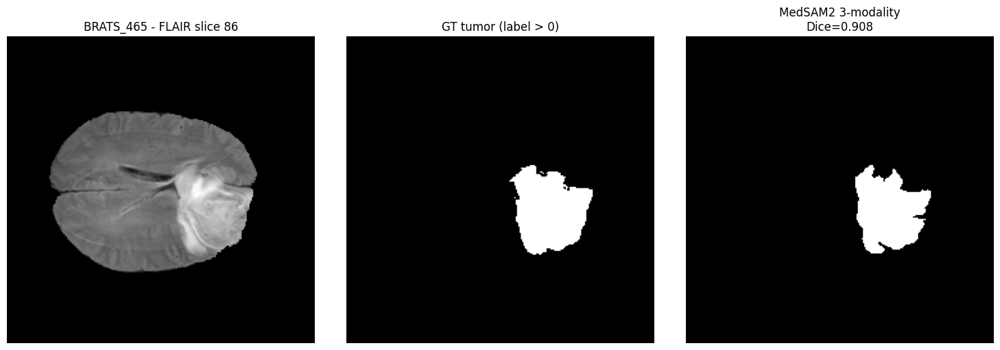

MedSAM2 3-modality on BRATS test set:  60%|█████▉    | 58/97 [10:16<07:00, 10.79s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_465_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_181 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_181.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_181.nii.gz
  -> key_slice_idx: 93
  -> bbox [x_min, y_min, x_max, y_max]: [ 71 111 181 182]



propagate in video: 100%|██████████| 62/62 [00:01<00:00, 36.47it/s]

propagate in video: 100%|██████████| 94/94 [00:02<00:00, 37.31it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8050


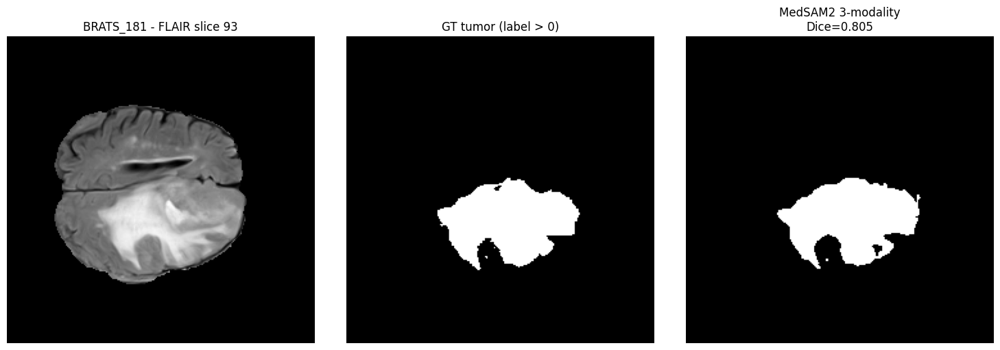

MedSAM2 3-modality on BRATS test set:  61%|██████    | 59/97 [10:28<07:00, 11.07s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_181_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_178 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_178.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_178.nii.gz
  -> key_slice_idx: 66
  -> bbox [x_min, y_min, x_max, y_max]: [ 66 152 149 180]



propagate in video: 100%|██████████| 89/89 [00:02<00:00, 35.60it/s]

propagate in video: 100%|██████████| 67/67 [00:01<00:00, 36.41it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.3130


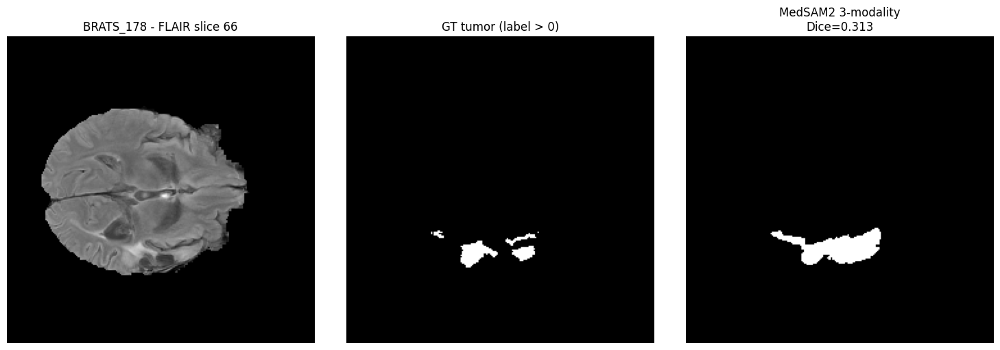

MedSAM2 3-modality on BRATS test set:  62%|██████▏   | 60/97 [10:37<06:28, 10.50s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_178_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_042 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_042.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_042.nii.gz
  -> key_slice_idx: 94
  -> bbox [x_min, y_min, x_max, y_max]: [107 134 134 138]



propagate in video: 100%|██████████| 61/61 [00:01<00:00, 36.75it/s]

propagate in video: 100%|██████████| 95/95 [00:02<00:00, 35.59it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.5648


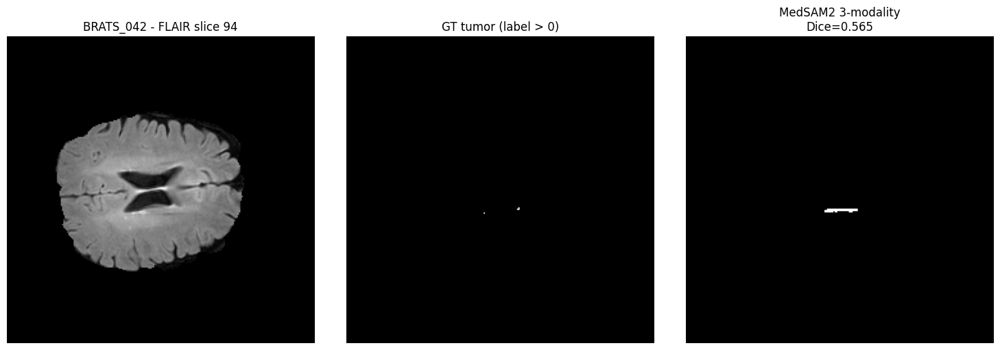

MedSAM2 3-modality on BRATS test set:  63%|██████▎   | 61/97 [10:48<06:20, 10.56s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_042_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_065 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_065.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_065.nii.gz
  -> key_slice_idx: 78
  -> bbox [x_min, y_min, x_max, y_max]: [104 123 170 178]



propagate in video: 100%|██████████| 77/77 [00:02<00:00, 37.31it/s]

propagate in video: 100%|██████████| 79/79 [00:02<00:00, 35.84it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8450


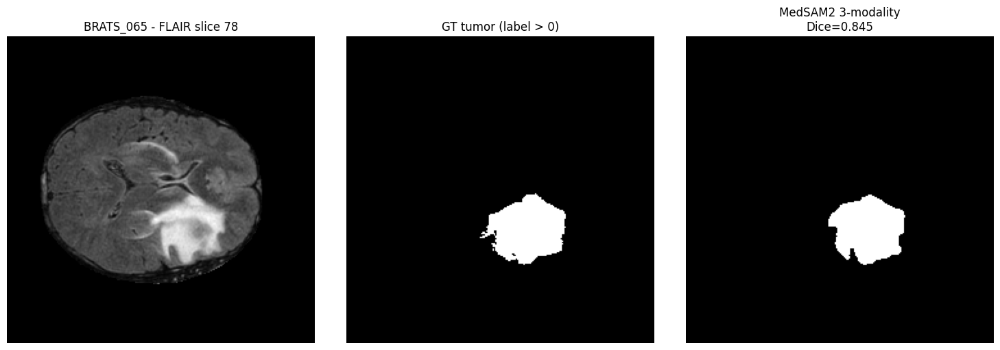

MedSAM2 3-modality on BRATS test set:  64%|██████▍   | 62/97 [10:59<06:12, 10.66s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_065_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_380 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_380.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_380.nii.gz
  -> key_slice_idx: 47
  -> bbox [x_min, y_min, x_max, y_max]: [ 85 160 143 188]



propagate in video: 100%|██████████| 108/108 [00:03<00:00, 33.98it/s]

propagate in video: 100%|██████████| 48/48 [00:01<00:00, 35.64it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7504


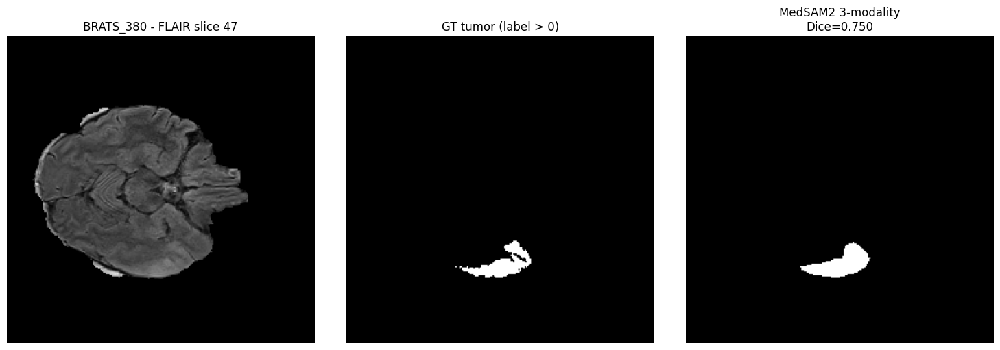

MedSAM2 3-modality on BRATS test set:  65%|██████▍   | 63/97 [11:10<06:06, 10.78s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_380_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_079 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_079.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_079.nii.gz
  -> key_slice_idx: 63
  -> bbox [x_min, y_min, x_max, y_max]: [ 70  59 146 106]



propagate in video: 100%|██████████| 92/92 [00:02<00:00, 36.58it/s]

propagate in video: 100%|██████████| 64/64 [00:01<00:00, 35.61it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7295


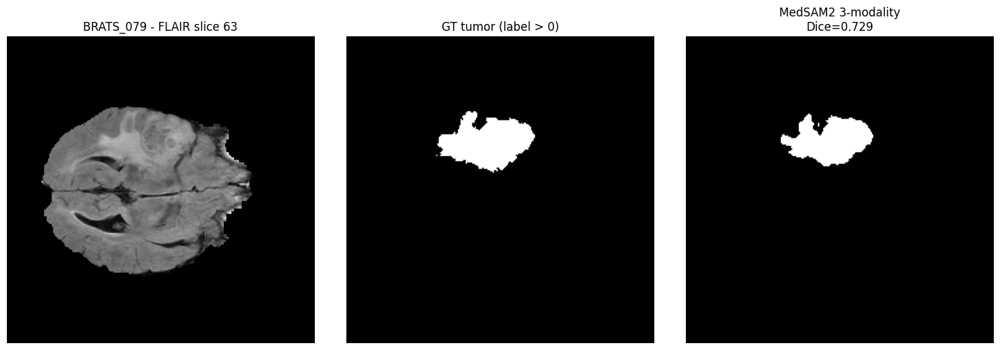

MedSAM2 3-modality on BRATS test set:  66%|██████▌   | 64/97 [11:20<05:49, 10.60s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_079_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_473 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_473.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_473.nii.gz
  -> key_slice_idx: 68
  -> bbox [x_min, y_min, x_max, y_max]: [ 93 136 140 173]



propagate in video: 100%|██████████| 87/87 [00:02<00:00, 36.43it/s]

propagate in video: 100%|██████████| 69/69 [00:01<00:00, 37.65it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7611


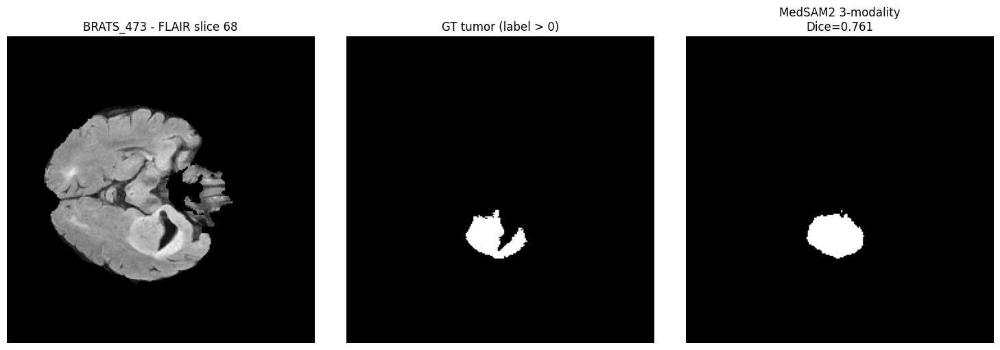

MedSAM2 3-modality on BRATS test set:  67%|██████▋   | 65/97 [11:31<05:37, 10.54s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_473_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_401 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_401.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_401.nii.gz
  -> key_slice_idx: 58
  -> bbox [x_min, y_min, x_max, y_max]: [110 137 152 177]



propagate in video: 100%|██████████| 97/97 [00:02<00:00, 36.56it/s]

propagate in video: 100%|██████████| 59/59 [00:01<00:00, 37.25it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9120


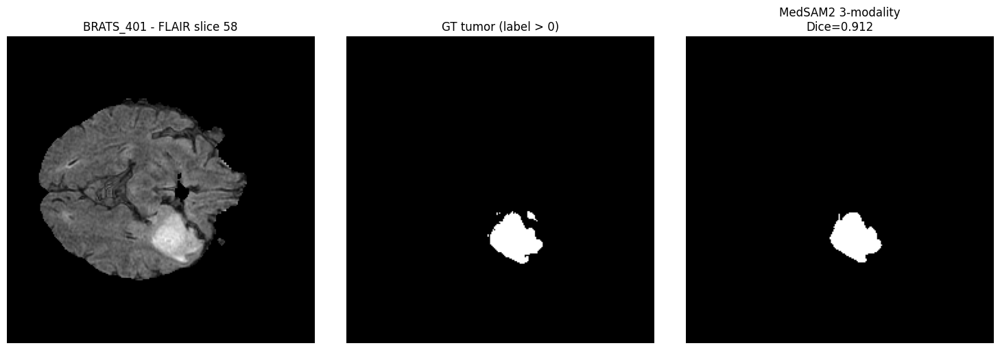

MedSAM2 3-modality on BRATS test set:  68%|██████▊   | 66/97 [11:40<05:20, 10.34s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_401_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_475 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_475.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_475.nii.gz
  -> key_slice_idx: 94
  -> bbox [x_min, y_min, x_max, y_max]: [ 96  99 188 175]



propagate in video: 100%|██████████| 61/61 [00:01<00:00, 34.97it/s]

propagate in video: 100%|██████████| 95/95 [00:02<00:00, 36.42it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9056


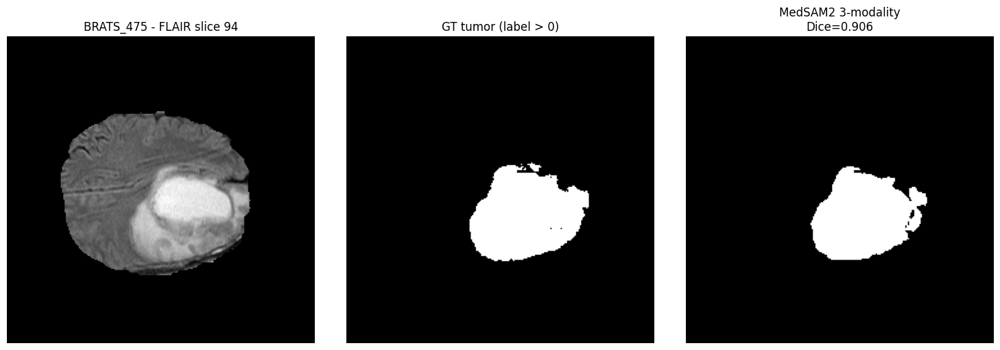

MedSAM2 3-modality on BRATS test set:  69%|██████▉   | 67/97 [11:51<05:15, 10.52s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_475_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_094 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_094.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_094.nii.gz
  -> key_slice_idx: 73
  -> bbox [x_min, y_min, x_max, y_max]: [ 52 129 141 187]



propagate in video: 100%|██████████| 82/82 [00:02<00:00, 35.82it/s]

propagate in video: 100%|██████████| 74/74 [00:02<00:00, 36.81it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9020


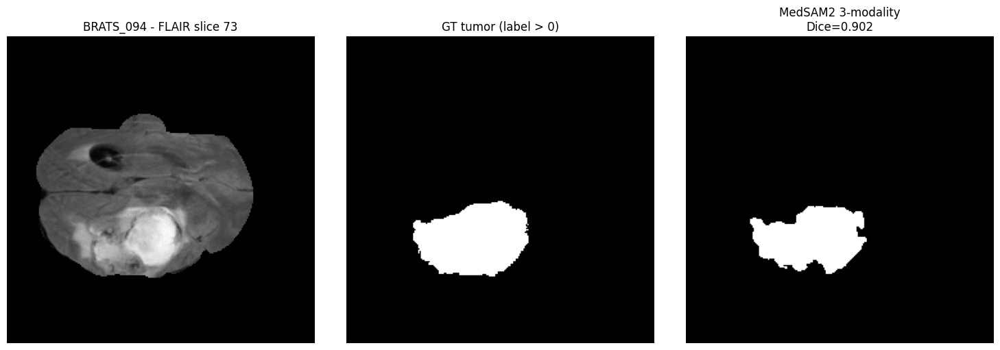

MedSAM2 3-modality on BRATS test set:  70%|███████   | 68/97 [12:02<05:05, 10.52s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_094_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_063 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_063.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_063.nii.gz
  -> key_slice_idx: 66
  -> bbox [x_min, y_min, x_max, y_max]: [ 70  62 151 119]



propagate in video: 100%|██████████| 89/89 [00:02<00:00, 37.07it/s]

propagate in video: 100%|██████████| 67/67 [00:01<00:00, 36.58it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8888


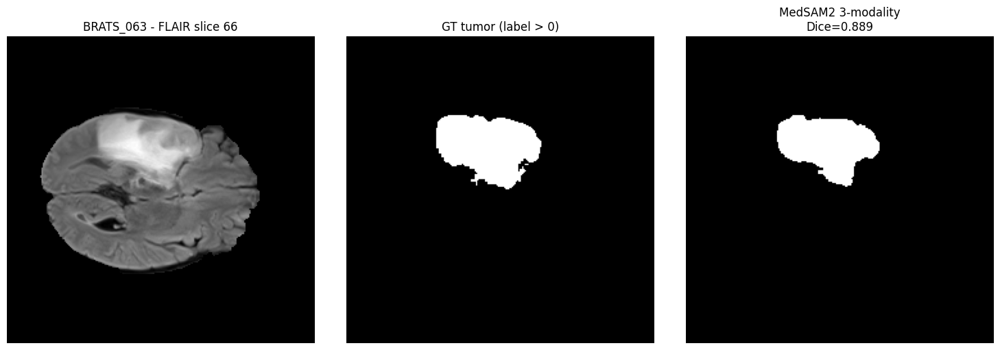

MedSAM2 3-modality on BRATS test set:  71%|███████   | 69/97 [12:12<04:52, 10.44s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_063_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_083 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_083.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_083.nii.gz
  -> key_slice_idx: 88
  -> bbox [x_min, y_min, x_max, y_max]: [110 116 172 165]



propagate in video: 100%|██████████| 67/67 [00:01<00:00, 36.49it/s]

propagate in video: 100%|██████████| 89/89 [00:02<00:00, 35.97it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8840


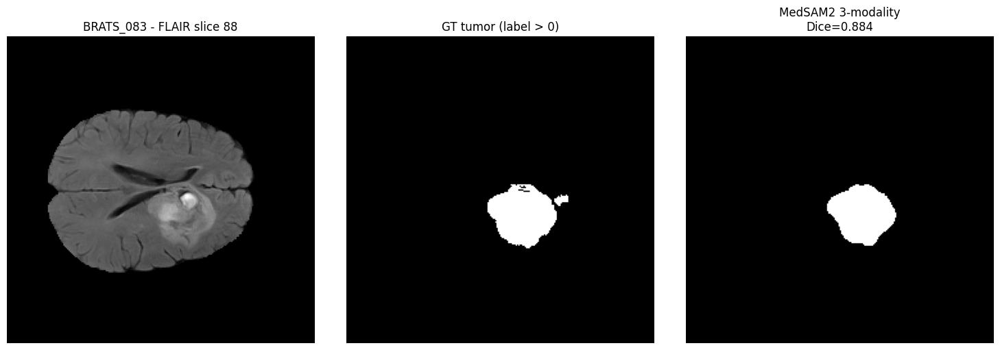

MedSAM2 3-modality on BRATS test set:  72%|███████▏  | 70/97 [12:23<04:43, 10.50s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_083_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_225 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_225.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_225.nii.gz
  -> key_slice_idx: 86
  -> bbox [x_min, y_min, x_max, y_max]: [ 42 126 129 179]



propagate in video: 100%|██████████| 69/69 [00:01<00:00, 36.50it/s]

propagate in video: 100%|██████████| 87/87 [00:02<00:00, 35.92it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8821


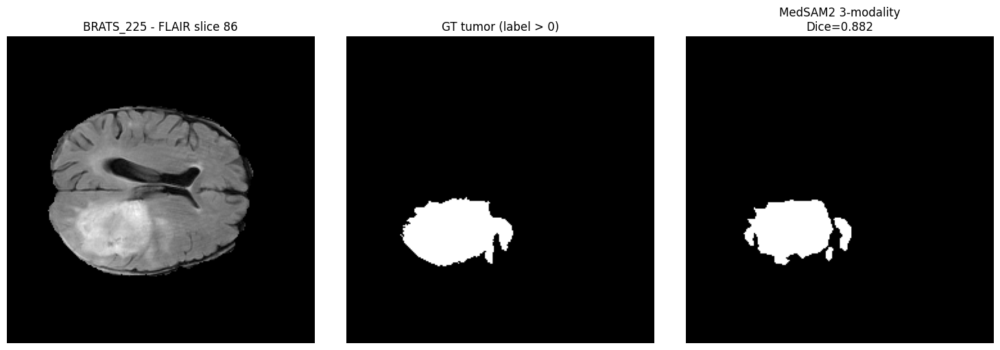

MedSAM2 3-modality on BRATS test set:  73%|███████▎  | 71/97 [12:34<04:40, 10.78s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_225_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_319 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_319.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_319.nii.gz
  -> key_slice_idx: 104
  -> bbox [x_min, y_min, x_max, y_max]: [ 80  72 145 163]



propagate in video: 100%|██████████| 51/51 [00:01<00:00, 36.36it/s]

propagate in video: 100%|██████████| 105/105 [00:02<00:00, 36.44it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8778


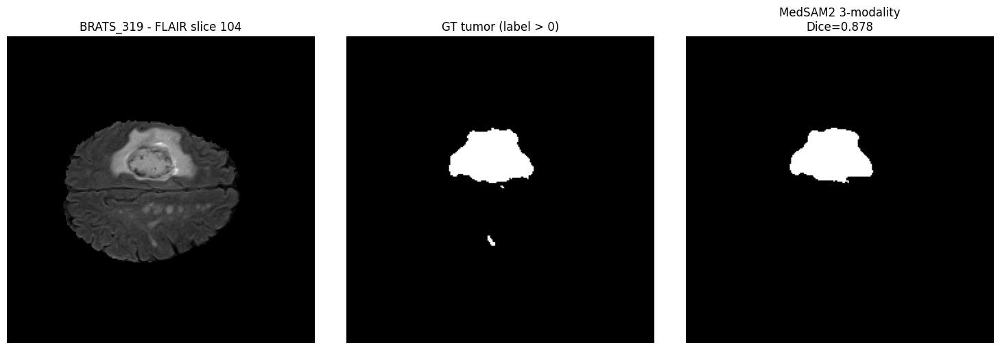

MedSAM2 3-modality on BRATS test set:  74%|███████▍  | 72/97 [12:45<04:28, 10.74s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_319_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_026 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_026.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_026.nii.gz
  -> key_slice_idx: 81
  -> bbox [x_min, y_min, x_max, y_max]: [ 88  69 145 108]



propagate in video: 100%|██████████| 74/74 [00:02<00:00, 36.17it/s]

propagate in video: 100%|██████████| 82/82 [00:02<00:00, 36.27it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9477


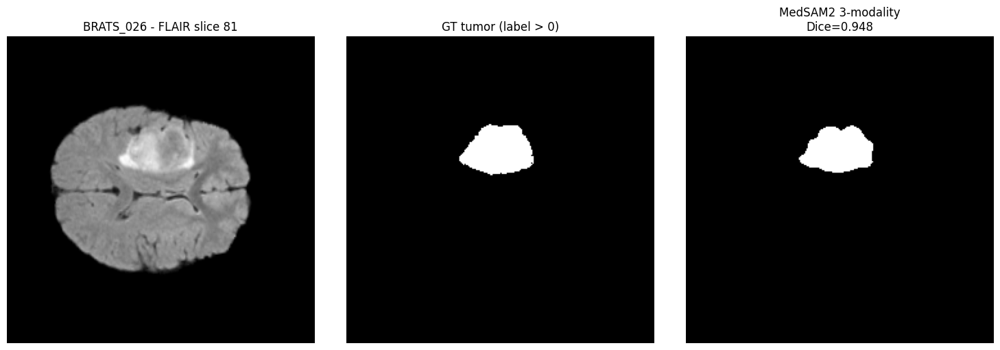

MedSAM2 3-modality on BRATS test set:  75%|███████▌  | 73/97 [12:55<04:14, 10.62s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_026_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_106 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_106.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_106.nii.gz
  -> key_slice_idx: 73
  -> bbox [x_min, y_min, x_max, y_max]: [ 56 106 194 165]



propagate in video: 100%|██████████| 82/82 [00:02<00:00, 36.48it/s]

propagate in video: 100%|██████████| 74/74 [00:02<00:00, 36.89it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.5770


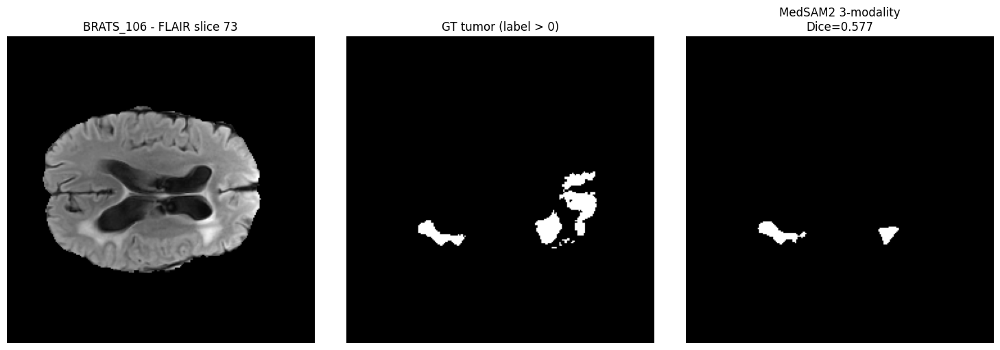

MedSAM2 3-modality on BRATS test set:  76%|███████▋  | 74/97 [13:05<04:00, 10.47s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_106_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_151 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_151.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_151.nii.gz
  -> key_slice_idx: 87
  -> bbox [x_min, y_min, x_max, y_max]: [ 60  60 168 135]



propagate in video: 100%|██████████| 68/68 [00:01<00:00, 35.65it/s]

propagate in video: 100%|██████████| 88/88 [00:02<00:00, 36.68it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.6800


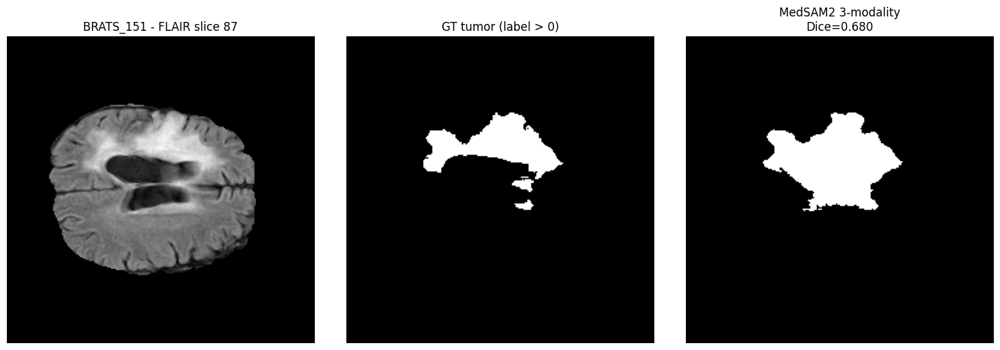

MedSAM2 3-modality on BRATS test set:  77%|███████▋  | 75/97 [13:16<03:52, 10.55s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_151_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_333 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_333.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_333.nii.gz
  -> key_slice_idx: 83
  -> bbox [x_min, y_min, x_max, y_max]: [ 65  64 111 113]



propagate in video: 100%|██████████| 72/72 [00:01<00:00, 36.38it/s]

propagate in video: 100%|██████████| 84/84 [00:02<00:00, 36.09it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9195


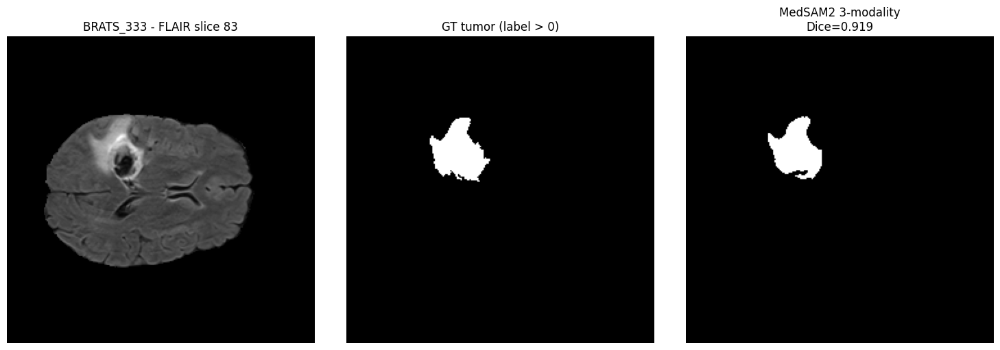

MedSAM2 3-modality on BRATS test set:  78%|███████▊  | 76/97 [13:26<03:39, 10.45s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_333_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_390 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_390.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_390.nii.gz
  -> key_slice_idx: 100
  -> bbox [x_min, y_min, x_max, y_max]: [ 77 137 119 171]



propagate in video: 100%|██████████| 55/55 [00:01<00:00, 36.81it/s]

propagate in video: 100%|██████████| 101/101 [00:02<00:00, 36.15it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8814


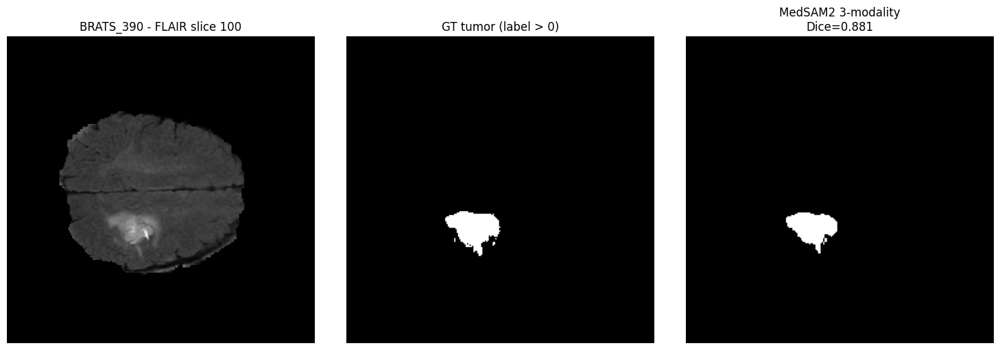

MedSAM2 3-modality on BRATS test set:  79%|███████▉  | 77/97 [13:37<03:29, 10.47s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_390_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_160 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_160.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_160.nii.gz
  -> key_slice_idx: 62
  -> bbox [x_min, y_min, x_max, y_max]: [ 98 154 147 186]



propagate in video: 100%|██████████| 93/93 [00:02<00:00, 37.10it/s]

propagate in video: 100%|██████████| 63/63 [00:01<00:00, 36.56it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7047


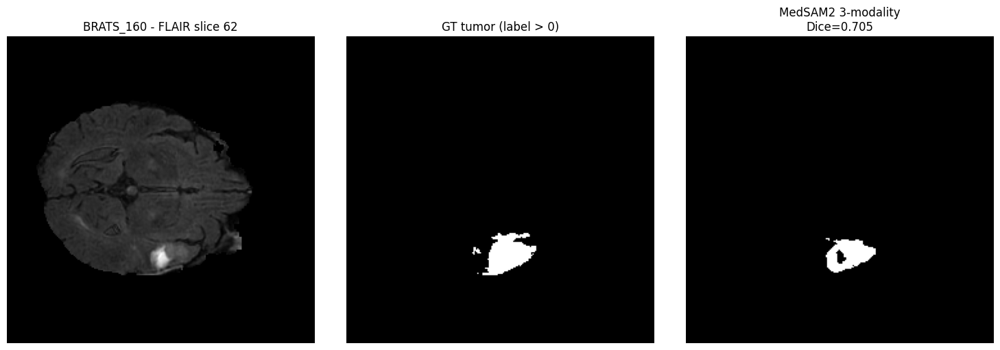

MedSAM2 3-modality on BRATS test set:  80%|████████  | 78/97 [13:47<03:19, 10.47s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_160_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_347 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_347.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_347.nii.gz
  -> key_slice_idx: 86
  -> bbox [x_min, y_min, x_max, y_max]: [ 49 129 124 186]



propagate in video: 100%|██████████| 69/69 [00:01<00:00, 36.97it/s]

propagate in video: 100%|██████████| 87/87 [00:02<00:00, 36.82it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9287


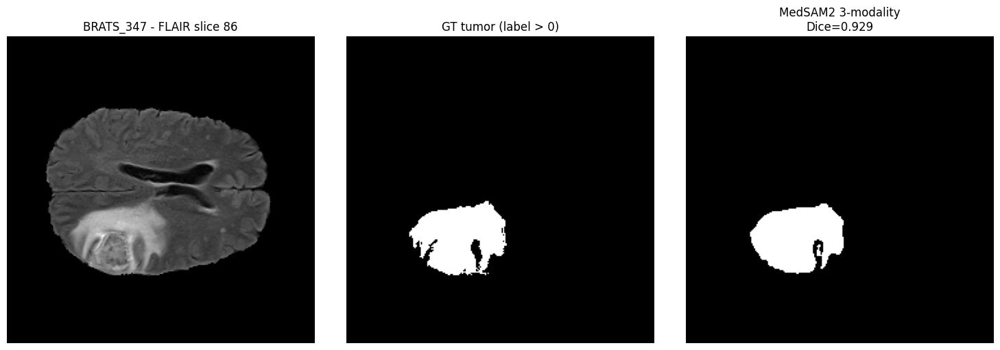

MedSAM2 3-modality on BRATS test set:  81%|████████▏ | 79/97 [13:58<03:08, 10.46s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_347_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_141 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_141.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_141.nii.gz
  -> key_slice_idx: 79
  -> bbox [x_min, y_min, x_max, y_max]: [ 36 109 162 178]



propagate in video: 100%|██████████| 76/76 [00:02<00:00, 37.04it/s]

propagate in video: 100%|██████████| 80/80 [00:02<00:00, 36.75it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.6456


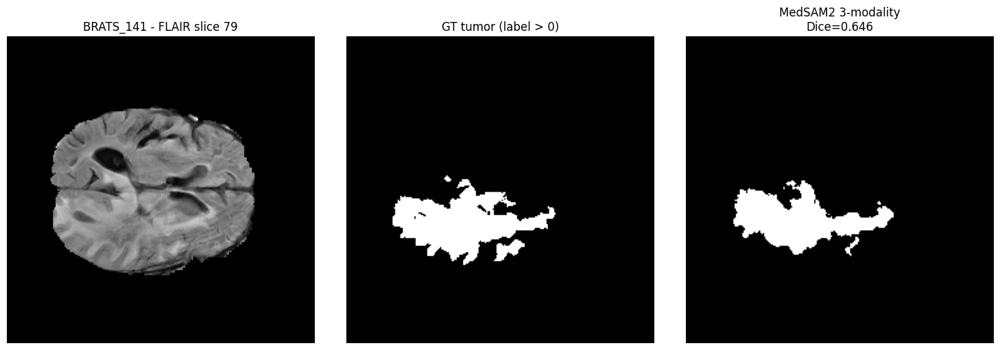

MedSAM2 3-modality on BRATS test set:  82%|████████▏ | 80/97 [14:08<02:56, 10.36s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_141_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_436 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_436.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_436.nii.gz
  -> key_slice_idx: 66
  -> bbox [x_min, y_min, x_max, y_max]: [ 59  65 111 103]



propagate in video: 100%|██████████| 89/89 [00:02<00:00, 35.84it/s]

propagate in video: 100%|██████████| 67/67 [00:01<00:00, 36.47it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9045


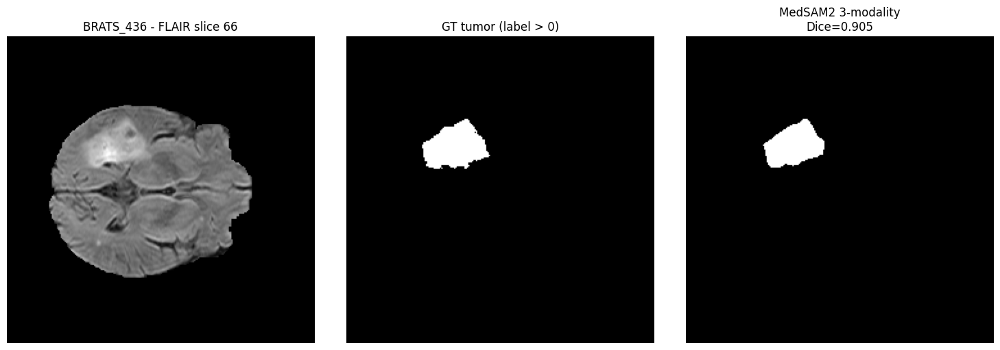

MedSAM2 3-modality on BRATS test set:  84%|████████▎ | 81/97 [14:18<02:46, 10.40s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_436_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_262 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_262.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_262.nii.gz
  -> key_slice_idx: 78
  -> bbox [x_min, y_min, x_max, y_max]: [59 54 93 86]



propagate in video: 100%|██████████| 77/77 [00:02<00:00, 36.68it/s]

propagate in video: 100%|██████████| 79/79 [00:02<00:00, 35.77it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8818


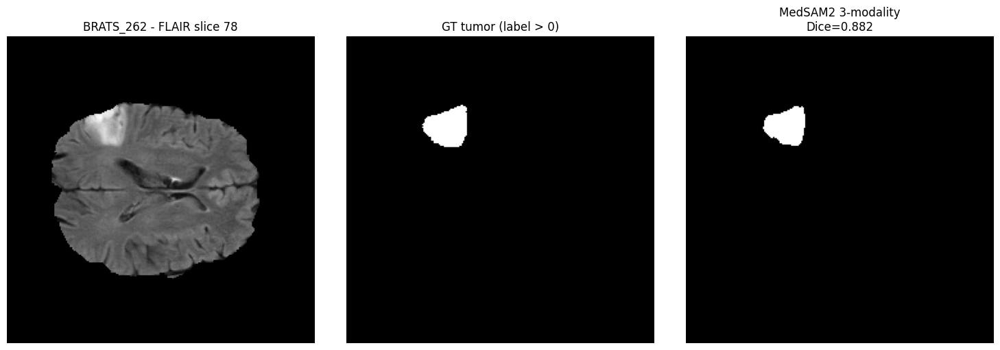

MedSAM2 3-modality on BRATS test set:  85%|████████▍ | 82/97 [14:29<02:35, 10.36s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_262_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_115 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_115.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_115.nii.gz
  -> key_slice_idx: 57
  -> bbox [x_min, y_min, x_max, y_max]: [ 88  58 153 118]



propagate in video: 100%|██████████| 98/98 [00:02<00:00, 35.60it/s]

propagate in video: 100%|██████████| 58/58 [00:01<00:00, 35.87it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8865


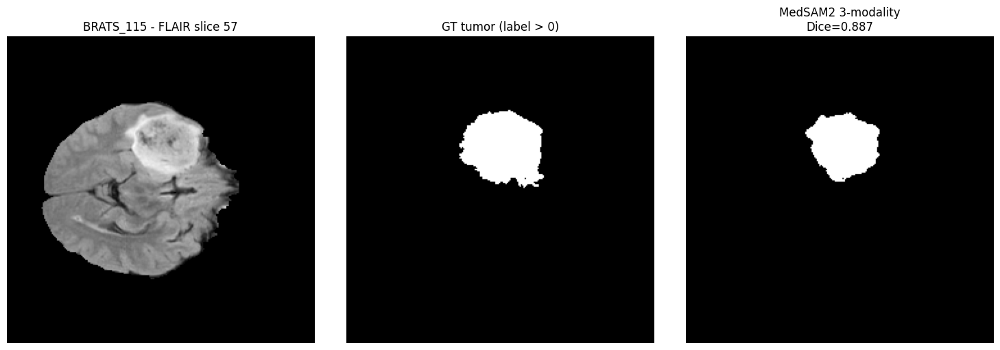

MedSAM2 3-modality on BRATS test set:  86%|████████▌ | 83/97 [14:40<02:29, 10.67s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_115_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_431 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_431.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_431.nii.gz
  -> key_slice_idx: 66
  -> bbox [x_min, y_min, x_max, y_max]: [ 60 117 148 186]



propagate in video: 100%|██████████| 89/89 [00:02<00:00, 36.70it/s]

propagate in video: 100%|██████████| 67/67 [00:01<00:00, 36.34it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7857


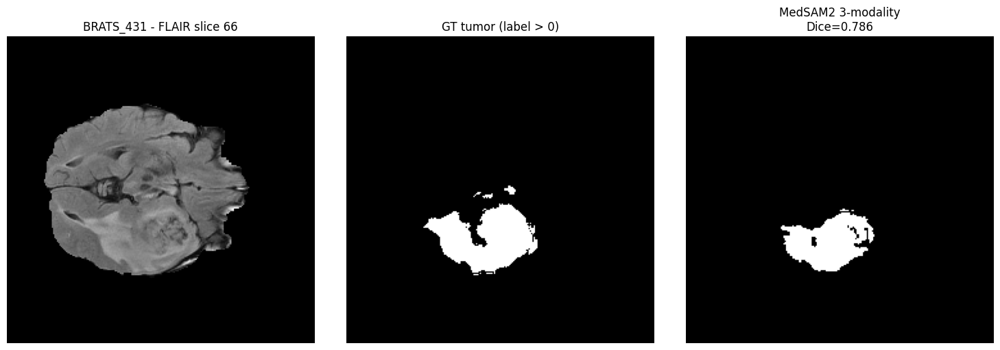

MedSAM2 3-modality on BRATS test set:  87%|████████▋ | 84/97 [14:50<02:16, 10.48s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_431_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_309 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_309.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_309.nii.gz
  -> key_slice_idx: 76
  -> bbox [x_min, y_min, x_max, y_max]: [ 72  59 158 113]



propagate in video: 100%|██████████| 79/79 [00:02<00:00, 36.84it/s]

propagate in video: 100%|██████████| 77/77 [00:02<00:00, 36.09it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9131


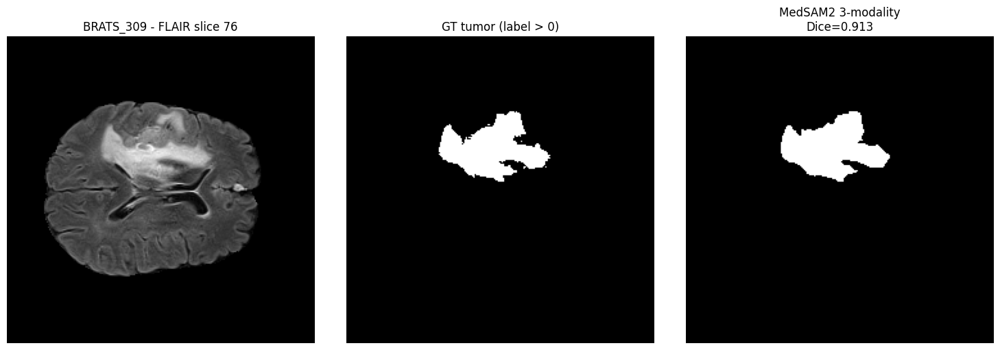

MedSAM2 3-modality on BRATS test set:  88%|████████▊ | 85/97 [15:00<02:05, 10.44s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_309_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_202 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_202.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_202.nii.gz
  -> key_slice_idx: 74
  -> bbox [x_min, y_min, x_max, y_max]: [ 72 109 173 184]



propagate in video: 100%|██████████| 81/81 [00:02<00:00, 37.17it/s]

propagate in video: 100%|██████████| 75/75 [00:02<00:00, 36.29it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8619


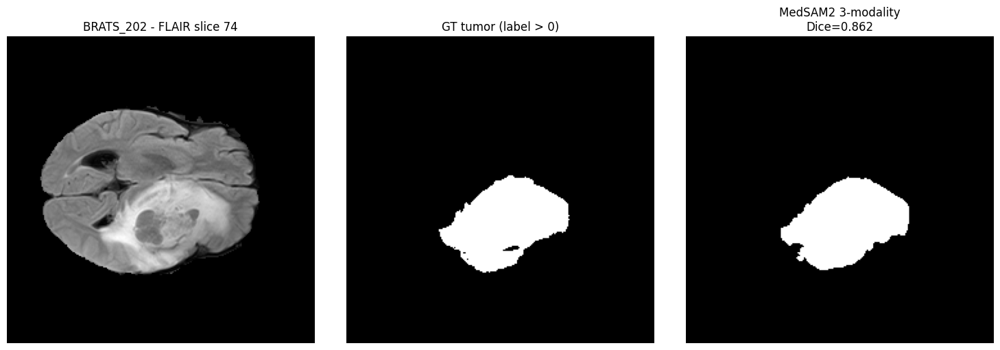

MedSAM2 3-modality on BRATS test set:  89%|████████▊ | 86/97 [15:10<01:53, 10.35s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_202_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_082 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_082.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_082.nii.gz
  -> key_slice_idx: 67
  -> bbox [x_min, y_min, x_max, y_max]: [ 75  59 153 115]



propagate in video: 100%|██████████| 88/88 [00:02<00:00, 36.57it/s]

propagate in video: 100%|██████████| 68/68 [00:01<00:00, 37.03it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.9368


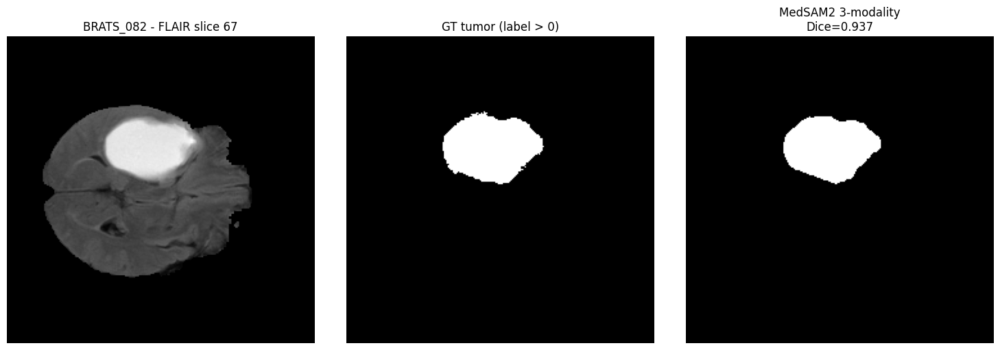

MedSAM2 3-modality on BRATS test set:  90%|████████▉ | 87/97 [15:21<01:43, 10.30s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_082_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_097 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_097.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_097.nii.gz
  -> key_slice_idx: 85
  -> bbox [x_min, y_min, x_max, y_max]: [ 33 120 101 180]



propagate in video: 100%|██████████| 70/70 [00:01<00:00, 35.57it/s]

propagate in video: 100%|██████████| 86/86 [00:02<00:00, 36.67it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8771


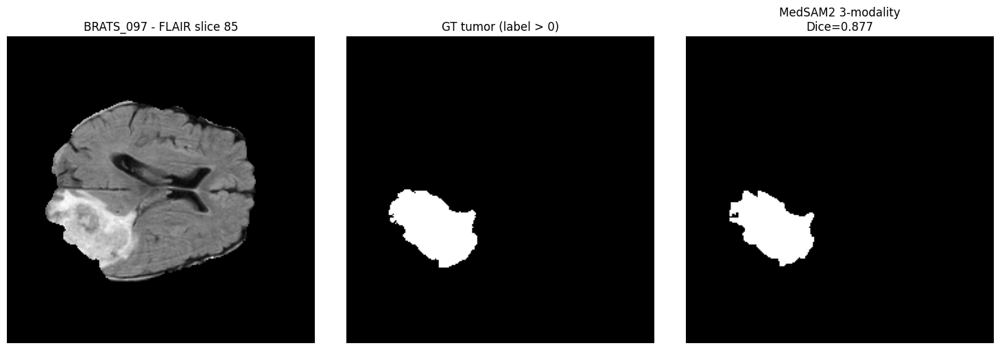

MedSAM2 3-modality on BRATS test set:  91%|█████████ | 88/97 [15:31<01:32, 10.28s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_097_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_227 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_227.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_227.nii.gz
  -> key_slice_idx: 89
  -> bbox [x_min, y_min, x_max, y_max]: [ 91  68 165 141]



propagate in video: 100%|██████████| 66/66 [00:01<00:00, 36.65it/s]

propagate in video: 100%|██████████| 90/90 [00:02<00:00, 35.88it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8366


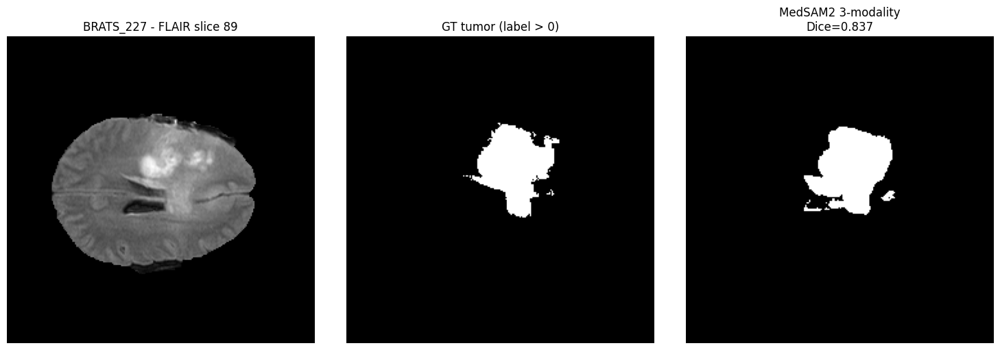

MedSAM2 3-modality on BRATS test set:  92%|█████████▏| 89/97 [15:41<01:21, 10.18s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_227_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_195 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_195.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_195.nii.gz
  -> key_slice_idx: 96
  -> bbox [x_min, y_min, x_max, y_max]: [ 54  61 139 111]



propagate in video: 100%|██████████| 59/59 [00:01<00:00, 37.15it/s]

propagate in video: 100%|██████████| 97/97 [00:02<00:00, 35.39it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.6171


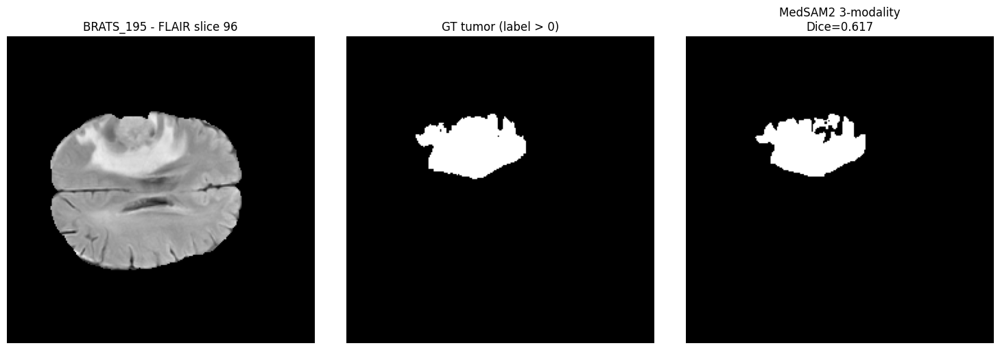

MedSAM2 3-modality on BRATS test set:  93%|█████████▎| 90/97 [15:51<01:12, 10.29s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_195_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_334 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_334.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_334.nii.gz
  -> key_slice_idx: 65
  -> bbox [x_min, y_min, x_max, y_max]: [124  68 209 152]



propagate in video: 100%|██████████| 90/90 [00:02<00:00, 36.93it/s]

propagate in video: 100%|██████████| 66/66 [00:01<00:00, 37.40it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8936


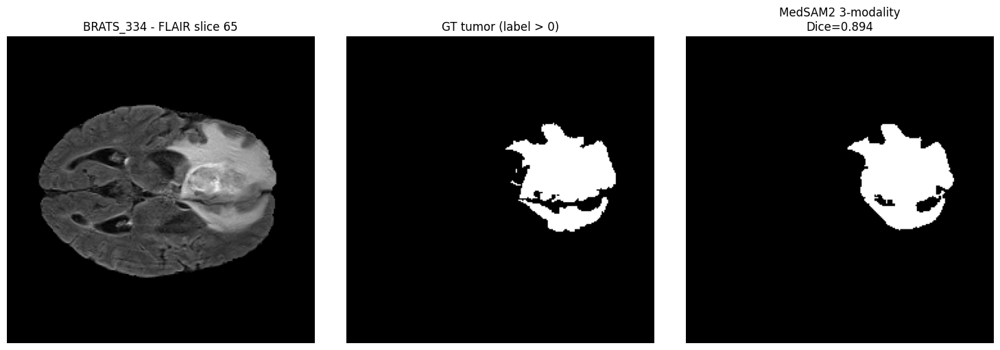

MedSAM2 3-modality on BRATS test set:  94%|█████████▍| 91/97 [16:01<01:00, 10.15s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_334_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_152 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_152.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_152.nii.gz
  -> key_slice_idx: 85
  -> bbox [x_min, y_min, x_max, y_max]: [ 56  58 171 140]



propagate in video: 100%|██████████| 70/70 [00:01<00:00, 37.00it/s]

propagate in video: 100%|██████████| 86/86 [00:02<00:00, 37.02it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.6405


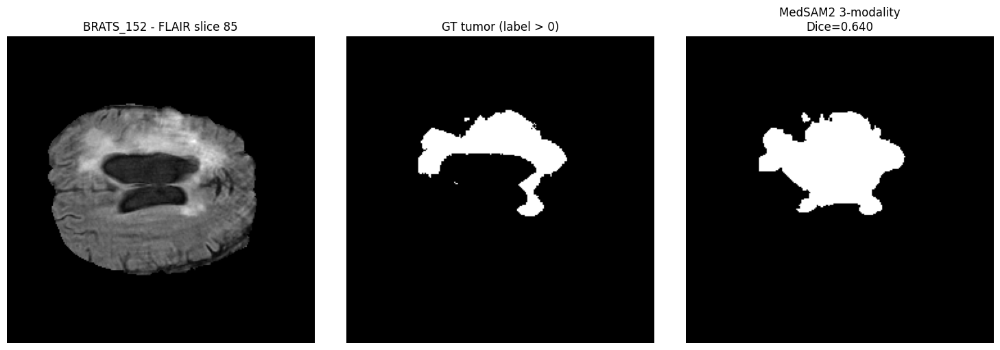

MedSAM2 3-modality on BRATS test set:  95%|█████████▍| 92/97 [16:12<00:51, 10.23s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_152_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_379 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_379.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_379.nii.gz
  -> key_slice_idx: 102
  -> bbox [x_min, y_min, x_max, y_max]: [ 45  96  95 121]



propagate in video: 100%|██████████| 53/53 [00:01<00:00, 36.30it/s]

propagate in video: 100%|██████████| 103/103 [00:02<00:00, 36.43it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8699


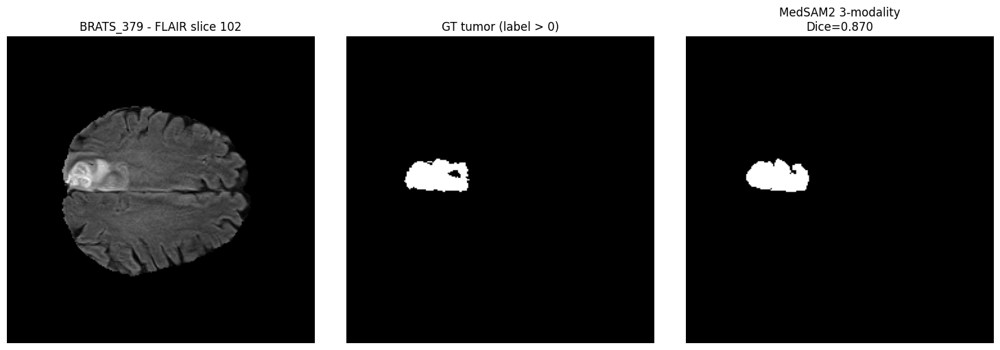

MedSAM2 3-modality on BRATS test set:  96%|█████████▌| 93/97 [16:22<00:41, 10.37s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_379_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_411 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_411.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_411.nii.gz
  -> key_slice_idx: 76
  -> bbox [x_min, y_min, x_max, y_max]: [ 92  67 182 161]



propagate in video: 100%|██████████| 79/79 [00:02<00:00, 36.11it/s]

propagate in video: 100%|██████████| 77/77 [00:02<00:00, 36.56it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8706


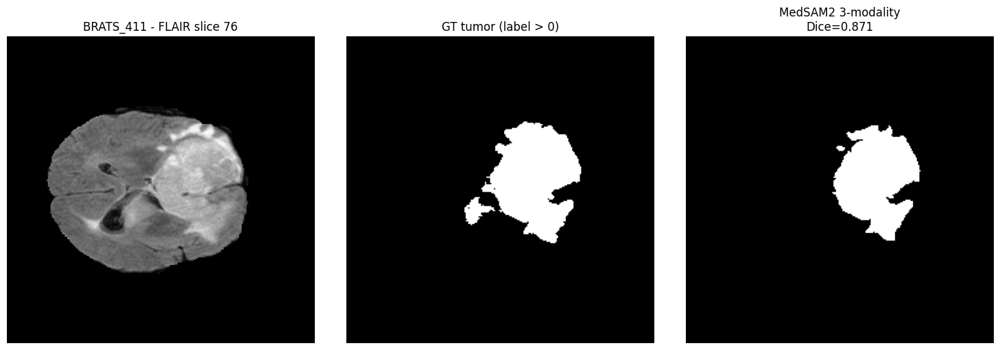

MedSAM2 3-modality on BRATS test set:  97%|█████████▋| 94/97 [16:33<00:31, 10.37s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_411_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_118 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_118.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_118.nii.gz
  -> key_slice_idx: 92
  -> bbox [x_min, y_min, x_max, y_max]: [ 49 130 152 184]



propagate in video: 100%|██████████| 63/63 [00:01<00:00, 35.70it/s]

propagate in video: 100%|██████████| 93/93 [00:02<00:00, 36.45it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8241


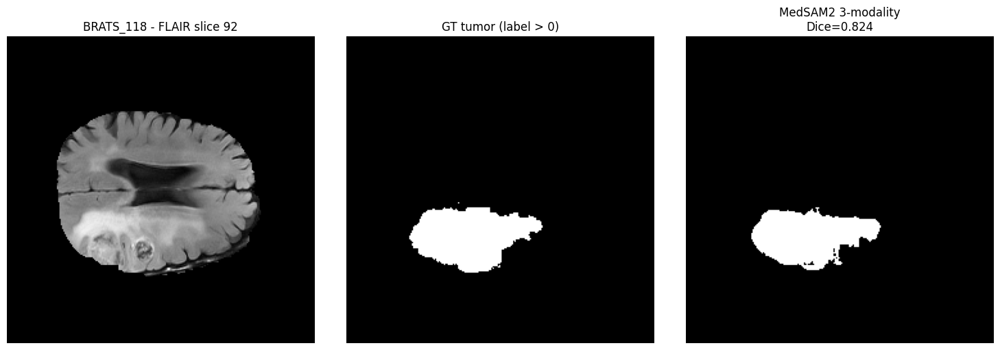

MedSAM2 3-modality on BRATS test set:  98%|█████████▊| 95/97 [16:43<00:20, 10.45s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_118_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_028 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_028.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_028.nii.gz
  -> key_slice_idx: 57
  -> bbox [x_min, y_min, x_max, y_max]: [ 75  48 154  99]



propagate in video: 100%|██████████| 98/98 [00:02<00:00, 35.99it/s]

propagate in video: 100%|██████████| 58/58 [00:01<00:00, 36.22it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.7717


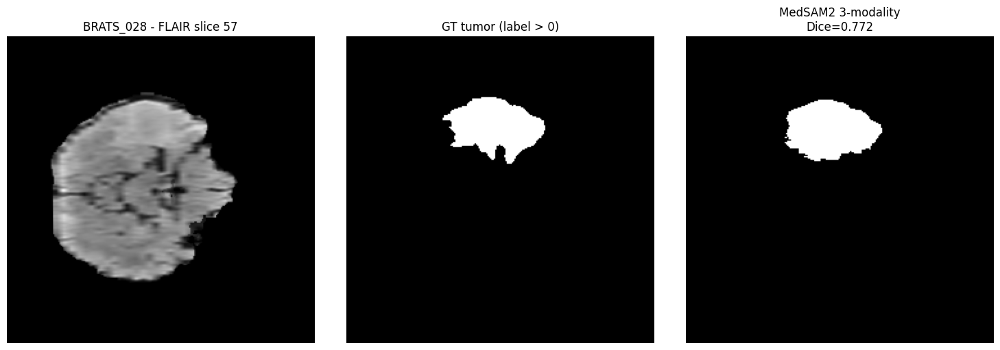

MedSAM2 3-modality on BRATS test set:  99%|█████████▉| 96/97 [16:54<00:10, 10.53s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_028_MedSAM2_3mod_mask.nii.gz

=== Processing case: BRATS_455 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_455.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_455.nii.gz
  -> key_slice_idx: 67
  -> bbox [x_min, y_min, x_max, y_max]: [ 78 107 162 184]



propagate in video: 100%|██████████| 88/88 [00:02<00:00, 36.36it/s]

propagate in video: 100%|██████████| 68/68 [00:01<00:00, 35.32it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, 3-modality): 0.8689


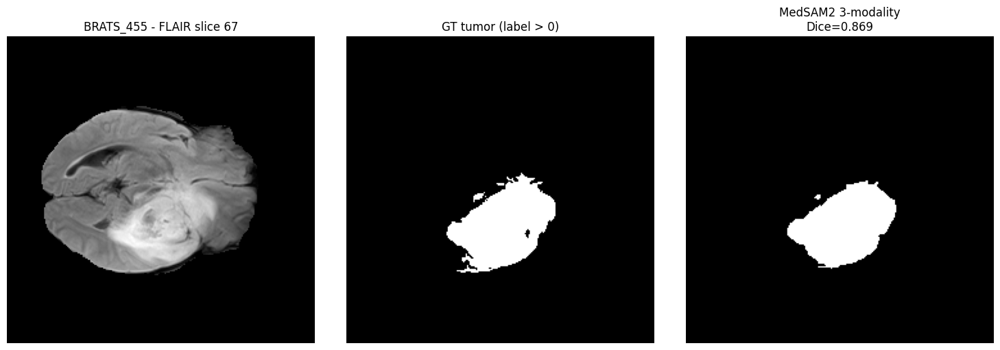

MedSAM2 3-modality on BRATS test set: 100%|██████████| 97/97 [17:04<00:00, 10.57s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_455_MedSAM2_3mod_mask.nii.gz

✅ Finished MedSAM2 3-modality on all test cases.
Total cases processed: 97
Saved results CSV: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/MedSAM2_BRATS_3mod_test_results.csv


In [ ]:
# Cell 7: Run MedSAM2 3-modality (FLAIR, T1gd, T2w) on ALL test cases and save to Drive

from tqdm import tqdm
import pandas as pd

def dice_coefficient(pred, target, eps=1e-8):
    """
    pred, target: 3D arrays (D,H,W) with {0,1} or bool.
    Computes Dice on the whole tumor (all non-zero labels).
    """
    pred = pred.astype(bool)
    target = target.astype(bool)

    intersection = np.logical_and(pred, target).sum()
    denom = pred.sum() + target.sum()
    if denom == 0:
        return 1.0  # both empty -> perfect by convention
    return 2.0 * intersection / (denom + eps)

batch_results = []

for case in tqdm(test_cases, desc="MedSAM2 3-modality on BRATS test set"):
    image_path = case["image"]
    label_path = case["label"]

    if not os.path.exists(image_path) or not os.path.exists(label_path):
        print("Skipping (missing files):", image_path)
        continue

    case_id = os.path.basename(image_path).replace(".nii.gz", "")
    print(f"\n=== Processing case: {case_id} ===")
    print(" Image:", image_path)
    print(" Label:", label_path)

    # 1) Load 3-modality volume + label
    #    (FLAIR=0, T1gd=2, T2w=3)
    multi_cdhw, lbl_3d, img_nii, lbl_nii = load_multimodal_and_label(
        image_path, label_path,
        modality_indices=(0, 2, 3)
    )   # multi_cdhw: (3, D, H, W), lbl_3d: (D, H, W)

    # For visualization, take the FLAIR channel (index 0)
    flair_3d = multi_cdhw[0]  # (D, H, W)

    # 2) Choose key slice + bbox from label (whole tumor = label > 0)
    key_slice_idx, bbox = get_key_slice_and_bbox_from_label(lbl_3d)
    if key_slice_idx is None or bbox is None:
        print(f"  -> No tumor voxels found, skipping {case_id}.")
        continue

    print("  -> key_slice_idx:", key_slice_idx)
    print("  -> bbox [x_min, y_min, x_max, y_max]:", bbox)

    # 3) Run MedSAM2 on the 3-modality volume
    pred_3d = run_medsam2_on_multimodal_volume(multi_cdhw, key_slice_idx, bbox)
    print("  -> prediction shape:", pred_3d.shape)

    # 4) Compute Dice vs GT for whole tumor (label > 0)
    gt_tumor = (lbl_3d > 0).astype(np.uint8)
    dice_whole = dice_coefficient(pred_3d, gt_tumor)
    print(f"  -> Dice (whole tumor, 3-modality): {dice_whole:.4f}")

    # 5) Visualization: FLAIR slice + GT + MedSAM2 3-modality mask
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    axs[0].imshow(normalize_to_uint8(flair_3d[key_slice_idx]), cmap="gray")
    axs[0].set_title(f"{case_id} - FLAIR slice {key_slice_idx}")

    axs[1].imshow(gt_tumor[key_slice_idx] > 0, cmap="gray")
    axs[1].set_title("GT tumor (label > 0)")

    axs[2].imshow(pred_3d[key_slice_idx] > 0, cmap="gray")
    axs[2].set_title(f"MedSAM2 3-modality\nDice={dice_whole:.3f}")

    for ax in axs:
        ax.axis("off")

    plt.tight_layout()
    plt.show()

    # 6) Save 3-modality MedSAM2 mask as NIfTI in Drive
    out_mask_path = os.path.join(
        OUTPUT_ROOT,
        f"{case_id}_MedSAM2_3mod_mask.nii.gz"
    )
    save_pred_as_nifti(pred_3d, img_nii, out_mask_path)

    # 7) Record metadata & Dice for later analysis/CSV
    batch_results.append({
        "case_id": case_id,
        "image_path": image_path,
        "label_path": label_path,
        "out_mask_path": out_mask_path,
        "key_slice_idx": int(key_slice_idx),
        "bbox_xmin": int(bbox[0]),
        "bbox_ymin": int(bbox[1]),
        "bbox_xmax": int(bbox[2]),
        "bbox_ymax": int(bbox[3]),
        "dice_whole_tumor_3mod": float(dice_whole),
    })

print("\n✅ Finished MedSAM2 3-modality on all test cases.")
print("Total cases processed:", len(batch_results))

# Save a CSV summary alongside the NIfTIs
if len(batch_results) > 0:
    df = pd.DataFrame(batch_results)
    csv_path = os.path.join(OUTPUT_ROOT, "MedSAM2_BRATS_3mod_test_results.csv")
    df.to_csv(csv_path, index=False)
    print("Saved results CSV:", csv_path)
else:
    print("No cases processed; no CSV saved.")


#7b MSD FLAIR-Only

MedSAM2 FLAIR-only on BRATS test set:   0%|          | 0/97 [00:00<?, ?it/s]


=== Processing case: BRATS_137 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_137.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_137.nii.gz
  -> key_slice_idx: 68
  -> bbox [x_min, y_min, x_max, y_max]: [ 52  62 148 183]



propagate in video: 100%|██████████| 87/87 [00:02<00:00, 36.07it/s]

propagate in video: 100%|██████████| 69/69 [00:01<00:00, 35.74it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8713


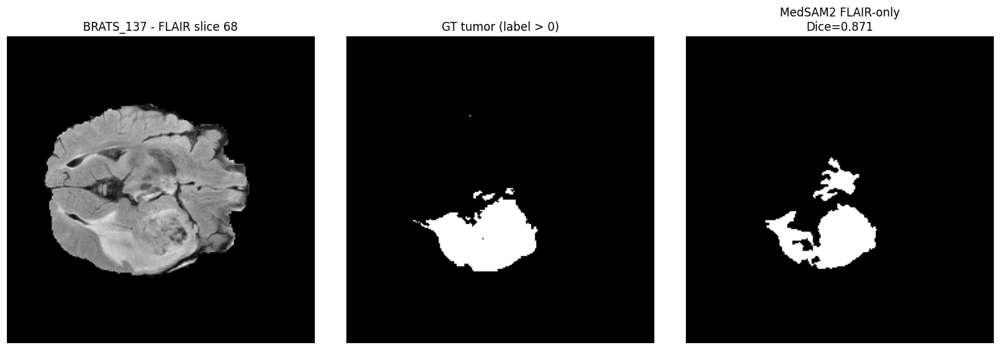

MedSAM2 FLAIR-only on BRATS test set:   1%|          | 1/97 [00:07<11:21,  7.10s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_137_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_441 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_441.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_441.nii.gz
  -> key_slice_idx: 74
  -> bbox [x_min, y_min, x_max, y_max]: [ 40 115 141 185]



propagate in video: 100%|██████████| 81/81 [00:02<00:00, 35.92it/s]

propagate in video: 100%|██████████| 75/75 [00:02<00:00, 35.86it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9148


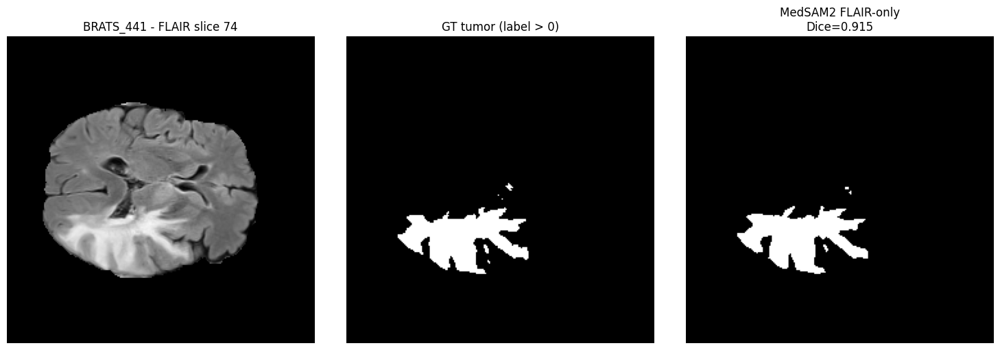

MedSAM2 FLAIR-only on BRATS test set:   2%|▏         | 2/97 [00:17<14:01,  8.86s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_441_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_302 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_302.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_302.nii.gz
  -> key_slice_idx: 48
  -> bbox [x_min, y_min, x_max, y_max]: [ 97 137 157 171]



propagate in video: 100%|██████████| 107/107 [00:02<00:00, 35.80it/s]

propagate in video: 100%|██████████| 49/49 [00:01<00:00, 36.20it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8029


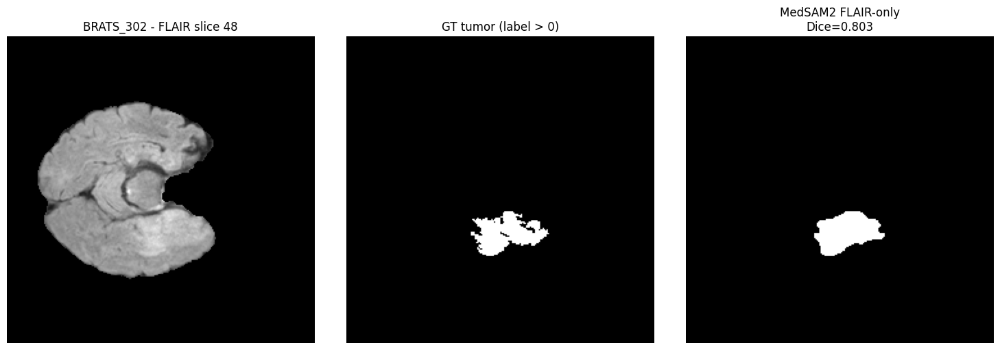

MedSAM2 FLAIR-only on BRATS test set:   3%|▎         | 3/97 [00:27<14:36,  9.33s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_302_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_456 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_456.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_456.nii.gz
  -> key_slice_idx: 75
  -> bbox [x_min, y_min, x_max, y_max]: [ 53 122 158 185]



propagate in video: 100%|██████████| 80/80 [00:02<00:00, 35.93it/s]

propagate in video: 100%|██████████| 76/76 [00:02<00:00, 36.03it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9054


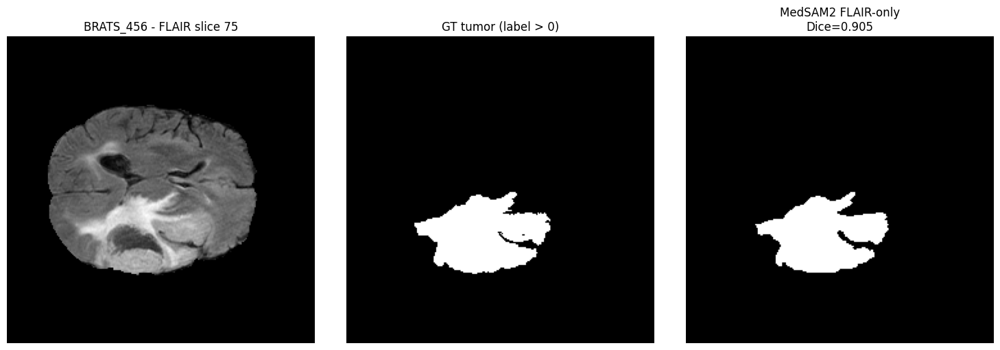

MedSAM2 FLAIR-only on BRATS test set:   4%|▍         | 4/97 [00:37<15:20,  9.90s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_456_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_136 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_136.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_136.nii.gz
  -> key_slice_idx: 69
  -> bbox [x_min, y_min, x_max, y_max]: [ 54 123 136 169]



propagate in video: 100%|██████████| 86/86 [00:02<00:00, 35.46it/s]

propagate in video: 100%|██████████| 70/70 [00:01<00:00, 35.49it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.6712


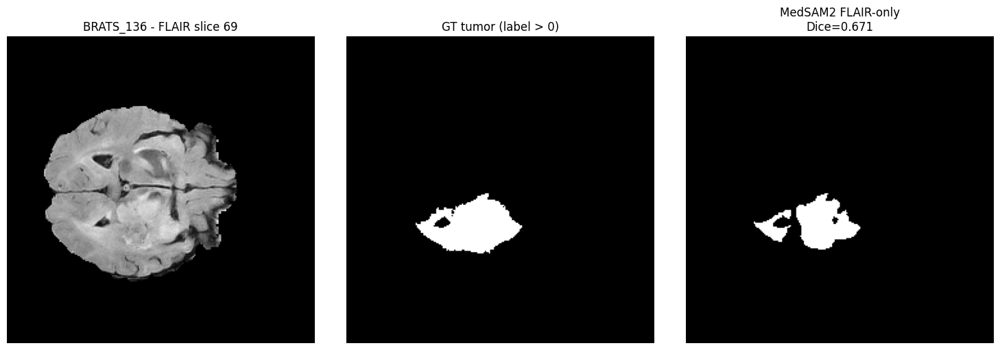

MedSAM2 FLAIR-only on BRATS test set:   5%|▌         | 5/97 [00:48<15:27, 10.08s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_136_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_167 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_167.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_167.nii.gz
  -> key_slice_idx: 54
  -> bbox [x_min, y_min, x_max, y_max]: [ 41  67  76 101]



propagate in video: 100%|██████████| 101/101 [00:02<00:00, 35.20it/s]

propagate in video: 100%|██████████| 55/55 [00:01<00:00, 36.58it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8626


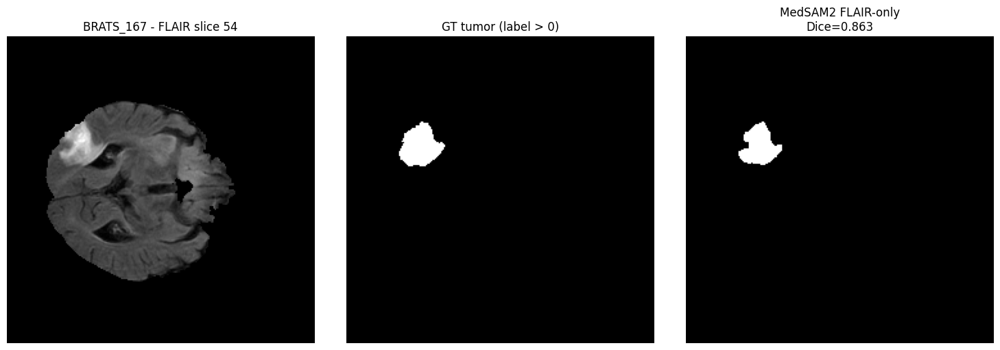

MedSAM2 FLAIR-only on BRATS test set:   6%|▌         | 6/97 [00:58<15:16, 10.07s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_167_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_348 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_348.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_348.nii.gz
  -> key_slice_idx: 72
  -> bbox [x_min, y_min, x_max, y_max]: [ 51 131 136 179]



propagate in video: 100%|██████████| 83/83 [00:02<00:00, 35.70it/s]

propagate in video: 100%|██████████| 73/73 [00:02<00:00, 35.22it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8686


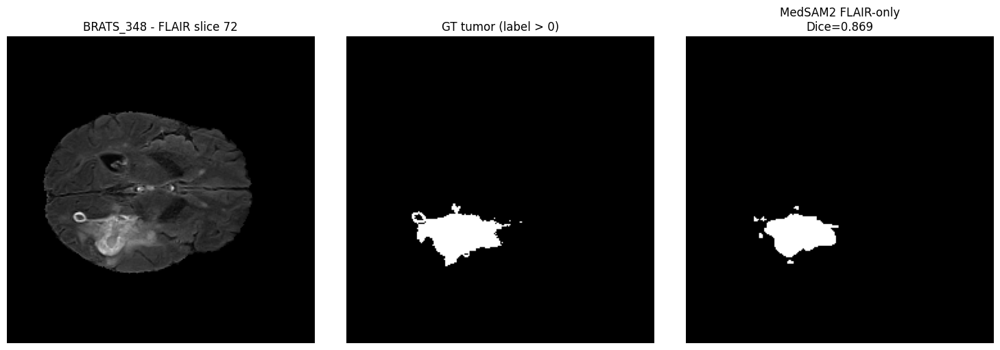

MedSAM2 FLAIR-only on BRATS test set:   7%|▋         | 7/97 [01:08<14:58,  9.98s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_348_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_211 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_211.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_211.nii.gz
  -> key_slice_idx: 70
  -> bbox [x_min, y_min, x_max, y_max]: [ 49  63 125 103]



propagate in video: 100%|██████████| 85/85 [00:02<00:00, 34.98it/s]

propagate in video: 100%|██████████| 71/71 [00:01<00:00, 35.91it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.7852


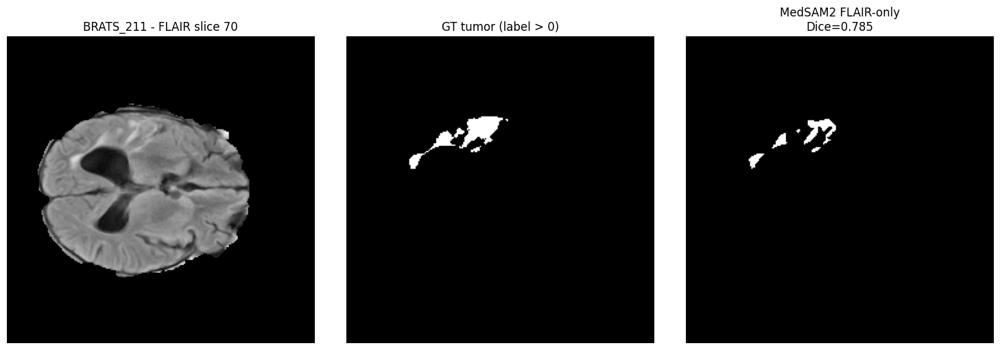

MedSAM2 FLAIR-only on BRATS test set:   8%|▊         | 8/97 [01:18<14:46,  9.96s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_211_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_315 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_315.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_315.nii.gz
  -> key_slice_idx: 106
  -> bbox [x_min, y_min, x_max, y_max]: [ 97  93 169 154]



propagate in video: 100%|██████████| 49/49 [00:01<00:00, 35.81it/s]

propagate in video: 100%|██████████| 107/107 [00:03<00:00, 35.23it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.7247


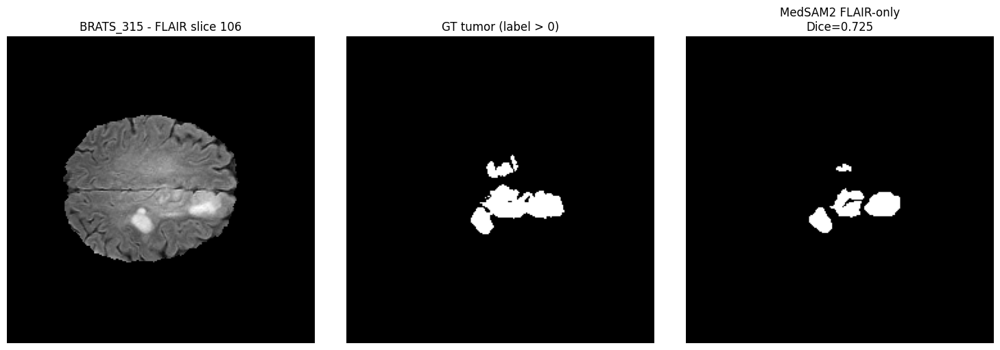

MedSAM2 FLAIR-only on BRATS test set:   9%|▉         | 9/97 [01:28<14:51, 10.13s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_315_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_069 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_069.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_069.nii.gz
  -> key_slice_idx: 71
  -> bbox [x_min, y_min, x_max, y_max]: [ 76 131 158 166]



propagate in video: 100%|██████████| 84/84 [00:02<00:00, 35.44it/s]

propagate in video: 100%|██████████| 72/72 [00:02<00:00, 35.84it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.5070


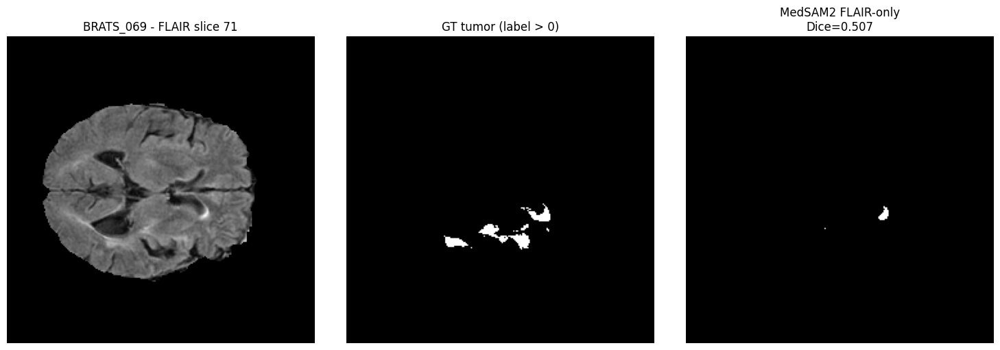

MedSAM2 FLAIR-only on BRATS test set:  10%|█         | 10/97 [01:38<14:39, 10.11s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_069_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_297 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_297.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_297.nii.gz
  -> key_slice_idx: 83
  -> bbox [x_min, y_min, x_max, y_max]: [ 57  64 106 103]



propagate in video: 100%|██████████| 72/72 [00:02<00:00, 35.37it/s]

propagate in video: 100%|██████████| 84/84 [00:02<00:00, 35.46it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8336


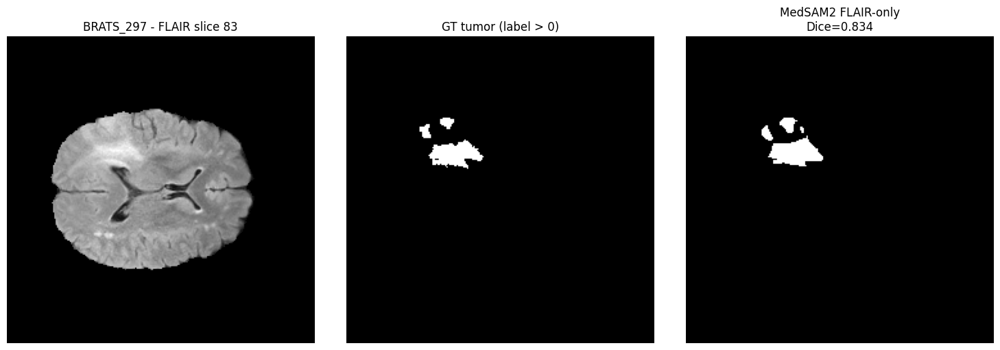

MedSAM2 FLAIR-only on BRATS test set:  11%|█▏        | 11/97 [01:48<14:25, 10.06s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_297_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_345 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_345.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_345.nii.gz
  -> key_slice_idx: 95
  -> bbox [x_min, y_min, x_max, y_max]: [ 68 127 150 182]



propagate in video: 100%|██████████| 60/60 [00:01<00:00, 35.13it/s]

propagate in video: 100%|██████████| 96/96 [00:02<00:00, 35.23it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9221


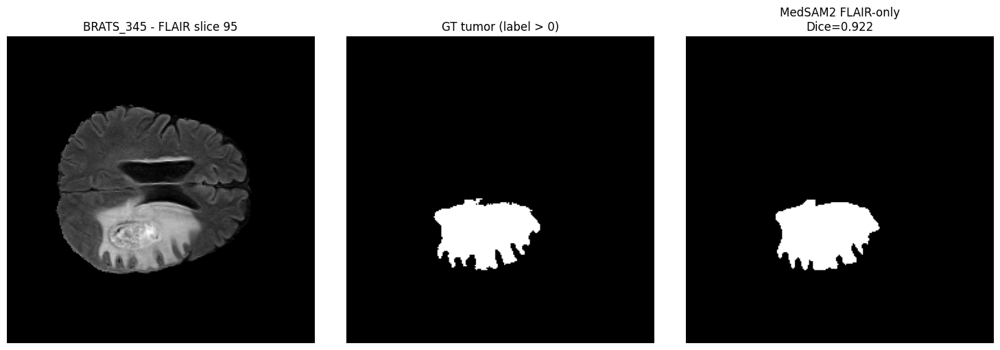

MedSAM2 FLAIR-only on BRATS test set:  12%|█▏        | 12/97 [01:58<14:18, 10.10s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_345_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_404 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_404.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_404.nii.gz
  -> key_slice_idx: 67
  -> bbox [x_min, y_min, x_max, y_max]: [ 62  56 162 130]



propagate in video: 100%|██████████| 88/88 [00:02<00:00, 35.13it/s]

propagate in video: 100%|██████████| 68/68 [00:01<00:00, 34.83it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8665


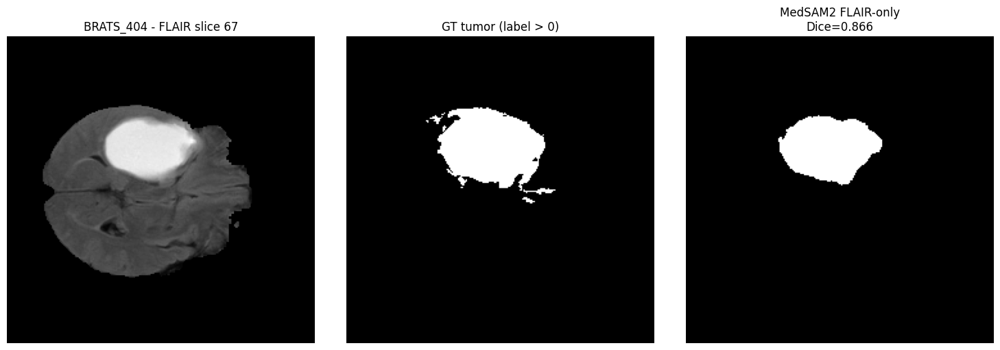

MedSAM2 FLAIR-only on BRATS test set:  13%|█▎        | 13/97 [02:09<14:22, 10.27s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_404_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_296 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_296.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_296.nii.gz
  -> key_slice_idx: 54
  -> bbox [x_min, y_min, x_max, y_max]: [ 85 126 154 181]



propagate in video: 100%|██████████| 101/101 [00:02<00:00, 35.83it/s]

propagate in video: 100%|██████████| 55/55 [00:01<00:00, 35.30it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8857


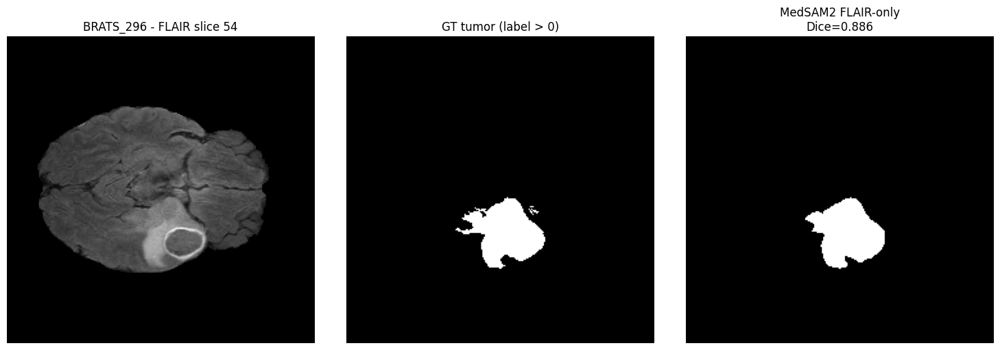

MedSAM2 FLAIR-only on BRATS test set:  14%|█▍        | 14/97 [02:19<14:14, 10.30s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_296_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_261 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_261.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_261.nii.gz
  -> key_slice_idx: 81
  -> bbox [x_min, y_min, x_max, y_max]: [110  67 199 137]



propagate in video: 100%|██████████| 74/74 [00:02<00:00, 35.61it/s]

propagate in video: 100%|██████████| 82/82 [00:02<00:00, 35.40it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9403


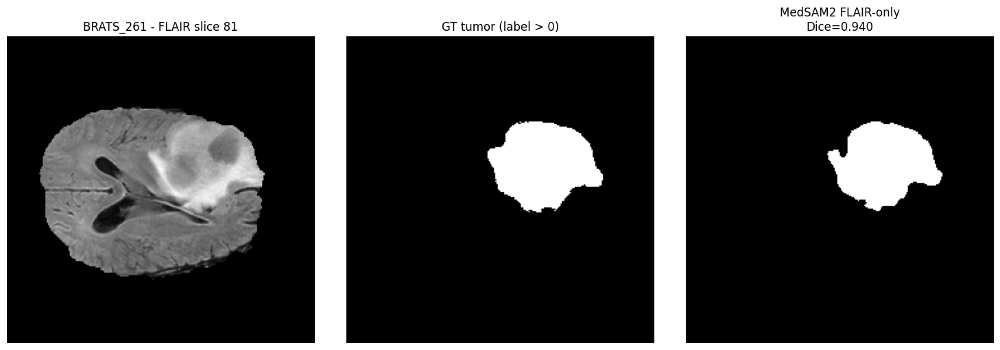

MedSAM2 FLAIR-only on BRATS test set:  15%|█▌        | 15/97 [02:30<14:15, 10.43s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_261_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_405 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_405.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_405.nii.gz
  -> key_slice_idx: 92
  -> bbox [x_min, y_min, x_max, y_max]: [104 120 164 165]



propagate in video: 100%|██████████| 63/63 [00:01<00:00, 35.67it/s]

propagate in video: 100%|██████████| 93/93 [00:02<00:00, 36.02it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9167


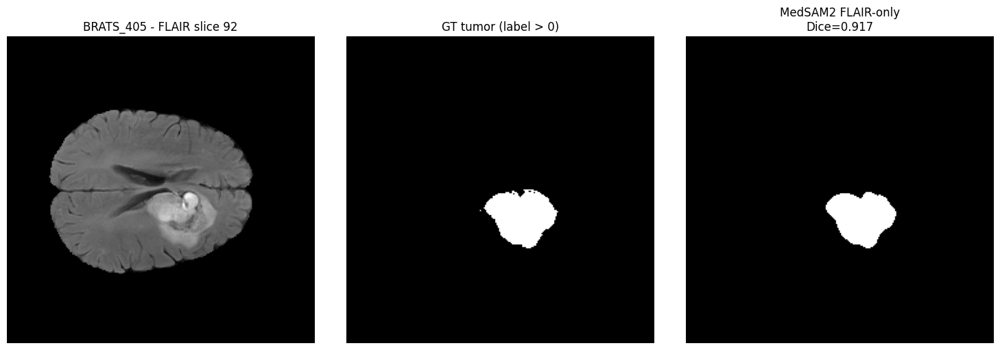

MedSAM2 FLAIR-only on BRATS test set:  16%|█▋        | 16/97 [02:40<14:00, 10.38s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_405_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_234 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_234.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_234.nii.gz
  -> key_slice_idx: 87
  -> bbox [x_min, y_min, x_max, y_max]: [ 52  96 124 162]



propagate in video: 100%|██████████| 68/68 [00:01<00:00, 35.67it/s]

propagate in video: 100%|██████████| 88/88 [00:02<00:00, 35.35it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9234


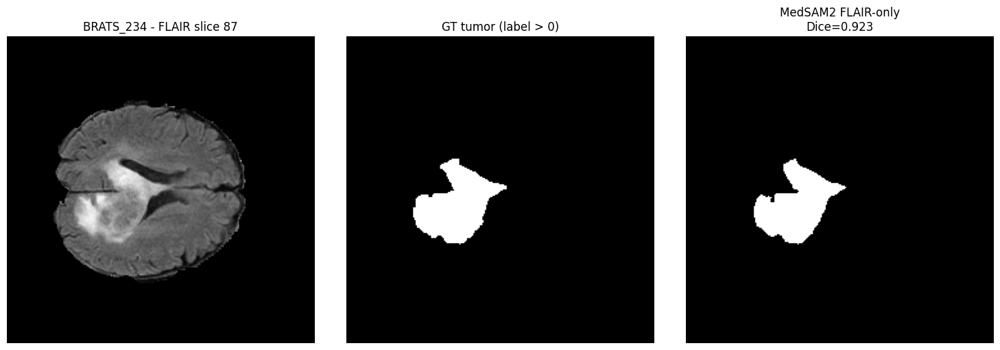

MedSAM2 FLAIR-only on BRATS test set:  18%|█▊        | 17/97 [02:50<13:43, 10.29s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_234_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_462 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_462.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_462.nii.gz
  -> key_slice_idx: 52
  -> bbox [x_min, y_min, x_max, y_max]: [ 99  51 152 107]



propagate in video: 100%|██████████| 103/103 [00:02<00:00, 34.67it/s]

propagate in video: 100%|██████████| 53/53 [00:01<00:00, 36.21it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.6187


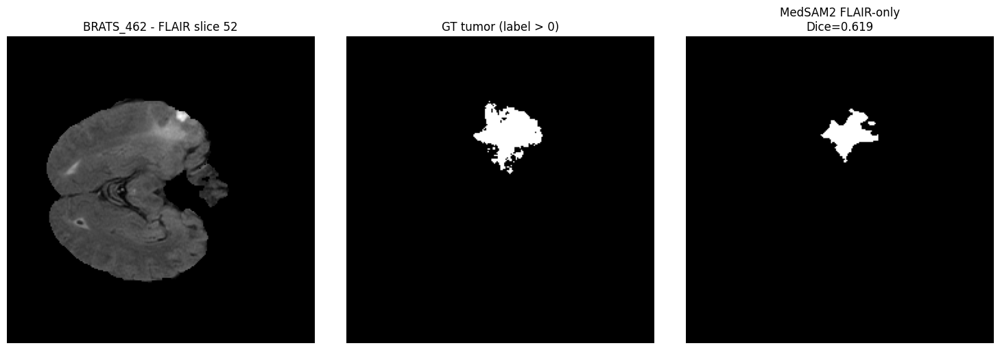

MedSAM2 FLAIR-only on BRATS test set:  19%|█▊        | 18/97 [03:00<13:13, 10.04s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_462_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_032 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_032.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_032.nii.gz
  -> key_slice_idx: 89
  -> bbox [x_min, y_min, x_max, y_max]: [ 69  62 181 145]



propagate in video: 100%|██████████| 66/66 [00:01<00:00, 35.57it/s]

propagate in video: 100%|██████████| 90/90 [00:02<00:00, 34.92it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8122


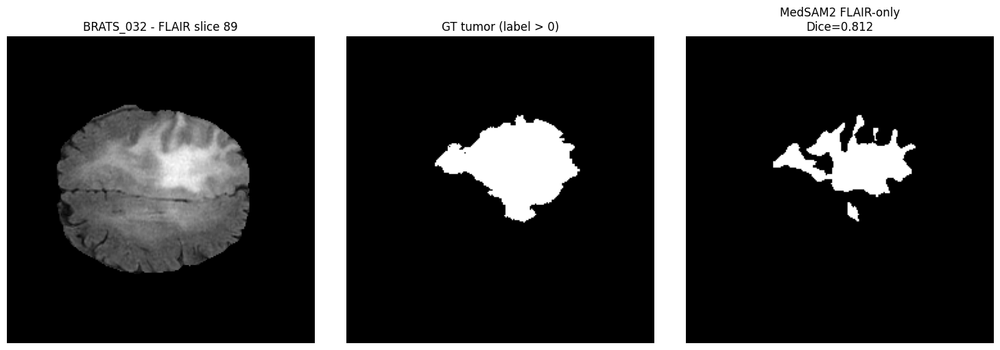

MedSAM2 FLAIR-only on BRATS test set:  20%|█▉        | 19/97 [03:11<13:20, 10.26s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_032_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_428 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_428.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_428.nii.gz
  -> key_slice_idx: 66
  -> bbox [x_min, y_min, x_max, y_max]: [ 57  58 118 109]



propagate in video: 100%|██████████| 89/89 [00:02<00:00, 32.36it/s]

propagate in video: 100%|██████████| 67/67 [00:01<00:00, 35.03it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8079


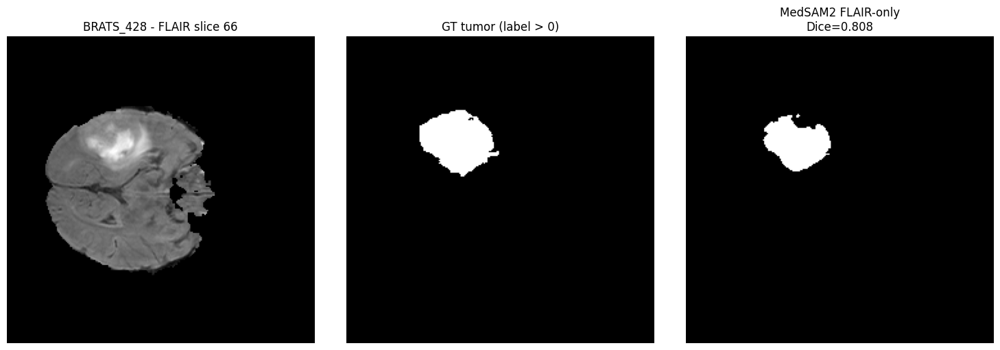

MedSAM2 FLAIR-only on BRATS test set:  21%|██        | 20/97 [03:21<13:06, 10.22s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_428_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_109 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_109.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_109.nii.gz
  -> key_slice_idx: 93
  -> bbox [x_min, y_min, x_max, y_max]: [ 91  67 168 115]



propagate in video: 100%|██████████| 62/62 [00:01<00:00, 35.60it/s]

propagate in video: 100%|██████████| 94/94 [00:02<00:00, 35.14it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9200


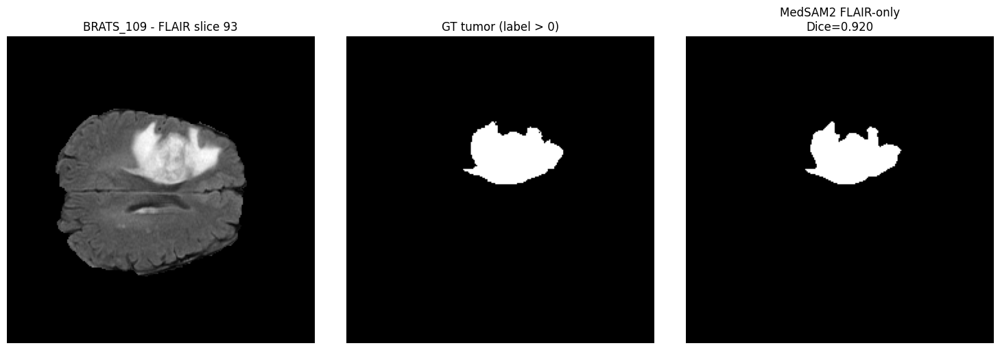

MedSAM2 FLAIR-only on BRATS test set:  22%|██▏       | 21/97 [03:31<12:50, 10.14s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_109_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_346 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_346.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_346.nii.gz
  -> key_slice_idx: 98
  -> bbox [x_min, y_min, x_max, y_max]: [ 42 124  96 162]



propagate in video: 100%|██████████| 57/57 [00:01<00:00, 35.01it/s]

propagate in video: 100%|██████████| 99/99 [00:02<00:00, 34.82it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9070


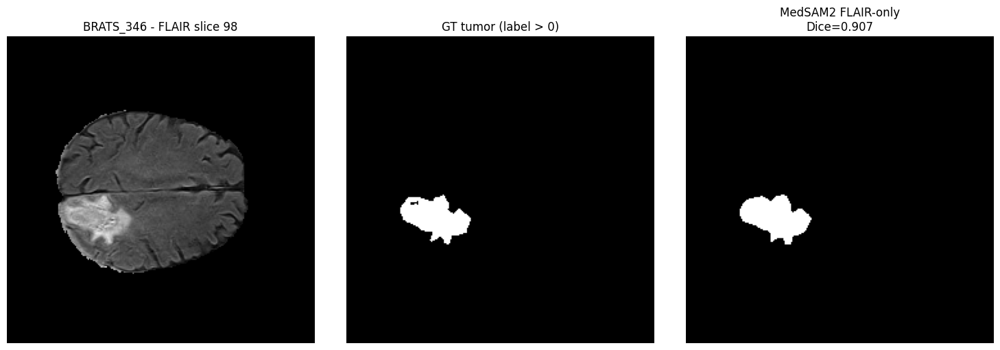

MedSAM2 FLAIR-only on BRATS test set:  23%|██▎       | 22/97 [03:41<12:45, 10.21s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_346_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_306 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_306.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_306.nii.gz
  -> key_slice_idx: 63
  -> bbox [x_min, y_min, x_max, y_max]: [ 91  54 146  90]



propagate in video: 100%|██████████| 92/92 [00:02<00:00, 35.48it/s]

propagate in video: 100%|██████████| 64/64 [00:01<00:00, 35.58it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8233


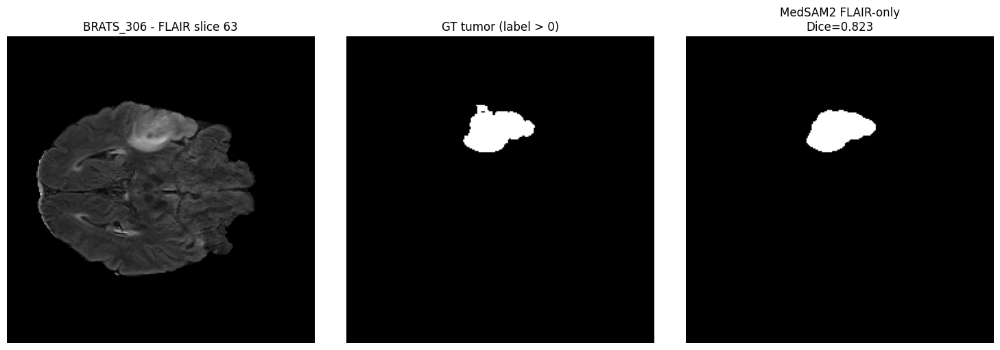

MedSAM2 FLAIR-only on BRATS test set:  24%|██▎       | 23/97 [03:51<12:33, 10.18s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_306_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_047 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_047.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_047.nii.gz
  -> key_slice_idx: 97
  -> bbox [x_min, y_min, x_max, y_max]: [110 102 184 178]



propagate in video: 100%|██████████| 58/58 [00:01<00:00, 34.79it/s]

propagate in video: 100%|██████████| 98/98 [00:02<00:00, 34.49it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9111


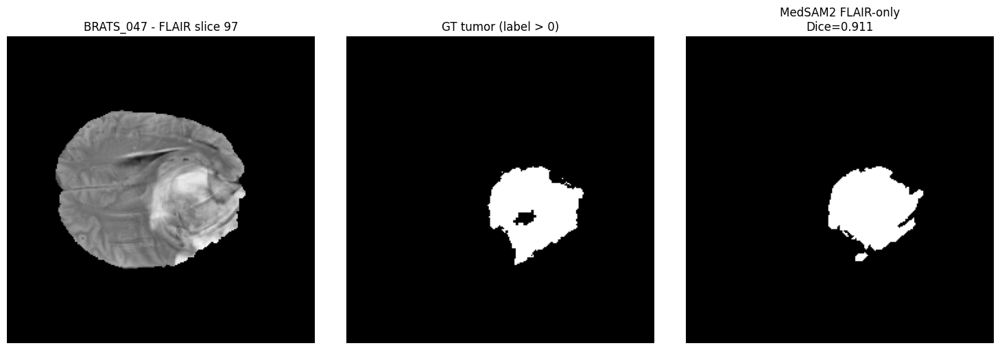

MedSAM2 FLAIR-only on BRATS test set:  25%|██▍       | 24/97 [04:01<12:25, 10.22s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_047_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_339 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_339.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_339.nii.gz
  -> key_slice_idx: 87
  -> bbox [x_min, y_min, x_max, y_max]: [ 50 118 116 172]



propagate in video: 100%|██████████| 68/68 [00:01<00:00, 34.69it/s]

propagate in video: 100%|██████████| 88/88 [00:02<00:00, 35.05it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9306


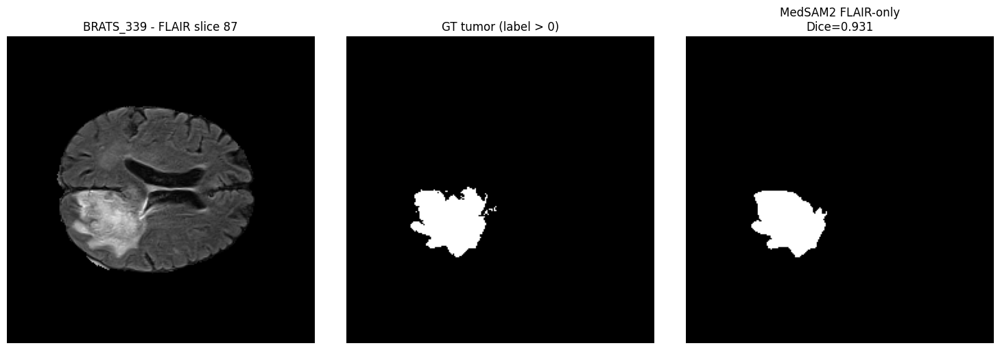

MedSAM2 FLAIR-only on BRATS test set:  26%|██▌       | 25/97 [04:12<12:20, 10.28s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_339_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_142 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_142.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_142.nii.gz
  -> key_slice_idx: 73
  -> bbox [x_min, y_min, x_max, y_max]: [ 37  60 122 131]



propagate in video: 100%|██████████| 82/82 [00:02<00:00, 35.45it/s]

propagate in video: 100%|██████████| 74/74 [00:02<00:00, 34.68it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9425


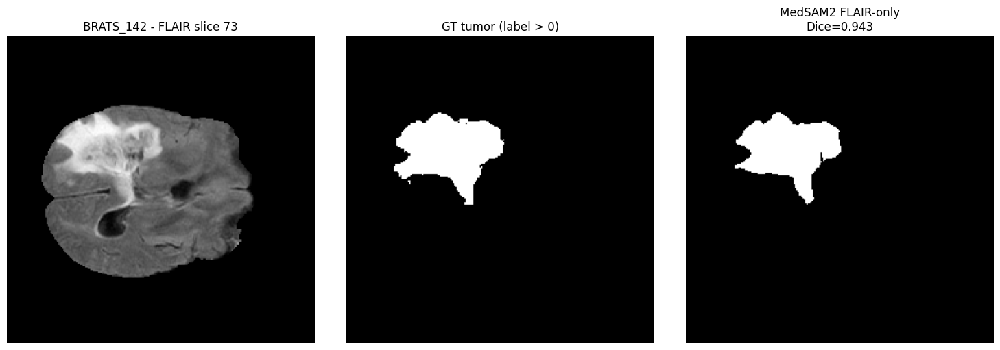

MedSAM2 FLAIR-only on BRATS test set:  27%|██▋       | 26/97 [04:22<12:05, 10.21s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_142_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_164 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_164.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_164.nii.gz
  -> key_slice_idx: 82
  -> bbox [x_min, y_min, x_max, y_max]: [ 34  78  93 120]



propagate in video: 100%|██████████| 73/73 [00:02<00:00, 35.15it/s]

propagate in video: 100%|██████████| 83/83 [00:02<00:00, 35.27it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9254


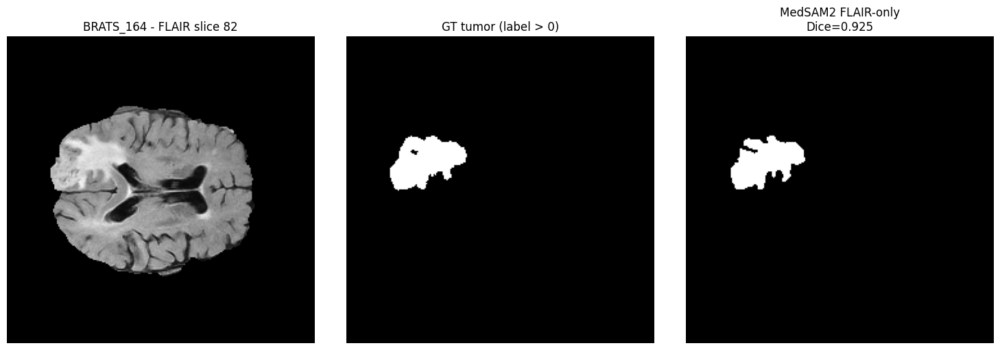

MedSAM2 FLAIR-only on BRATS test set:  28%|██▊       | 27/97 [04:32<12:00, 10.29s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_164_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_469 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_469.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_469.nii.gz
  -> key_slice_idx: 108
  -> bbox [x_min, y_min, x_max, y_max]: [ 91 118 173 170]



propagate in video: 100%|██████████| 47/47 [00:01<00:00, 35.23it/s]

propagate in video: 100%|██████████| 109/109 [00:03<00:00, 35.11it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8913


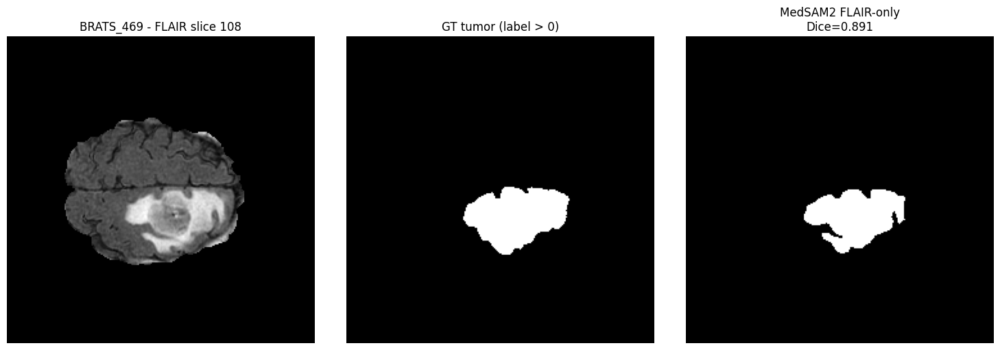

MedSAM2 FLAIR-only on BRATS test set:  29%|██▉       | 28/97 [04:43<11:58, 10.41s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_469_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_402 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_402.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_402.nii.gz
  -> key_slice_idx: 62
  -> bbox [x_min, y_min, x_max, y_max]: [ 71  58 185 113]



propagate in video: 100%|██████████| 93/93 [00:02<00:00, 35.13it/s]

propagate in video: 100%|██████████| 63/63 [00:01<00:00, 34.58it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8713


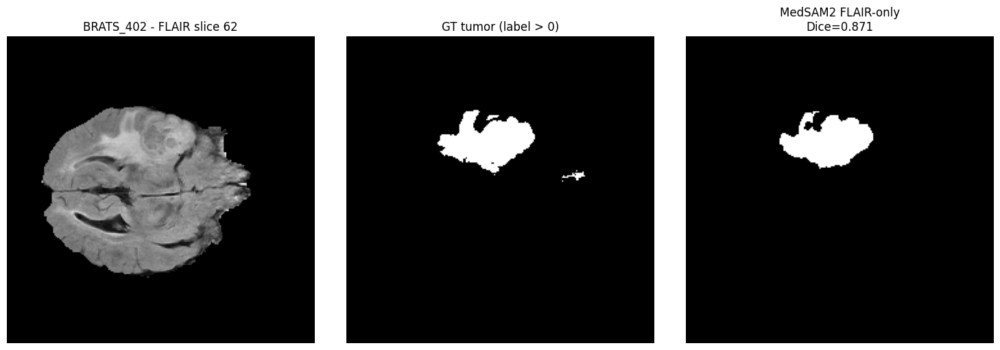

MedSAM2 FLAIR-only on BRATS test set:  30%|██▉       | 29/97 [04:54<12:04, 10.65s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_402_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_043 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_043.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_043.nii.gz
  -> key_slice_idx: 93
  -> bbox [x_min, y_min, x_max, y_max]: [ 83  89 123 117]



propagate in video: 100%|██████████| 62/62 [00:01<00:00, 35.09it/s]

propagate in video: 100%|██████████| 94/94 [00:02<00:00, 35.21it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8164


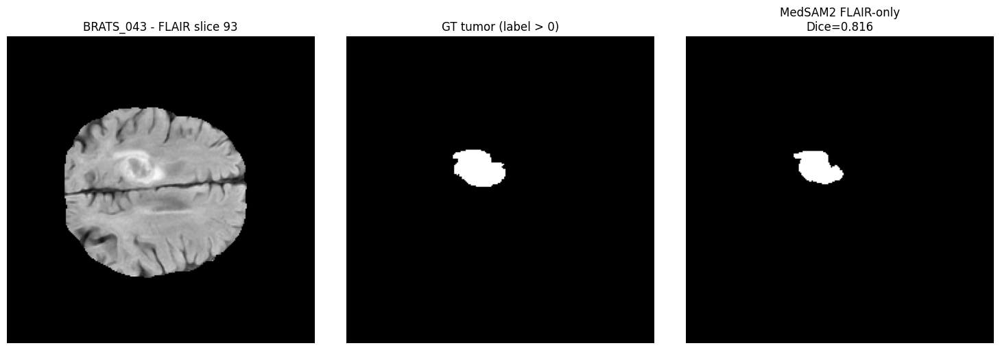

MedSAM2 FLAIR-only on BRATS test set:  31%|███       | 30/97 [05:05<11:48, 10.57s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_043_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_153 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_153.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_153.nii.gz
  -> key_slice_idx: 95
  -> bbox [x_min, y_min, x_max, y_max]: [ 68 104 135 173]



propagate in video: 100%|██████████| 60/60 [00:01<00:00, 34.45it/s]

propagate in video: 100%|██████████| 96/96 [00:02<00:00, 34.86it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.7611


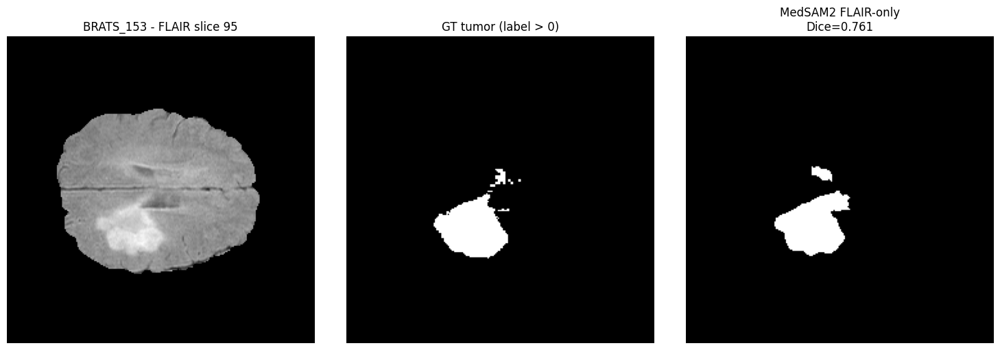

MedSAM2 FLAIR-only on BRATS test set:  32%|███▏      | 31/97 [05:15<11:34, 10.52s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_153_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_308 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_308.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_308.nii.gz
  -> key_slice_idx: 57
  -> bbox [x_min, y_min, x_max, y_max]: [ 54 143 143 187]



propagate in video: 100%|██████████| 98/98 [00:02<00:00, 35.15it/s]

propagate in video: 100%|██████████| 58/58 [00:01<00:00, 35.32it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9018


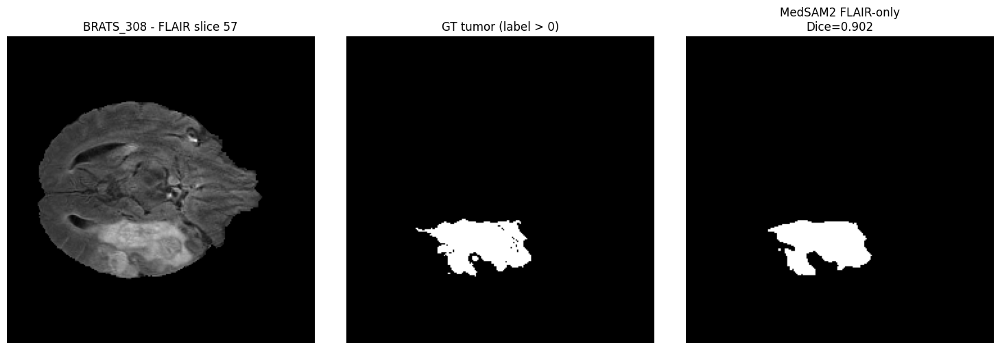

MedSAM2 FLAIR-only on BRATS test set:  33%|███▎      | 32/97 [05:25<11:17, 10.43s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_308_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_266 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_266.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_266.nii.gz
  -> key_slice_idx: 92
  -> bbox [x_min, y_min, x_max, y_max]: [ 96 100 188 177]



propagate in video: 100%|██████████| 63/63 [00:01<00:00, 35.22it/s]

propagate in video: 100%|██████████| 93/93 [00:02<00:00, 35.43it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9147


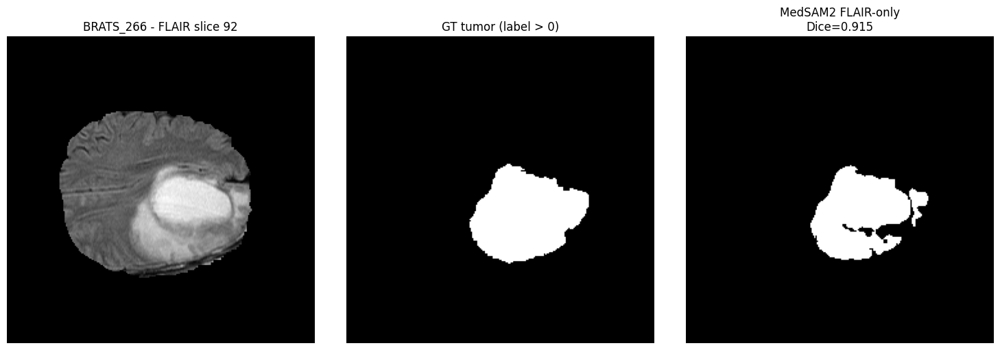

MedSAM2 FLAIR-only on BRATS test set:  34%|███▍      | 33/97 [05:35<11:02, 10.35s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_266_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_360 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_360.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_360.nii.gz
  -> key_slice_idx: 91
  -> bbox [x_min, y_min, x_max, y_max]: [ 93 132 145 184]



propagate in video: 100%|██████████| 64/64 [00:01<00:00, 34.76it/s]

propagate in video: 100%|██████████| 92/92 [00:02<00:00, 35.16it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.7744


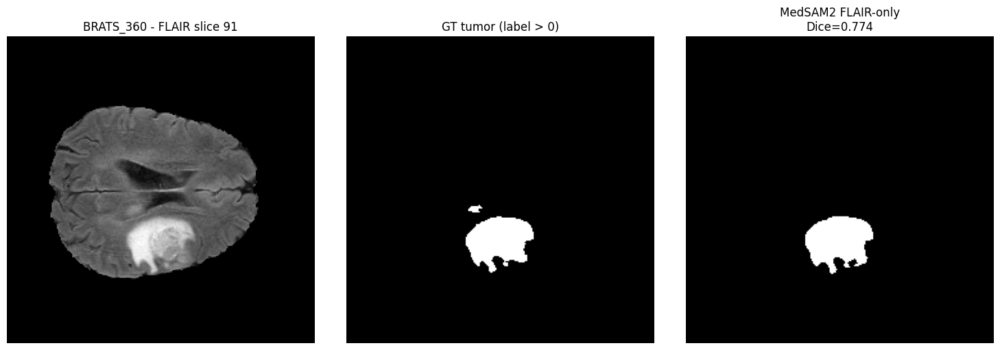

MedSAM2 FLAIR-only on BRATS test set:  35%|███▌      | 34/97 [05:46<10:46, 10.27s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_360_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_009 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_009.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_009.nii.gz
  -> key_slice_idx: 88
  -> bbox [x_min, y_min, x_max, y_max]: [ 88  97 189 174]



propagate in video: 100%|██████████| 67/67 [00:01<00:00, 34.40it/s]

propagate in video: 100%|██████████| 89/89 [00:02<00:00, 35.05it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9406


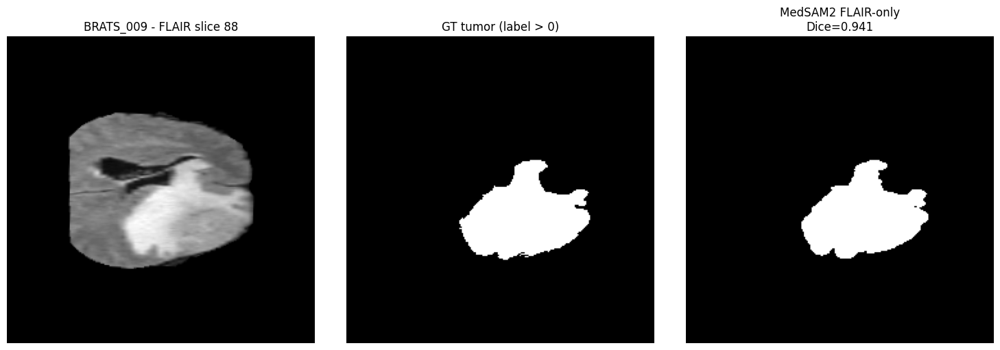

MedSAM2 FLAIR-only on BRATS test set:  36%|███▌      | 35/97 [05:57<10:55, 10.58s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_009_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_483 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_483.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_483.nii.gz
  -> key_slice_idx: 55
  -> bbox [x_min, y_min, x_max, y_max]: [ 77 141 154 185]



propagate in video: 100%|██████████| 100/100 [00:02<00:00, 34.23it/s]

propagate in video: 100%|██████████| 56/56 [00:01<00:00, 34.97it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9064


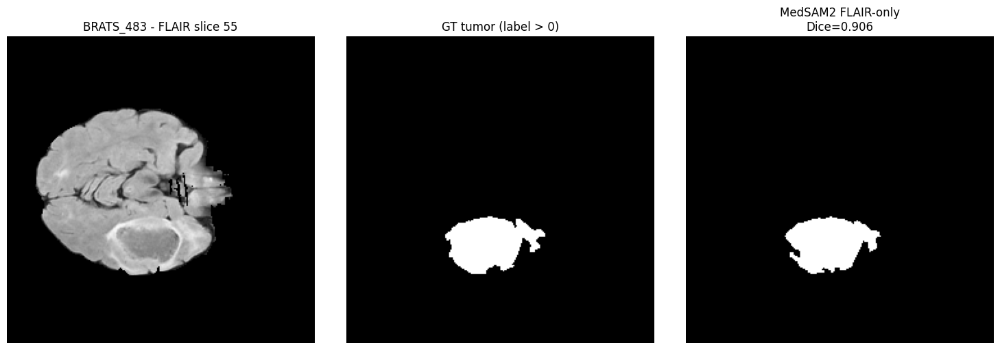

MedSAM2 FLAIR-only on BRATS test set:  37%|███▋      | 36/97 [06:07<10:45, 10.58s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_483_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_389 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_389.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_389.nii.gz
  -> key_slice_idx: 91
  -> bbox [x_min, y_min, x_max, y_max]: [ 83  89 136 117]



propagate in video: 100%|██████████| 64/64 [00:01<00:00, 34.39it/s]

propagate in video: 100%|██████████| 92/92 [00:02<00:00, 34.41it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8573


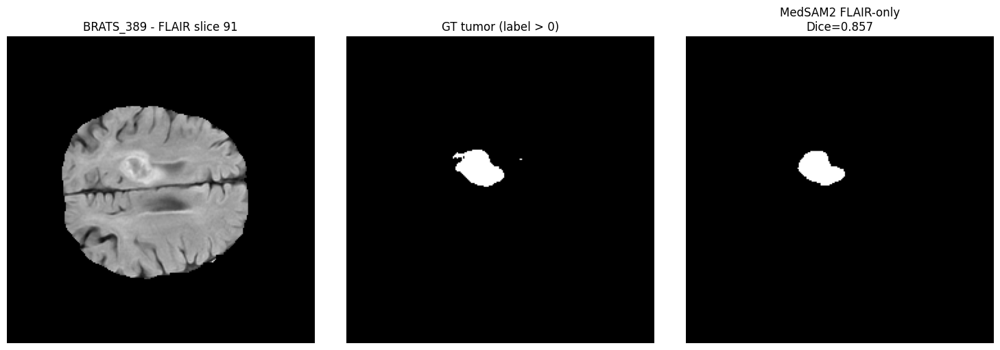

MedSAM2 FLAIR-only on BRATS test set:  38%|███▊      | 37/97 [06:17<10:23, 10.40s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_389_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_129 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_129.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_129.nii.gz
  -> key_slice_idx: 87
  -> bbox [x_min, y_min, x_max, y_max]: [ 85  64 188 146]



propagate in video: 100%|██████████| 68/68 [00:02<00:00, 33.72it/s]

propagate in video: 100%|██████████| 88/88 [00:02<00:00, 34.48it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9220


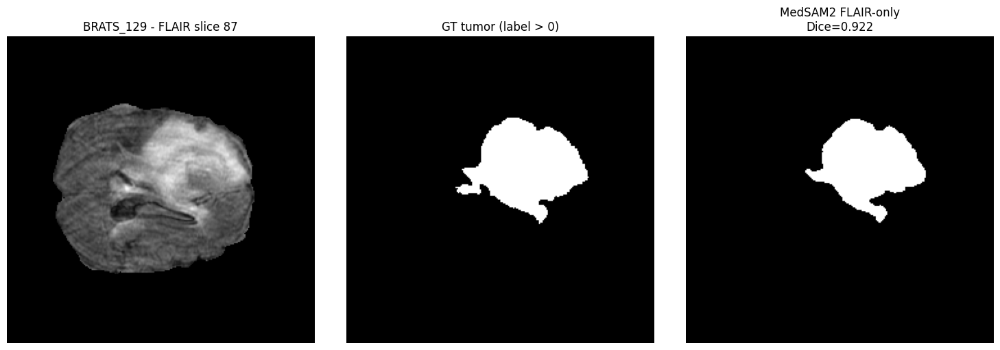

MedSAM2 FLAIR-only on BRATS test set:  39%|███▉      | 38/97 [06:27<10:02, 10.20s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_129_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_369 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_369.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_369.nii.gz
  -> key_slice_idx: 77
  -> bbox [x_min, y_min, x_max, y_max]: [ 95  67 186 134]



propagate in video: 100%|██████████| 78/78 [00:02<00:00, 34.34it/s]

propagate in video: 100%|██████████| 78/78 [00:02<00:00, 34.30it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9516


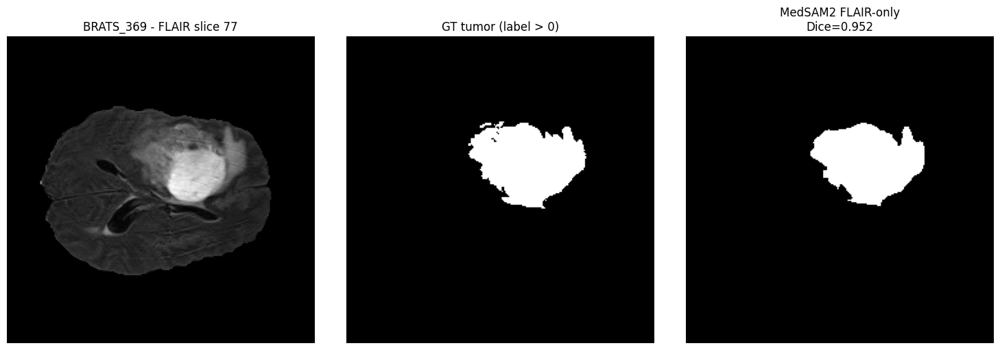

MedSAM2 FLAIR-only on BRATS test set:  40%|████      | 39/97 [06:38<10:00, 10.36s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_369_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_470 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_470.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_470.nii.gz
  -> key_slice_idx: 85
  -> bbox [x_min, y_min, x_max, y_max]: [ 72  82 147 137]



propagate in video: 100%|██████████| 70/70 [00:01<00:00, 35.04it/s]

propagate in video: 100%|██████████| 86/86 [00:02<00:00, 35.16it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8641


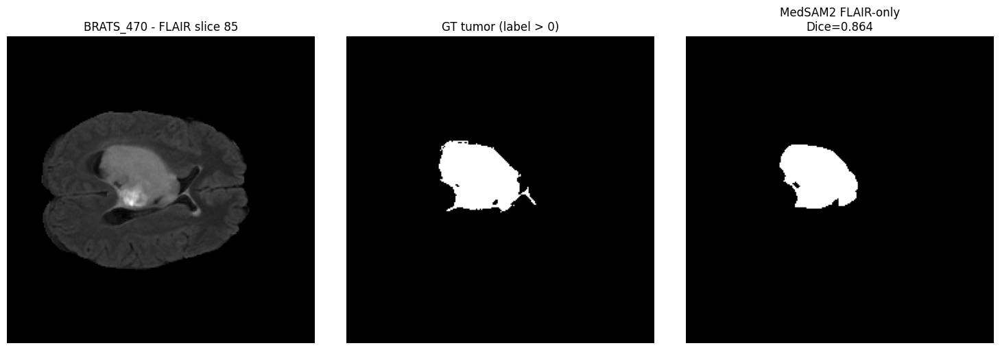

MedSAM2 FLAIR-only on BRATS test set:  41%|████      | 40/97 [06:48<09:48, 10.33s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_470_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_068 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_068.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_068.nii.gz
  -> key_slice_idx: 68
  -> bbox [x_min, y_min, x_max, y_max]: [ 92 151 144 181]



propagate in video: 100%|██████████| 87/87 [00:02<00:00, 34.96it/s]

propagate in video: 100%|██████████| 69/69 [00:01<00:00, 34.89it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.7167


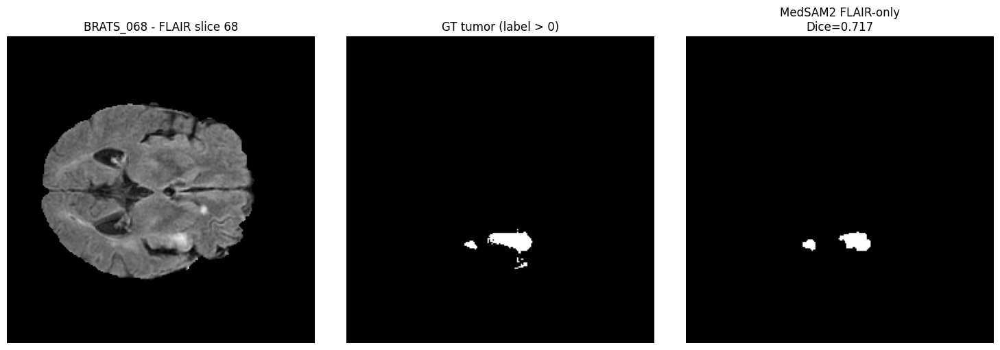

MedSAM2 FLAIR-only on BRATS test set:  42%|████▏     | 41/97 [06:59<09:50, 10.55s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_068_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_409 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_409.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_409.nii.gz
  -> key_slice_idx: 94
  -> bbox [x_min, y_min, x_max, y_max]: [110 109 195 171]



propagate in video: 100%|██████████| 61/61 [00:01<00:00, 35.10it/s]

propagate in video: 100%|██████████| 95/95 [00:02<00:00, 35.45it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9653


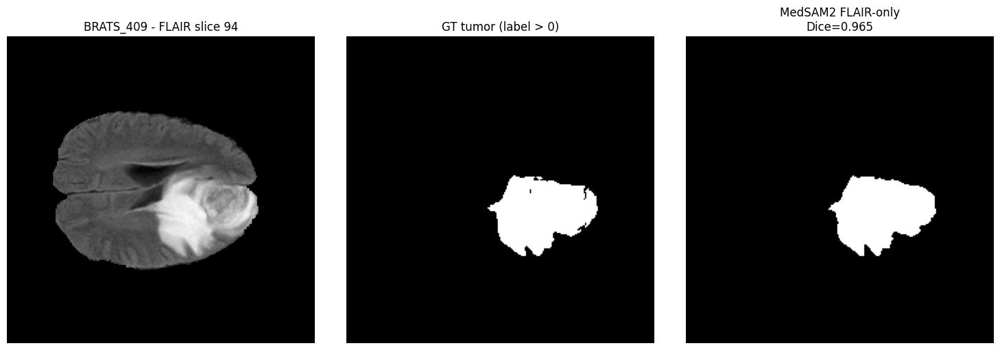

MedSAM2 FLAIR-only on BRATS test set:  43%|████▎     | 42/97 [07:09<09:28, 10.34s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_409_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_194 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_194.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_194.nii.gz
  -> key_slice_idx: 97
  -> bbox [x_min, y_min, x_max, y_max]: [114  72 186 119]



propagate in video: 100%|██████████| 58/58 [00:01<00:00, 35.99it/s]

propagate in video: 100%|██████████| 98/98 [00:02<00:00, 35.88it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8112


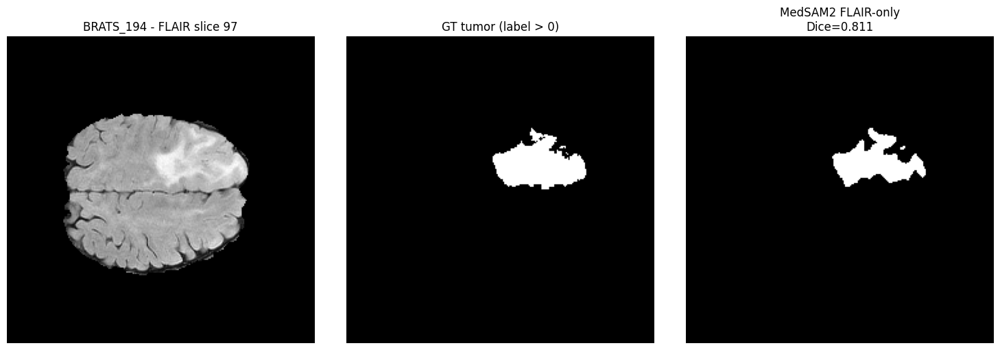

MedSAM2 FLAIR-only on BRATS test set:  44%|████▍     | 43/97 [07:19<09:15, 10.29s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_194_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_228 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_228.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_228.nii.gz
  -> key_slice_idx: 84
  -> bbox [x_min, y_min, x_max, y_max]: [111  70 168 136]



propagate in video: 100%|██████████| 71/71 [00:02<00:00, 34.83it/s]

propagate in video: 100%|██████████| 85/85 [00:02<00:00, 35.82it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.6312


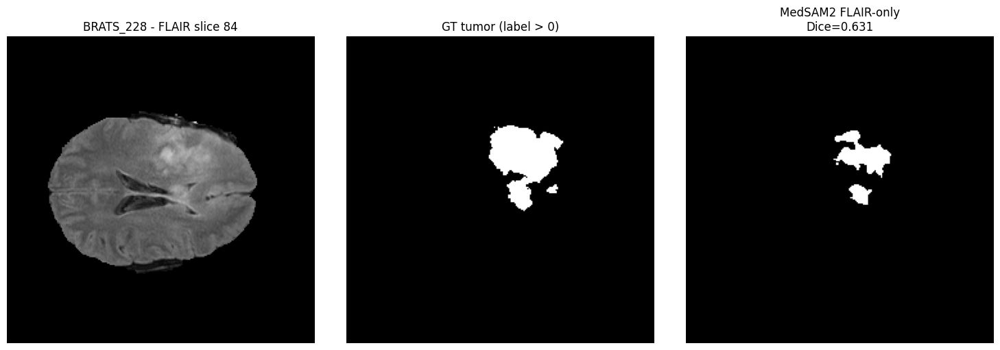

MedSAM2 FLAIR-only on BRATS test set:  45%|████▌     | 44/97 [07:30<09:06, 10.31s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_228_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_425 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_425.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_425.nii.gz
  -> key_slice_idx: 82
  -> bbox [x_min, y_min, x_max, y_max]: [ 30  76  93 139]



propagate in video: 100%|██████████| 73/73 [00:02<00:00, 35.51it/s]

propagate in video: 100%|██████████| 83/83 [00:02<00:00, 35.17it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9100


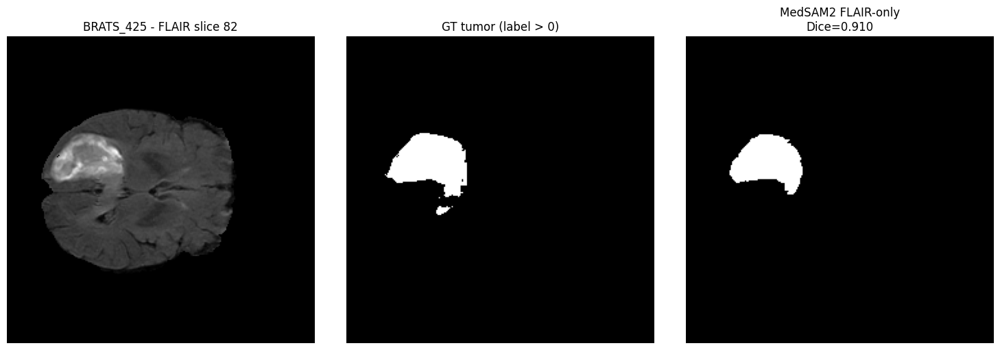

MedSAM2 FLAIR-only on BRATS test set:  46%|████▋     | 45/97 [07:40<08:50, 10.21s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_425_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_344 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_344.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_344.nii.gz
  -> key_slice_idx: 71
  -> bbox [x_min, y_min, x_max, y_max]: [ 53 136 109 188]



propagate in video: 100%|██████████| 84/84 [00:02<00:00, 35.23it/s]

propagate in video: 100%|██████████| 72/72 [00:02<00:00, 35.51it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9172


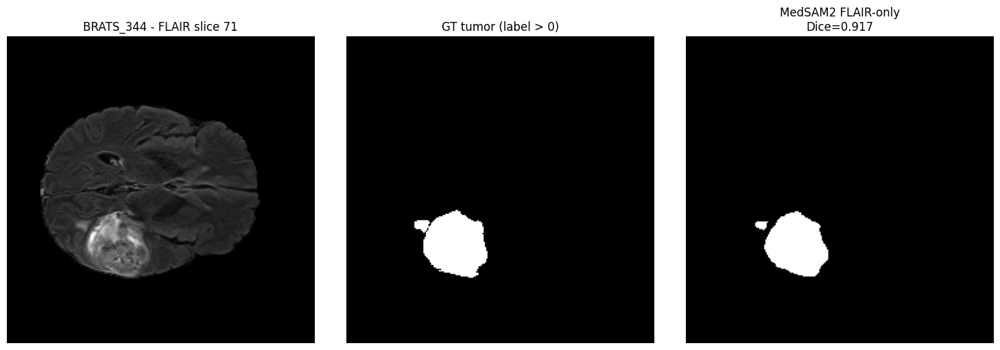

MedSAM2 FLAIR-only on BRATS test set:  47%|████▋     | 46/97 [07:49<08:35, 10.11s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_344_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_156 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_156.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_156.nii.gz
  -> key_slice_idx: 77
  -> bbox [x_min, y_min, x_max, y_max]: [ 30  68 170 149]



propagate in video: 100%|██████████| 78/78 [00:02<00:00, 32.59it/s]

propagate in video: 100%|██████████| 78/78 [00:02<00:00, 35.09it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8796


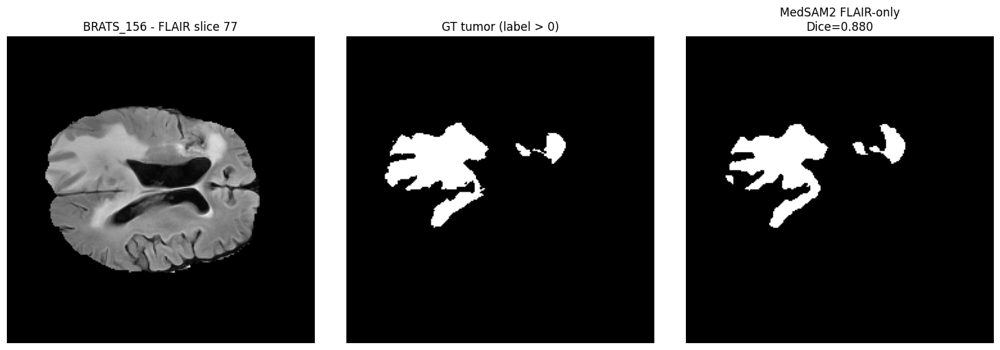

MedSAM2 FLAIR-only on BRATS test set:  48%|████▊     | 47/97 [08:00<08:25, 10.11s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_156_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_233 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_233.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_233.nii.gz
  -> key_slice_idx: 65
  -> bbox [x_min, y_min, x_max, y_max]: [118  65 142  92]



propagate in video: 100%|██████████| 90/90 [00:02<00:00, 35.71it/s]

propagate in video: 100%|██████████| 66/66 [00:01<00:00, 35.41it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8045


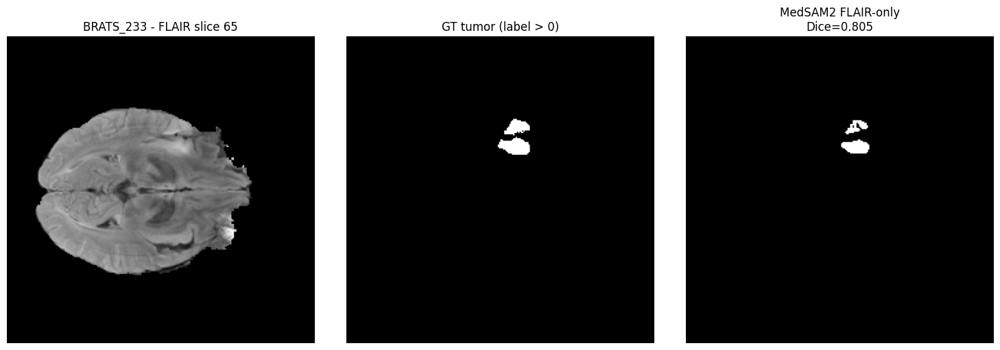

MedSAM2 FLAIR-only on BRATS test set:  49%|████▉     | 48/97 [08:11<08:29, 10.40s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_233_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_356 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_356.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_356.nii.gz
  -> key_slice_idx: 101
  -> bbox [x_min, y_min, x_max, y_max]: [ 91  96 175 174]



propagate in video: 100%|██████████| 54/54 [00:01<00:00, 35.85it/s]

propagate in video: 100%|██████████| 102/102 [00:02<00:00, 35.35it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9188


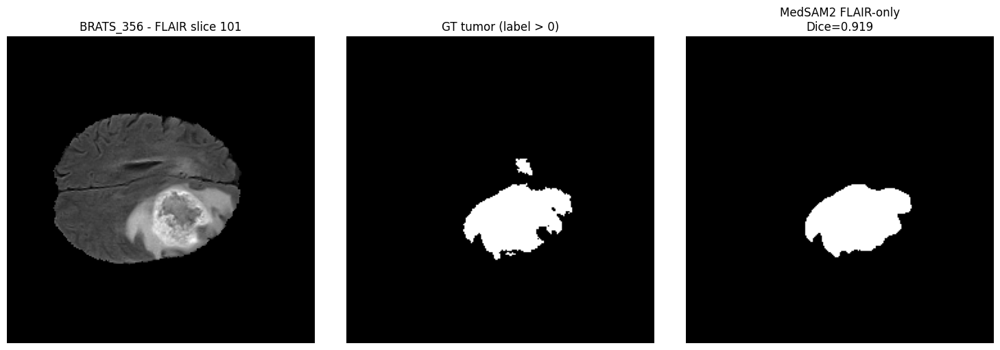

MedSAM2 FLAIR-only on BRATS test set:  51%|█████     | 49/97 [08:21<08:12, 10.25s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_356_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_413 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_413.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_413.nii.gz
  -> key_slice_idx: 86
  -> bbox [x_min, y_min, x_max, y_max]: [ 56  58  99 105]



propagate in video: 100%|██████████| 69/69 [00:01<00:00, 35.21it/s]

propagate in video: 100%|██████████| 87/87 [00:02<00:00, 35.64it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9067


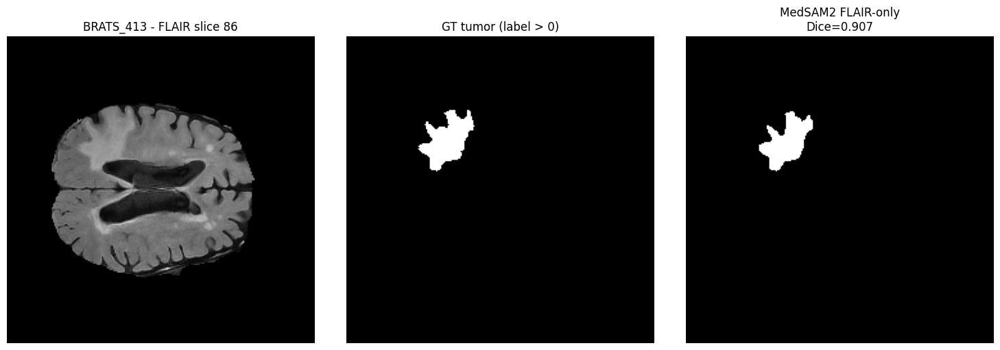

MedSAM2 FLAIR-only on BRATS test set:  52%|█████▏    | 50/97 [08:31<08:05, 10.34s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_413_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_175 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_175.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_175.nii.gz
  -> key_slice_idx: 52
  -> bbox [x_min, y_min, x_max, y_max]: [102 162 142 176]



propagate in video: 100%|██████████| 103/103 [00:02<00:00, 34.57it/s]

propagate in video: 100%|██████████| 53/53 [00:01<00:00, 35.29it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8370


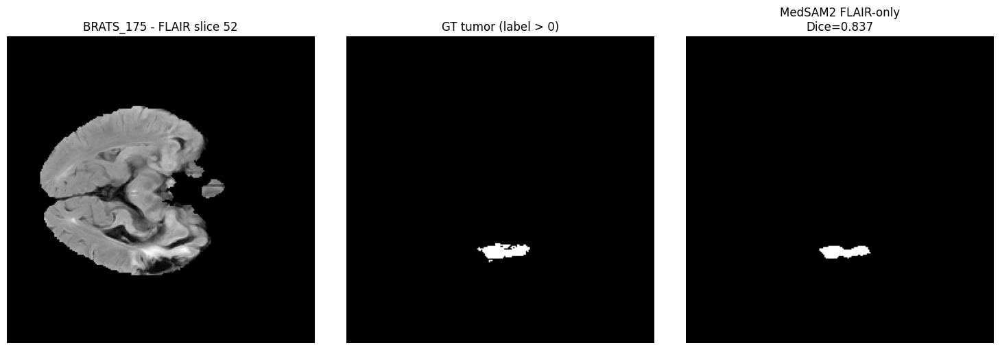

MedSAM2 FLAIR-only on BRATS test set:  53%|█████▎    | 51/97 [08:41<07:46, 10.14s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_175_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_074 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_074.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_074.nii.gz
  -> key_slice_idx: 77
  -> bbox [x_min, y_min, x_max, y_max]: [ 62 118 173 178]



propagate in video: 100%|██████████| 78/78 [00:02<00:00, 35.73it/s]

propagate in video: 100%|██████████| 78/78 [00:02<00:00, 34.71it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.7999


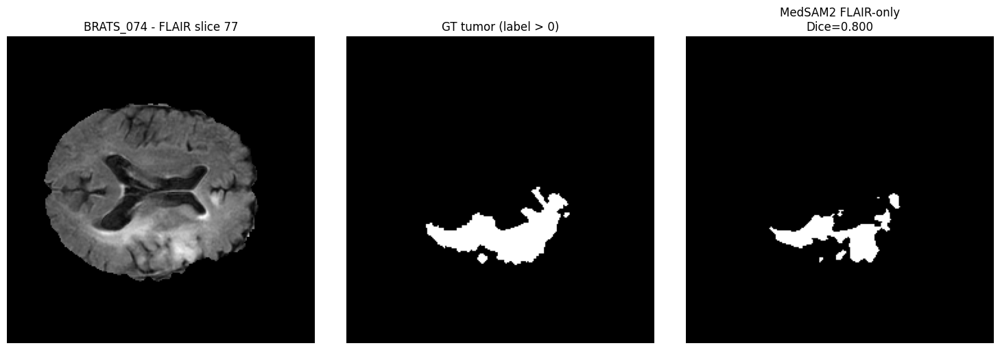

MedSAM2 FLAIR-only on BRATS test set:  54%|█████▎    | 52/97 [08:51<07:33, 10.09s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_074_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_387 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_387.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_387.nii.gz
  -> key_slice_idx: 76
  -> bbox [x_min, y_min, x_max, y_max]: [ 37 105 133 173]



propagate in video: 100%|██████████| 79/79 [00:02<00:00, 35.50it/s]

propagate in video: 100%|██████████| 77/77 [00:02<00:00, 35.42it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8919


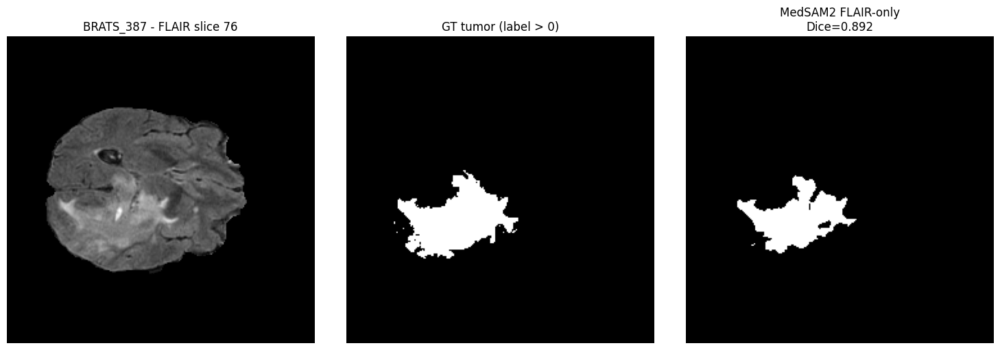

MedSAM2 FLAIR-only on BRATS test set:  55%|█████▍    | 53/97 [09:01<07:25, 10.13s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_387_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_017 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_017.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_017.nii.gz
  -> key_slice_idx: 68
  -> bbox [x_min, y_min, x_max, y_max]: [ 64 137 147 185]



propagate in video: 100%|██████████| 87/87 [00:02<00:00, 35.20it/s]

propagate in video: 100%|██████████| 69/69 [00:01<00:00, 35.80it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8993


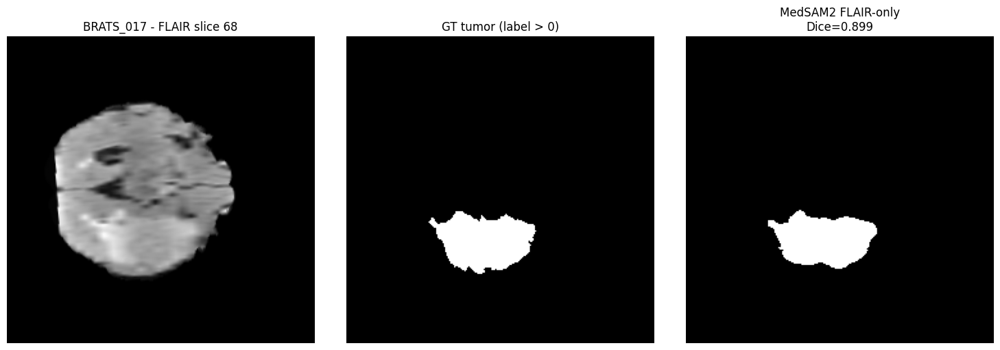

MedSAM2 FLAIR-only on BRATS test set:  56%|█████▌    | 54/97 [09:11<07:14, 10.11s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_017_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_263 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_263.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_263.nii.gz
  -> key_slice_idx: 64
  -> bbox [x_min, y_min, x_max, y_max]: [ 61  55 148 122]



propagate in video: 100%|██████████| 91/91 [00:02<00:00, 35.58it/s]

propagate in video: 100%|██████████| 65/65 [00:01<00:00, 35.58it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9134


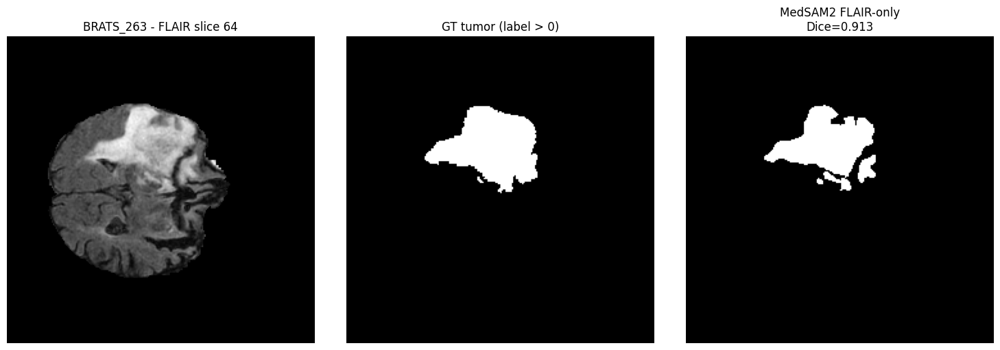

MedSAM2 FLAIR-only on BRATS test set:  57%|█████▋    | 55/97 [09:22<07:09, 10.23s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_263_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_183 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_183.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_183.nii.gz
  -> key_slice_idx: 105
  -> bbox [x_min, y_min, x_max, y_max]: [126 131 157 155]



propagate in video: 100%|██████████| 50/50 [00:01<00:00, 35.50it/s]

propagate in video: 100%|██████████| 106/106 [00:03<00:00, 35.16it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.7525


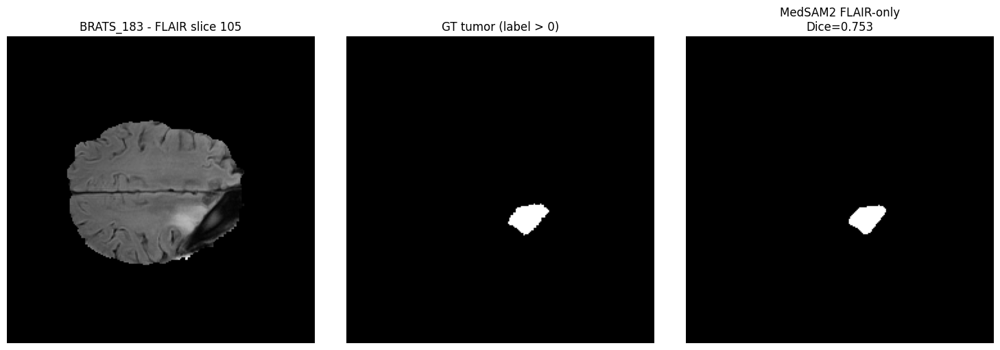

MedSAM2 FLAIR-only on BRATS test set:  58%|█████▊    | 56/97 [09:32<07:04, 10.35s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_183_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_327 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_327.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_327.nii.gz
  -> key_slice_idx: 100
  -> bbox [x_min, y_min, x_max, y_max]: [ 83 125 158 182]



propagate in video: 100%|██████████| 55/55 [00:01<00:00, 34.77it/s]

propagate in video: 100%|██████████| 101/101 [00:02<00:00, 35.13it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9518


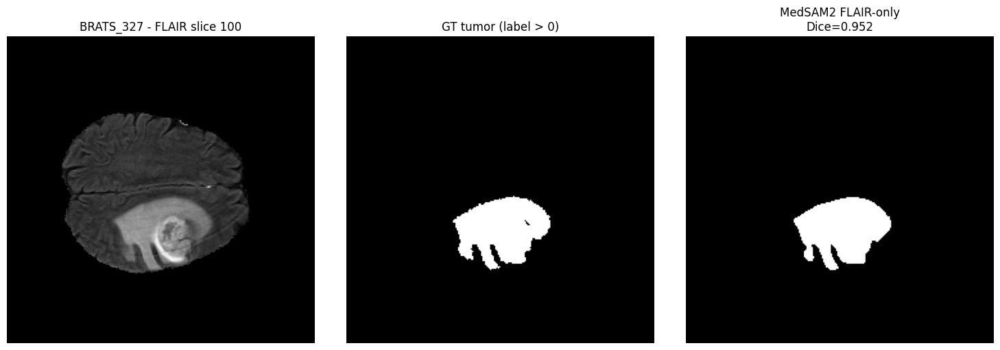

MedSAM2 FLAIR-only on BRATS test set:  59%|█████▉    | 57/97 [09:43<06:55, 10.38s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_327_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_465 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_465.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_465.nii.gz
  -> key_slice_idx: 86
  -> bbox [x_min, y_min, x_max, y_max]: [127 101 191 170]



propagate in video: 100%|██████████| 69/69 [00:01<00:00, 34.69it/s]

propagate in video: 100%|██████████| 87/87 [00:02<00:00, 34.09it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9114


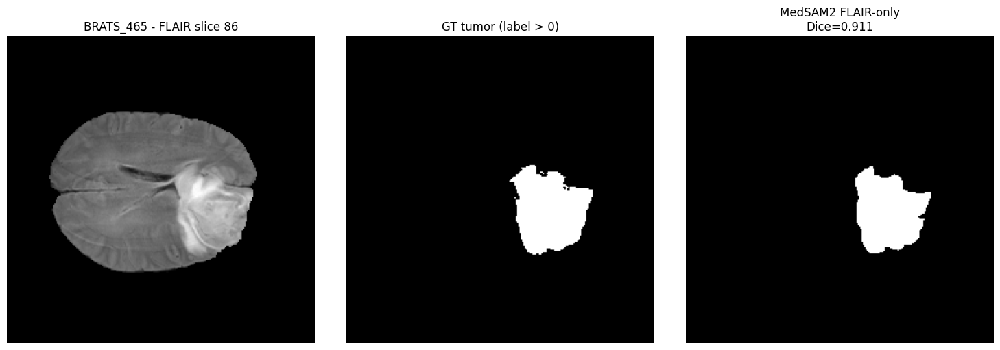

MedSAM2 FLAIR-only on BRATS test set:  60%|█████▉    | 58/97 [09:53<06:46, 10.41s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_465_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_181 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_181.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_181.nii.gz
  -> key_slice_idx: 93
  -> bbox [x_min, y_min, x_max, y_max]: [ 71 111 181 182]



propagate in video: 100%|██████████| 62/62 [00:01<00:00, 34.51it/s]

propagate in video: 100%|██████████| 94/94 [00:02<00:00, 34.02it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9296


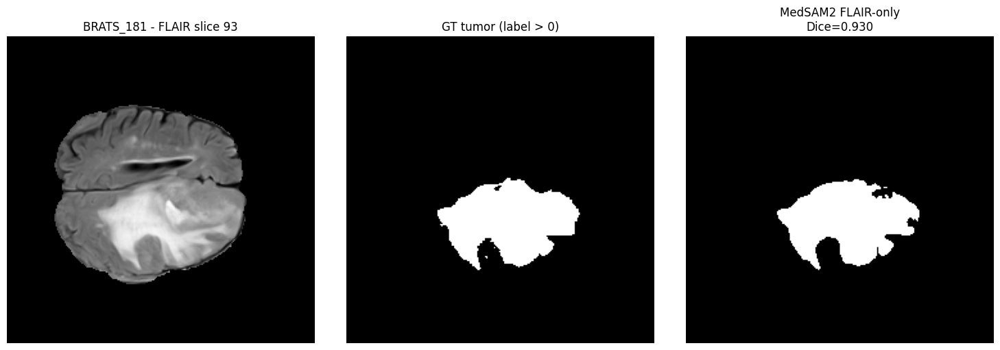

MedSAM2 FLAIR-only on BRATS test set:  61%|██████    | 59/97 [10:04<06:40, 10.55s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_181_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_178 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_178.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_178.nii.gz
  -> key_slice_idx: 66
  -> bbox [x_min, y_min, x_max, y_max]: [ 66 152 149 180]



propagate in video: 100%|██████████| 89/89 [00:02<00:00, 35.45it/s]

propagate in video: 100%|██████████| 67/67 [00:01<00:00, 35.83it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.7379


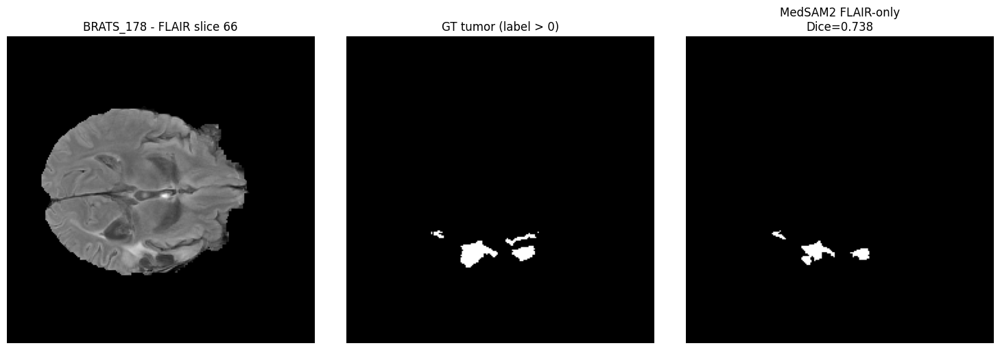

MedSAM2 FLAIR-only on BRATS test set:  62%|██████▏   | 60/97 [10:14<06:24, 10.39s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_178_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_042 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_042.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_042.nii.gz
  -> key_slice_idx: 94
  -> bbox [x_min, y_min, x_max, y_max]: [107 134 134 138]



propagate in video: 100%|██████████| 61/61 [00:01<00:00, 34.92it/s]

propagate in video: 100%|██████████| 95/95 [00:02<00:00, 34.56it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.7853


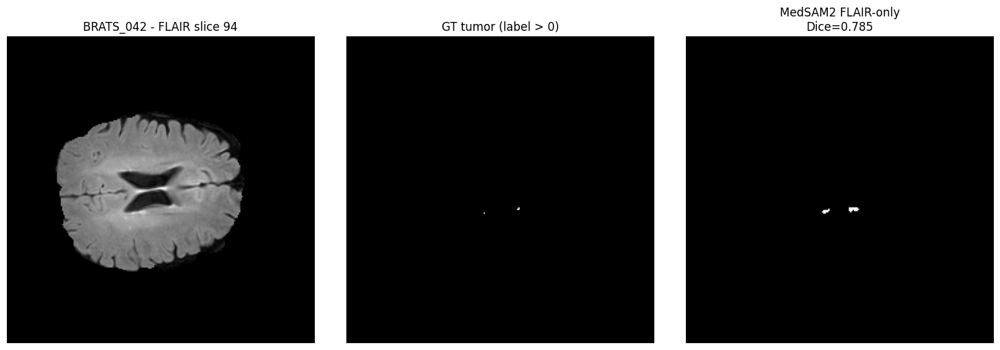

MedSAM2 FLAIR-only on BRATS test set:  63%|██████▎   | 61/97 [10:25<06:23, 10.66s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_042_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_065 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_065.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_065.nii.gz
  -> key_slice_idx: 78
  -> bbox [x_min, y_min, x_max, y_max]: [104 123 170 178]



propagate in video: 100%|██████████| 77/77 [00:02<00:00, 35.33it/s]

propagate in video: 100%|██████████| 79/79 [00:02<00:00, 35.51it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8543


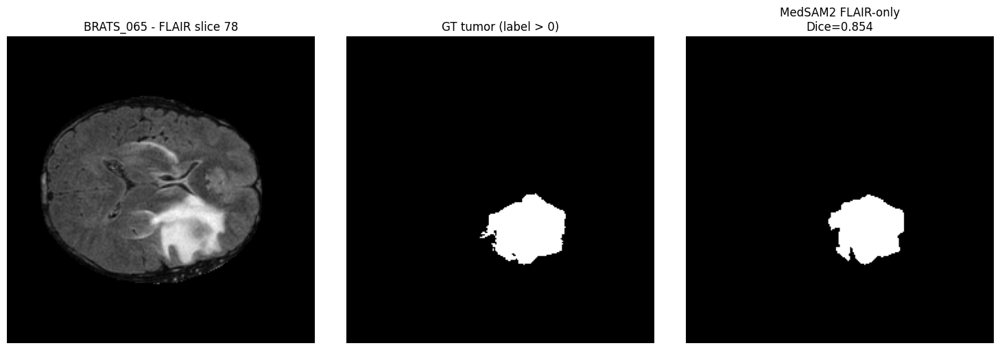

MedSAM2 FLAIR-only on BRATS test set:  64%|██████▍   | 62/97 [10:36<06:13, 10.68s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_065_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_380 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_380.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_380.nii.gz
  -> key_slice_idx: 47
  -> bbox [x_min, y_min, x_max, y_max]: [ 85 160 143 188]



propagate in video: 100%|██████████| 108/108 [00:03<00:00, 35.14it/s]

propagate in video: 100%|██████████| 48/48 [00:01<00:00, 35.02it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8184


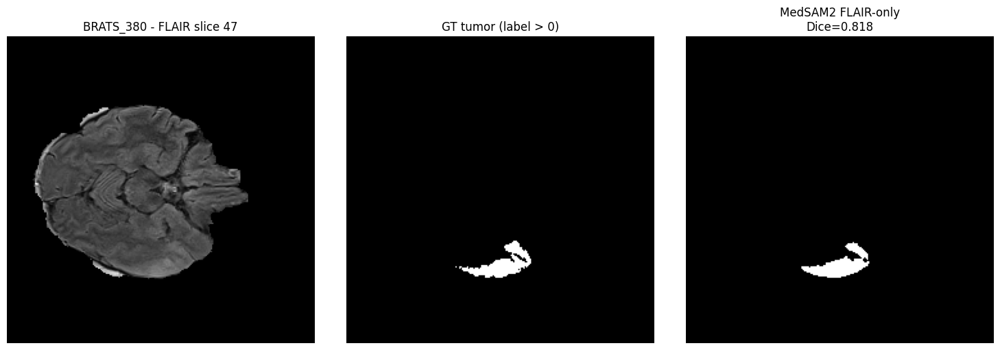

MedSAM2 FLAIR-only on BRATS test set:  65%|██████▍   | 63/97 [10:47<06:05, 10.74s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_380_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_079 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_079.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_079.nii.gz
  -> key_slice_idx: 63
  -> bbox [x_min, y_min, x_max, y_max]: [ 70  59 146 106]



propagate in video: 100%|██████████| 92/92 [00:02<00:00, 35.16it/s]

propagate in video: 100%|██████████| 64/64 [00:01<00:00, 35.43it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8677


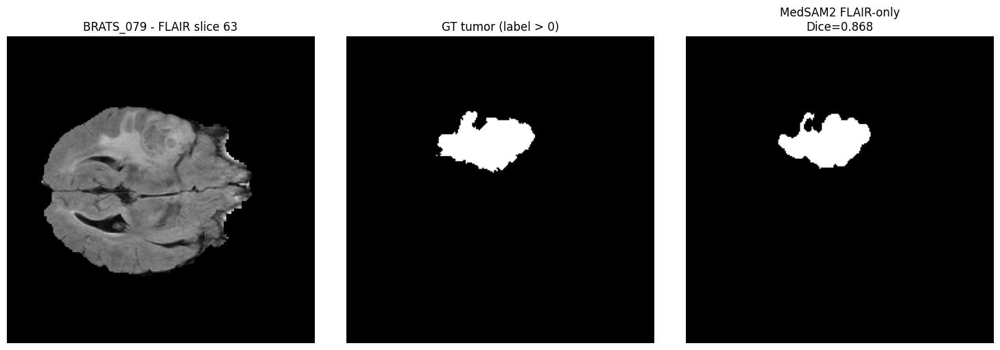

MedSAM2 FLAIR-only on BRATS test set:  66%|██████▌   | 64/97 [10:57<05:48, 10.55s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_079_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_473 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_473.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_473.nii.gz
  -> key_slice_idx: 68
  -> bbox [x_min, y_min, x_max, y_max]: [ 93 136 140 173]



propagate in video: 100%|██████████| 87/87 [00:02<00:00, 34.40it/s]

propagate in video: 100%|██████████| 69/69 [00:01<00:00, 35.13it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8618


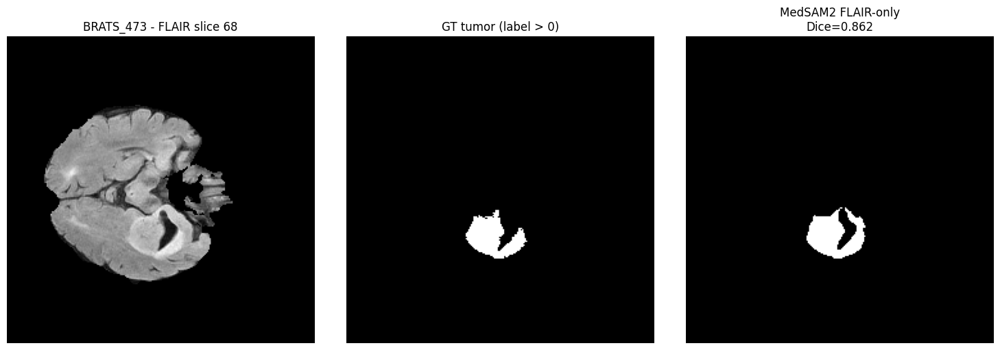

MedSAM2 FLAIR-only on BRATS test set:  67%|██████▋   | 65/97 [11:08<05:39, 10.61s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_473_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_401 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_401.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_401.nii.gz
  -> key_slice_idx: 58
  -> bbox [x_min, y_min, x_max, y_max]: [110 137 152 177]



propagate in video: 100%|██████████| 97/97 [00:02<00:00, 35.05it/s]

propagate in video: 100%|██████████| 59/59 [00:01<00:00, 34.95it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9494


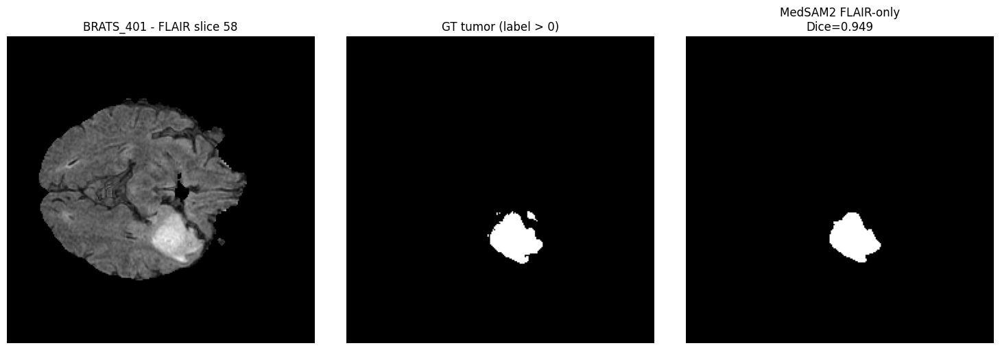

MedSAM2 FLAIR-only on BRATS test set:  68%|██████▊   | 66/97 [11:19<05:31, 10.70s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_401_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_475 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_475.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_475.nii.gz
  -> key_slice_idx: 94
  -> bbox [x_min, y_min, x_max, y_max]: [ 96  99 188 175]



propagate in video: 100%|██████████| 61/61 [00:01<00:00, 35.38it/s]

propagate in video: 100%|██████████| 95/95 [00:02<00:00, 35.37it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9357


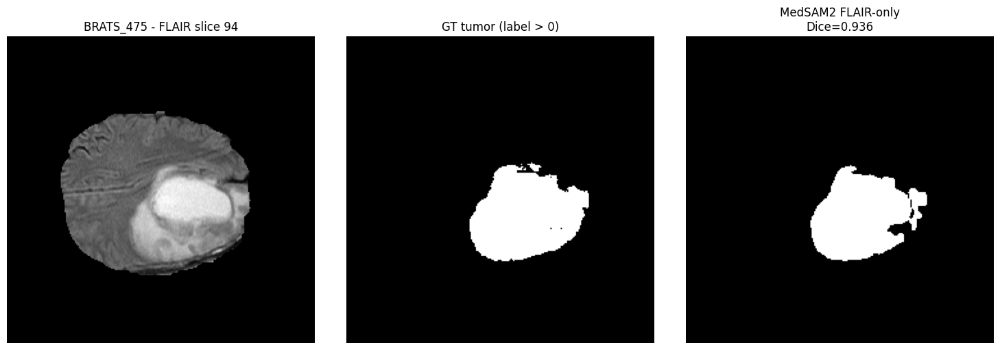

MedSAM2 FLAIR-only on BRATS test set:  69%|██████▉   | 67/97 [11:29<05:20, 10.70s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_475_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_094 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_094.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_094.nii.gz
  -> key_slice_idx: 73
  -> bbox [x_min, y_min, x_max, y_max]: [ 52 129 141 187]



propagate in video: 100%|██████████| 82/82 [00:02<00:00, 35.39it/s]

propagate in video: 100%|██████████| 74/74 [00:02<00:00, 35.50it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9136


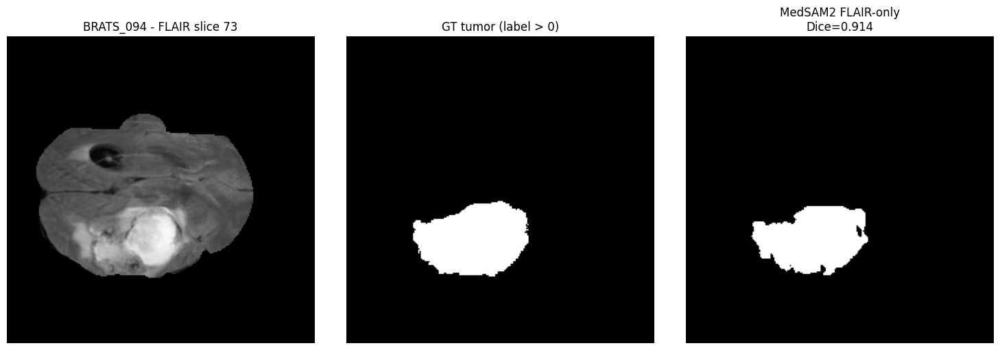

MedSAM2 FLAIR-only on BRATS test set:  70%|███████   | 68/97 [11:40<05:05, 10.55s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_094_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_063 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_063.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_063.nii.gz
  -> key_slice_idx: 66
  -> bbox [x_min, y_min, x_max, y_max]: [ 70  62 151 119]



propagate in video: 100%|██████████| 89/89 [00:02<00:00, 35.73it/s]

propagate in video: 100%|██████████| 67/67 [00:01<00:00, 35.23it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9351


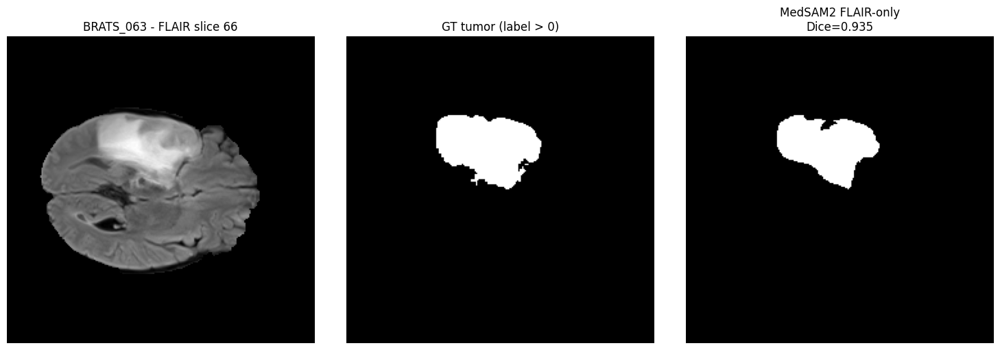

MedSAM2 FLAIR-only on BRATS test set:  71%|███████   | 69/97 [11:50<04:51, 10.41s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_063_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_083 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_083.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_083.nii.gz
  -> key_slice_idx: 88
  -> bbox [x_min, y_min, x_max, y_max]: [110 116 172 165]



propagate in video: 100%|██████████| 67/67 [00:01<00:00, 35.97it/s]

propagate in video: 100%|██████████| 89/89 [00:02<00:00, 35.49it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8906


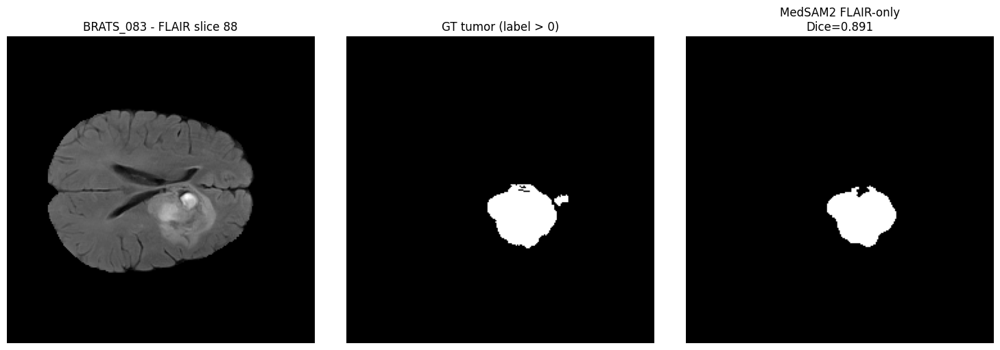

MedSAM2 FLAIR-only on BRATS test set:  72%|███████▏  | 70/97 [11:59<04:36, 10.22s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_083_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_225 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_225.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_225.nii.gz
  -> key_slice_idx: 86
  -> bbox [x_min, y_min, x_max, y_max]: [ 42 126 129 179]



propagate in video: 100%|██████████| 69/69 [00:01<00:00, 35.20it/s]

propagate in video: 100%|██████████| 87/87 [00:02<00:00, 35.70it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8723


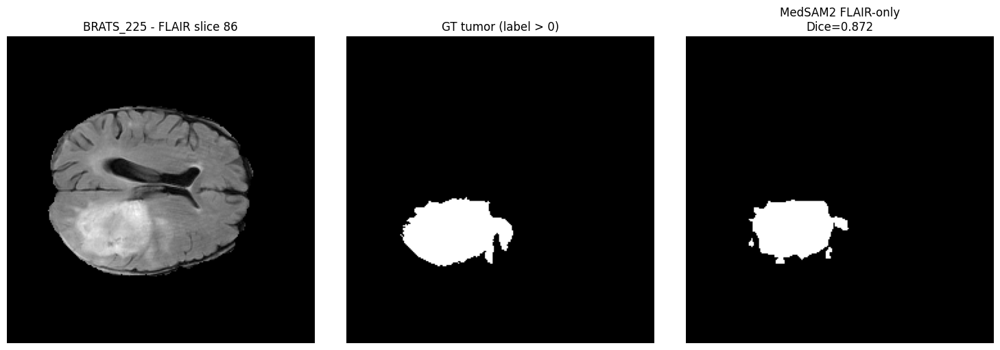

MedSAM2 FLAIR-only on BRATS test set:  73%|███████▎  | 71/97 [12:11<04:33, 10.51s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_225_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_319 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_319.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_319.nii.gz
  -> key_slice_idx: 104
  -> bbox [x_min, y_min, x_max, y_max]: [ 80  72 145 163]



propagate in video: 100%|██████████| 51/51 [00:01<00:00, 35.65it/s]

propagate in video: 100%|██████████| 105/105 [00:02<00:00, 35.78it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9200


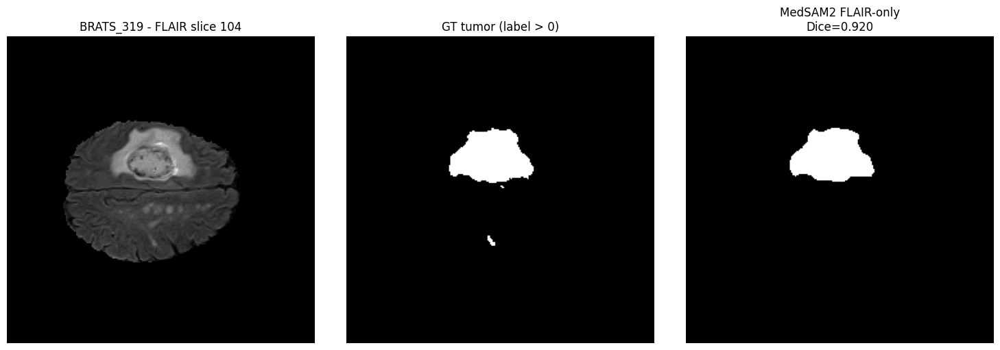

MedSAM2 FLAIR-only on BRATS test set:  74%|███████▍  | 72/97 [12:21<04:21, 10.44s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_319_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_026 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_026.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_026.nii.gz
  -> key_slice_idx: 81
  -> bbox [x_min, y_min, x_max, y_max]: [ 88  69 145 108]



propagate in video: 100%|██████████| 74/74 [00:02<00:00, 35.44it/s]

propagate in video: 100%|██████████| 82/82 [00:02<00:00, 35.34it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9351


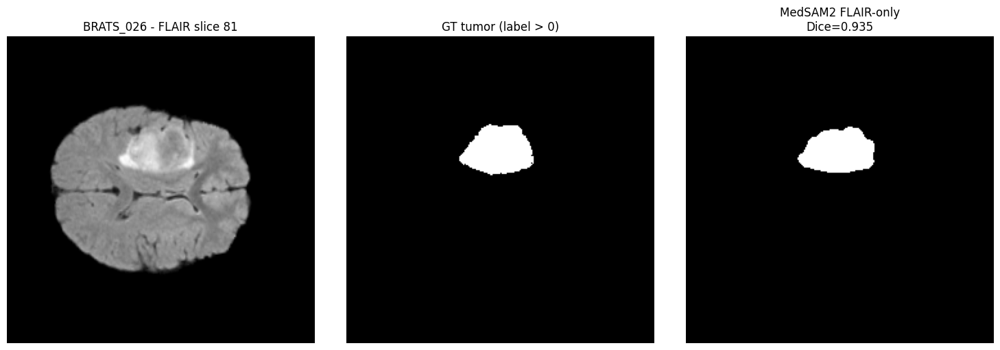

MedSAM2 FLAIR-only on BRATS test set:  75%|███████▌  | 73/97 [12:31<04:06, 10.28s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_026_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_106 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_106.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_106.nii.gz
  -> key_slice_idx: 73
  -> bbox [x_min, y_min, x_max, y_max]: [ 56 106 194 165]



propagate in video: 100%|██████████| 82/82 [00:02<00:00, 35.77it/s]

propagate in video: 100%|██████████| 74/74 [00:02<00:00, 35.19it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.5561


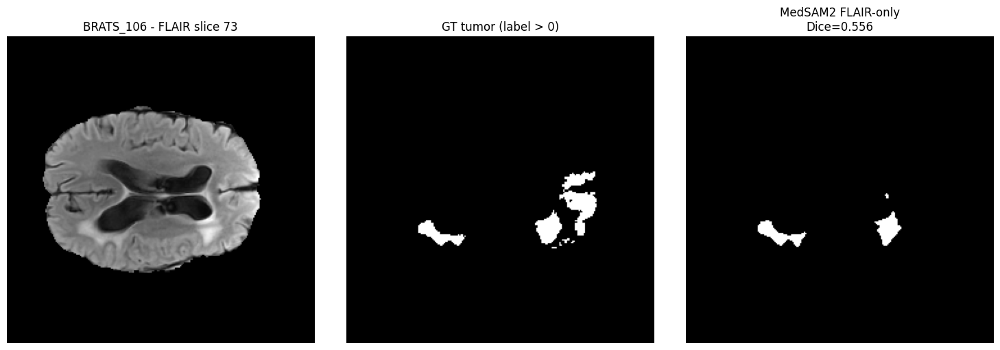

MedSAM2 FLAIR-only on BRATS test set:  76%|███████▋  | 74/97 [12:42<04:04, 10.62s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_106_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_151 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_151.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_151.nii.gz
  -> key_slice_idx: 87
  -> bbox [x_min, y_min, x_max, y_max]: [ 60  60 168 135]



propagate in video: 100%|██████████| 68/68 [00:01<00:00, 35.80it/s]

propagate in video: 100%|██████████| 88/88 [00:02<00:00, 35.85it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.7369


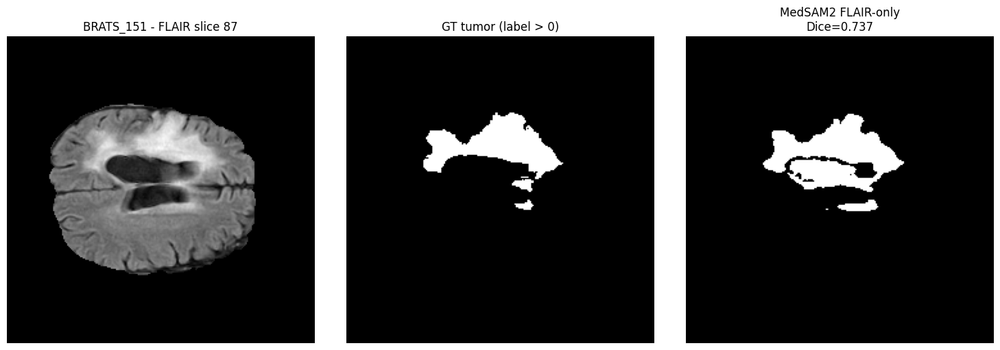

MedSAM2 FLAIR-only on BRATS test set:  77%|███████▋  | 75/97 [12:52<03:50, 10.47s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_151_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_333 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_333.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_333.nii.gz
  -> key_slice_idx: 83
  -> bbox [x_min, y_min, x_max, y_max]: [ 65  64 111 113]



propagate in video: 100%|██████████| 72/72 [00:02<00:00, 35.41it/s]

propagate in video: 100%|██████████| 84/84 [00:02<00:00, 35.79it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9284


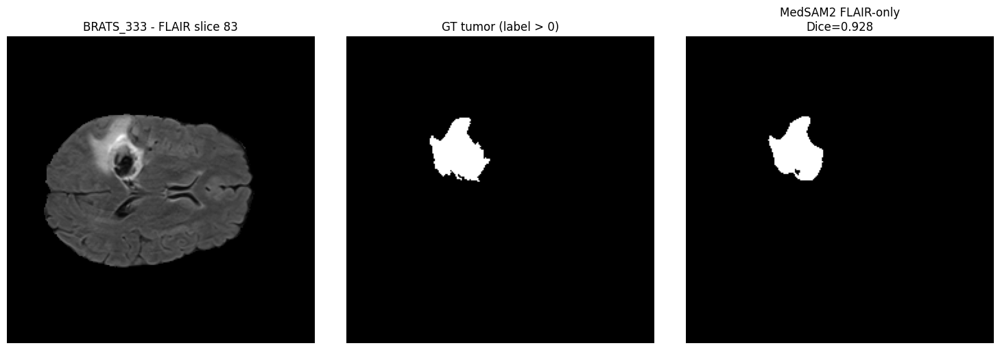

MedSAM2 FLAIR-only on BRATS test set:  78%|███████▊  | 76/97 [13:03<03:41, 10.57s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_333_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_390 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_390.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_390.nii.gz
  -> key_slice_idx: 100
  -> bbox [x_min, y_min, x_max, y_max]: [ 77 137 119 171]



propagate in video: 100%|██████████| 55/55 [00:01<00:00, 35.80it/s]

propagate in video: 100%|██████████| 101/101 [00:02<00:00, 35.62it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8835


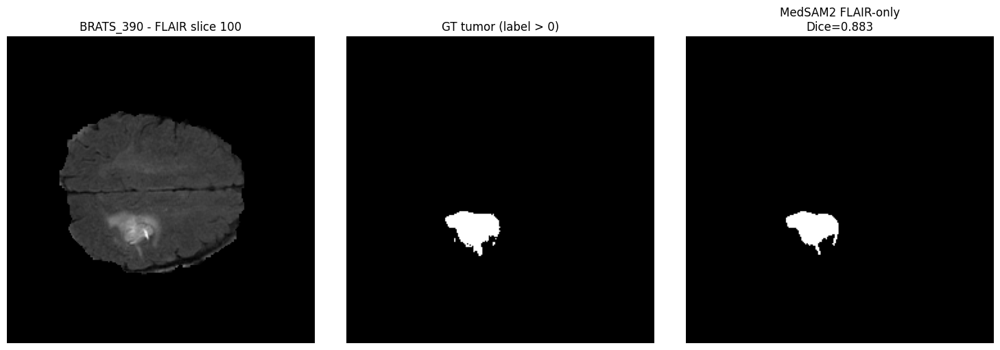

MedSAM2 FLAIR-only on BRATS test set:  79%|███████▉  | 77/97 [13:14<03:32, 10.61s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_390_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_160 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_160.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_160.nii.gz
  -> key_slice_idx: 62
  -> bbox [x_min, y_min, x_max, y_max]: [ 98 154 147 186]



propagate in video: 100%|██████████| 93/93 [00:02<00:00, 35.85it/s]

propagate in video: 100%|██████████| 63/63 [00:01<00:00, 34.89it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.6582


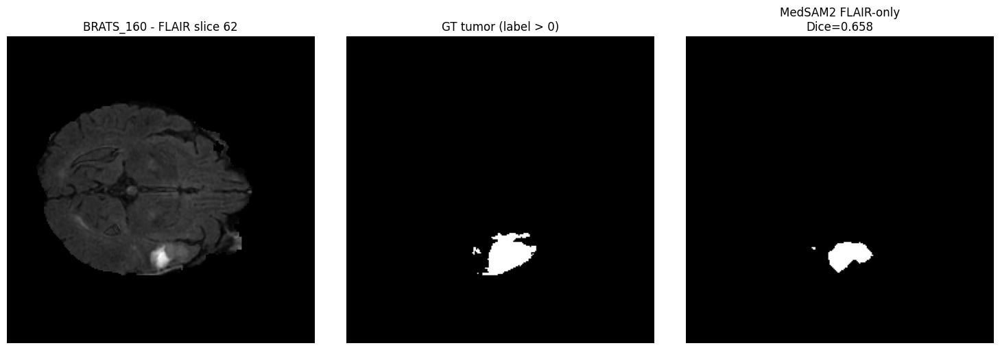

MedSAM2 FLAIR-only on BRATS test set:  80%|████████  | 78/97 [13:24<03:18, 10.44s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_160_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_347 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_347.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_347.nii.gz
  -> key_slice_idx: 86
  -> bbox [x_min, y_min, x_max, y_max]: [ 49 129 124 186]



propagate in video: 100%|██████████| 69/69 [00:01<00:00, 35.28it/s]

propagate in video: 100%|██████████| 87/87 [00:02<00:00, 35.09it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9470


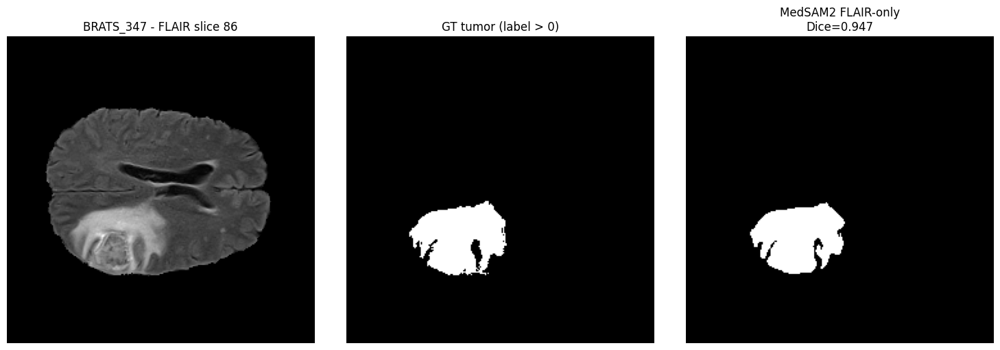

MedSAM2 FLAIR-only on BRATS test set:  81%|████████▏ | 79/97 [13:34<03:07, 10.41s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_347_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_141 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_141.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_141.nii.gz
  -> key_slice_idx: 79
  -> bbox [x_min, y_min, x_max, y_max]: [ 36 109 162 178]



propagate in video: 100%|██████████| 76/76 [00:02<00:00, 35.21it/s]

propagate in video: 100%|██████████| 80/80 [00:02<00:00, 34.88it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.6024


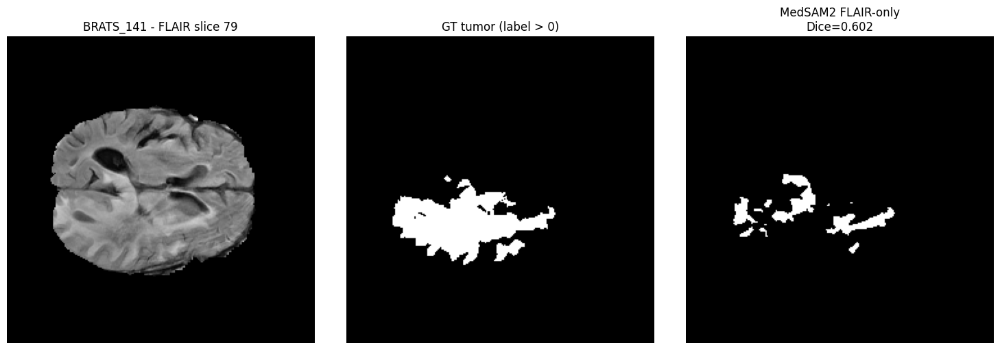

MedSAM2 FLAIR-only on BRATS test set:  82%|████████▏ | 80/97 [13:44<02:55, 10.34s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_141_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_436 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_436.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_436.nii.gz
  -> key_slice_idx: 66
  -> bbox [x_min, y_min, x_max, y_max]: [ 59  65 111 103]



propagate in video: 100%|██████████| 89/89 [00:02<00:00, 35.76it/s]

propagate in video: 100%|██████████| 67/67 [00:01<00:00, 35.17it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9353


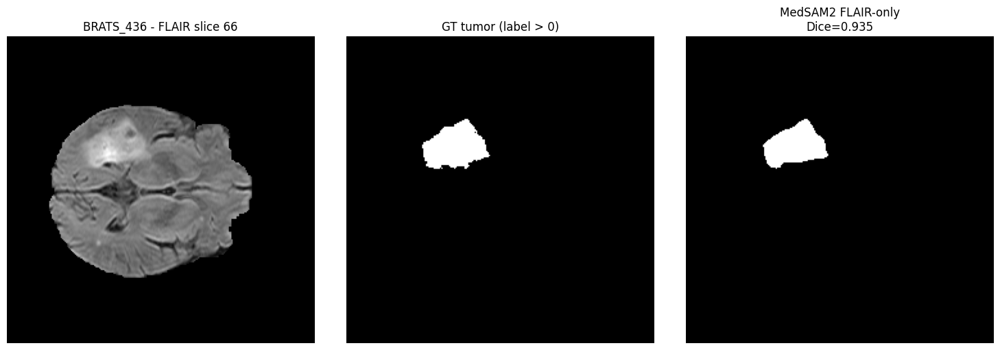

MedSAM2 FLAIR-only on BRATS test set:  84%|████████▎ | 81/97 [13:55<02:44, 10.30s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_436_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_262 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_262.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_262.nii.gz
  -> key_slice_idx: 78
  -> bbox [x_min, y_min, x_max, y_max]: [59 54 93 86]



propagate in video: 100%|██████████| 77/77 [00:02<00:00, 35.30it/s]

propagate in video: 100%|██████████| 79/79 [00:02<00:00, 35.22it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8829


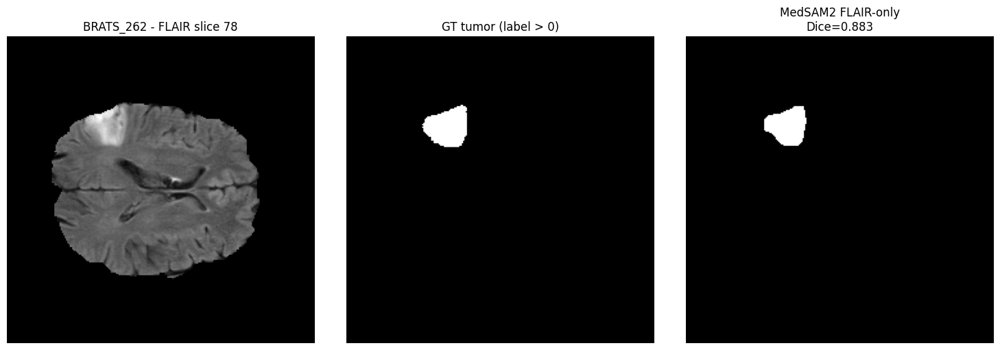

MedSAM2 FLAIR-only on BRATS test set:  85%|████████▍ | 82/97 [14:05<02:34, 10.28s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_262_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_115 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_115.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_115.nii.gz
  -> key_slice_idx: 57
  -> bbox [x_min, y_min, x_max, y_max]: [ 88  58 153 118]



propagate in video: 100%|██████████| 98/98 [00:02<00:00, 35.75it/s]

propagate in video: 100%|██████████| 58/58 [00:01<00:00, 35.22it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8809


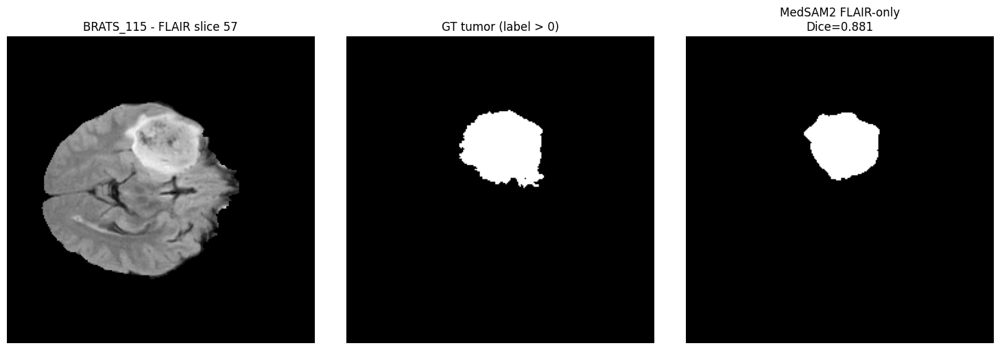

MedSAM2 FLAIR-only on BRATS test set:  86%|████████▌ | 83/97 [14:15<02:23, 10.28s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_115_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_431 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_431.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_431.nii.gz
  -> key_slice_idx: 66
  -> bbox [x_min, y_min, x_max, y_max]: [ 60 117 148 186]



propagate in video: 100%|██████████| 89/89 [00:02<00:00, 35.43it/s]

propagate in video: 100%|██████████| 67/67 [00:01<00:00, 36.39it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8807


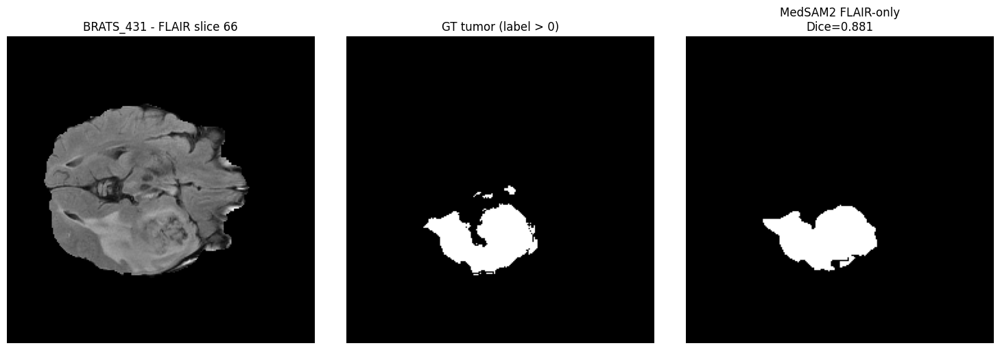

MedSAM2 FLAIR-only on BRATS test set:  87%|████████▋ | 84/97 [14:25<02:11, 10.12s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_431_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_309 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_309.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_309.nii.gz
  -> key_slice_idx: 76
  -> bbox [x_min, y_min, x_max, y_max]: [ 72  59 158 113]



propagate in video: 100%|██████████| 79/79 [00:02<00:00, 35.06it/s]

propagate in video: 100%|██████████| 77/77 [00:02<00:00, 36.37it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9382


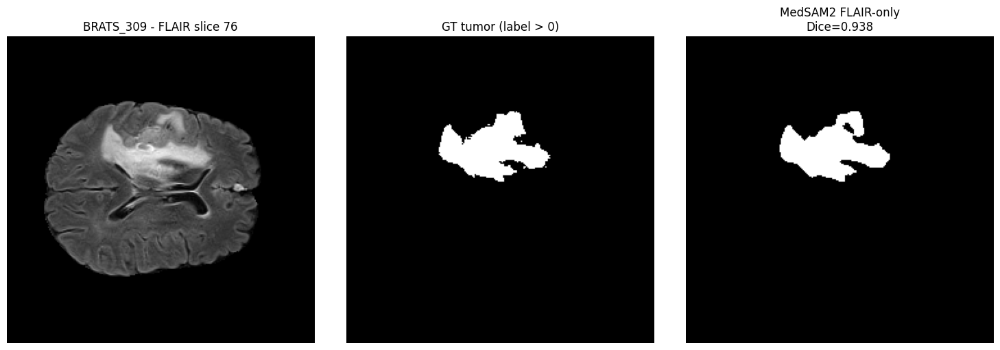

MedSAM2 FLAIR-only on BRATS test set:  88%|████████▊ | 85/97 [14:35<02:02, 10.20s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_309_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_202 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_202.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_202.nii.gz
  -> key_slice_idx: 74
  -> bbox [x_min, y_min, x_max, y_max]: [ 72 109 173 184]



propagate in video: 100%|██████████| 81/81 [00:02<00:00, 35.62it/s]

propagate in video: 100%|██████████| 75/75 [00:02<00:00, 35.26it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9424


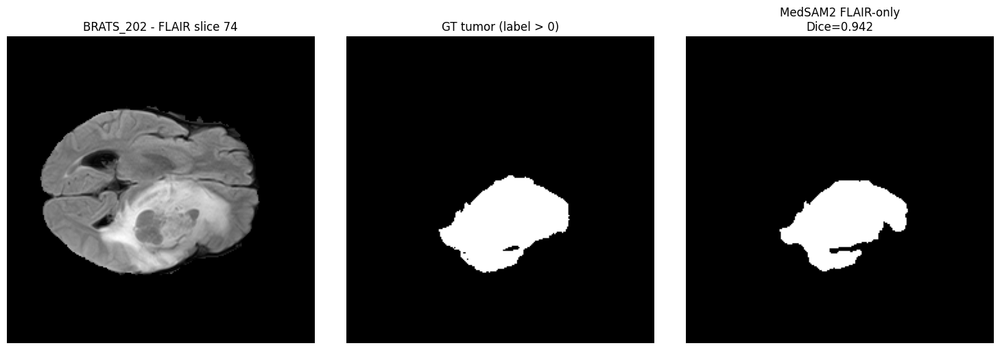

MedSAM2 FLAIR-only on BRATS test set:  89%|████████▊ | 86/97 [14:45<01:52, 10.22s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_202_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_082 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_082.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_082.nii.gz
  -> key_slice_idx: 67
  -> bbox [x_min, y_min, x_max, y_max]: [ 75  59 153 115]



propagate in video: 100%|██████████| 88/88 [00:02<00:00, 35.70it/s]

propagate in video: 100%|██████████| 68/68 [00:01<00:00, 35.83it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9321


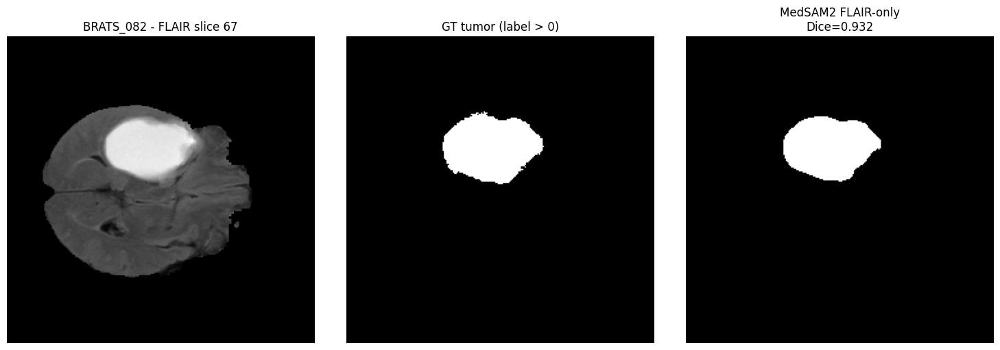

MedSAM2 FLAIR-only on BRATS test set:  90%|████████▉ | 87/97 [14:55<01:41, 10.13s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_082_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_097 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_097.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_097.nii.gz
  -> key_slice_idx: 85
  -> bbox [x_min, y_min, x_max, y_max]: [ 33 120 101 180]



propagate in video: 100%|██████████| 70/70 [00:01<00:00, 35.63it/s]

propagate in video: 100%|██████████| 86/86 [00:02<00:00, 35.14it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9374


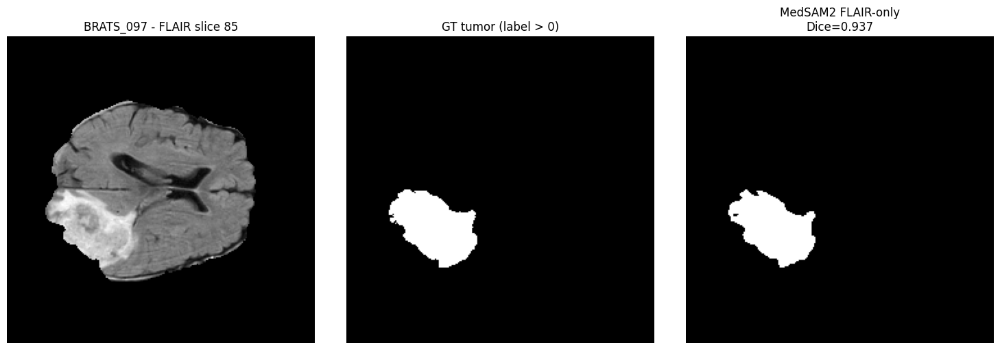

MedSAM2 FLAIR-only on BRATS test set:  91%|█████████ | 88/97 [15:06<01:31, 10.19s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_097_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_227 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_227.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_227.nii.gz
  -> key_slice_idx: 89
  -> bbox [x_min, y_min, x_max, y_max]: [ 91  68 165 141]



propagate in video: 100%|██████████| 66/66 [00:01<00:00, 35.68it/s]

propagate in video: 100%|██████████| 90/90 [00:02<00:00, 35.53it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8692


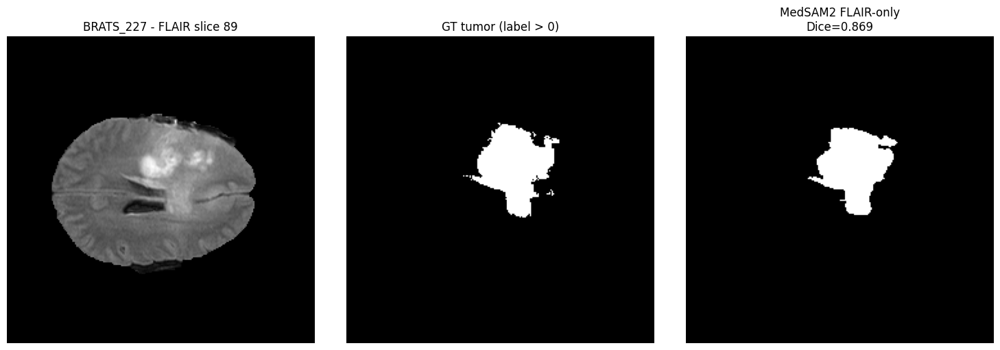

MedSAM2 FLAIR-only on BRATS test set:  92%|█████████▏| 89/97 [15:15<01:20, 10.05s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_227_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_195 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_195.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_195.nii.gz
  -> key_slice_idx: 96
  -> bbox [x_min, y_min, x_max, y_max]: [ 54  61 139 111]



propagate in video: 100%|██████████| 59/59 [00:01<00:00, 34.91it/s]

propagate in video: 100%|██████████| 97/97 [00:02<00:00, 35.69it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8857


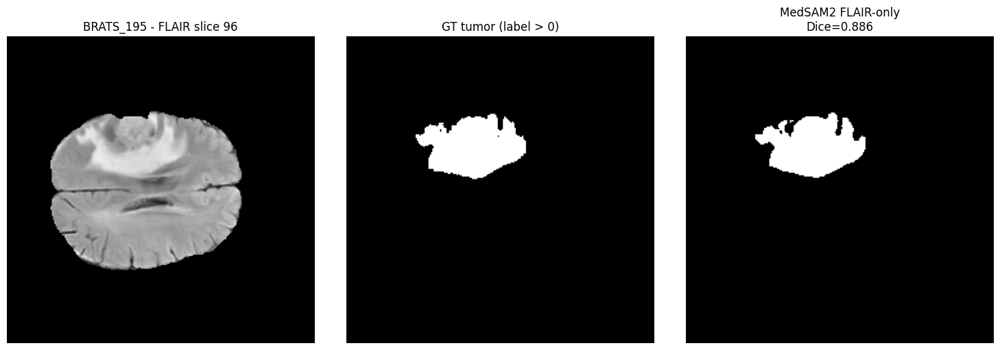

MedSAM2 FLAIR-only on BRATS test set:  93%|█████████▎| 90/97 [15:25<01:09,  9.92s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_195_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_334 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_334.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_334.nii.gz
  -> key_slice_idx: 65
  -> bbox [x_min, y_min, x_max, y_max]: [124  68 209 152]



propagate in video: 100%|██████████| 90/90 [00:02<00:00, 35.16it/s]

propagate in video: 100%|██████████| 66/66 [00:01<00:00, 36.23it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9298


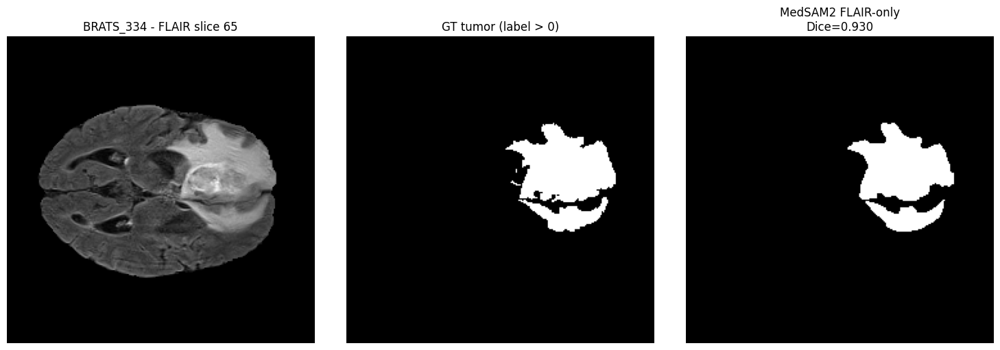

MedSAM2 FLAIR-only on BRATS test set:  94%|█████████▍| 91/97 [15:35<00:59,  9.94s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_334_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_152 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_152.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_152.nii.gz
  -> key_slice_idx: 85
  -> bbox [x_min, y_min, x_max, y_max]: [ 56  58 171 140]



propagate in video: 100%|██████████| 70/70 [00:01<00:00, 35.74it/s]

propagate in video: 100%|██████████| 86/86 [00:02<00:00, 35.17it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8430


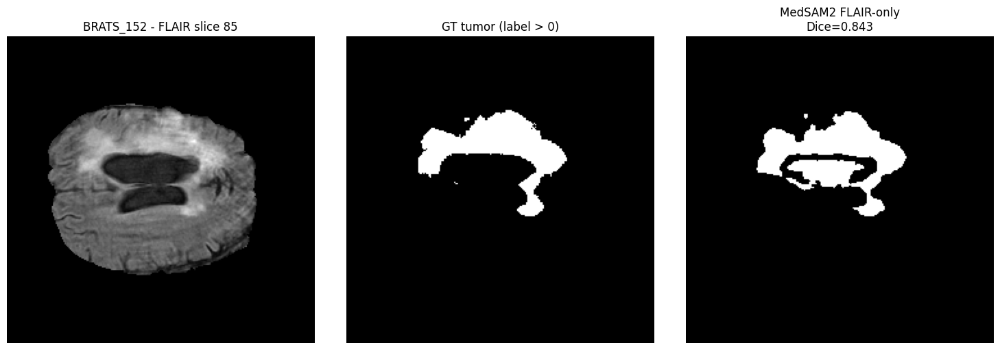

MedSAM2 FLAIR-only on BRATS test set:  95%|█████████▍| 92/97 [15:46<00:50, 10.10s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_152_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_379 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_379.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_379.nii.gz
  -> key_slice_idx: 102
  -> bbox [x_min, y_min, x_max, y_max]: [ 45  96  95 121]



propagate in video: 100%|██████████| 53/53 [00:01<00:00, 36.11it/s]

propagate in video: 100%|██████████| 103/103 [00:02<00:00, 35.48it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9151


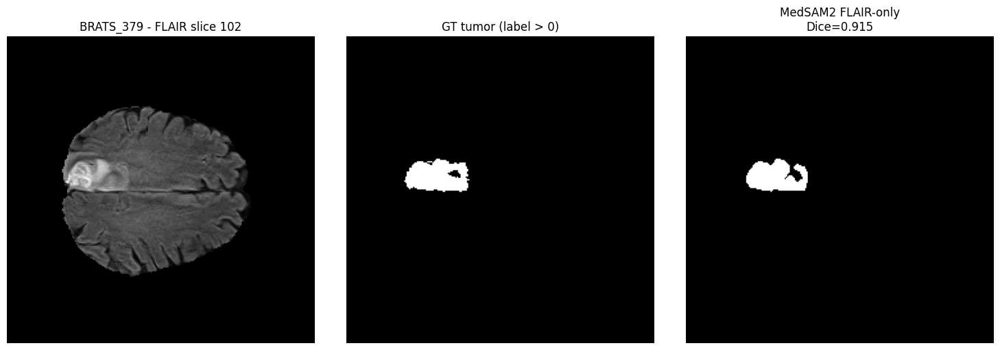

MedSAM2 FLAIR-only on BRATS test set:  96%|█████████▌| 93/97 [15:56<00:40, 10.23s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_379_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_411 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_411.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_411.nii.gz
  -> key_slice_idx: 76
  -> bbox [x_min, y_min, x_max, y_max]: [ 92  67 182 161]



propagate in video: 100%|██████████| 79/79 [00:02<00:00, 35.93it/s]

propagate in video: 100%|██████████| 77/77 [00:02<00:00, 36.24it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8940


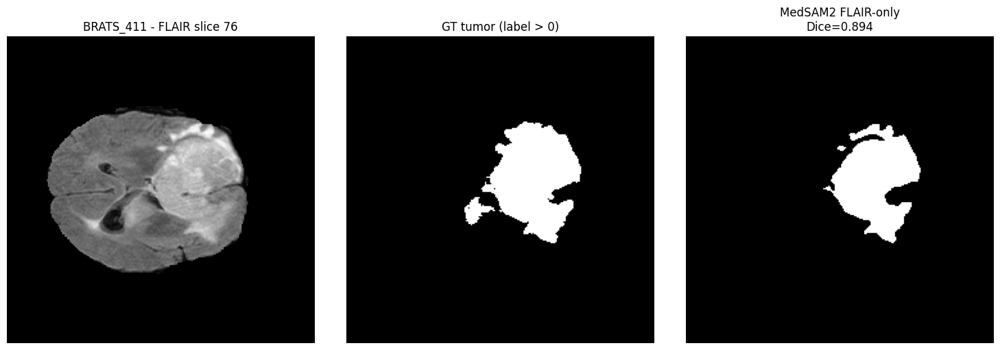

MedSAM2 FLAIR-only on BRATS test set:  97%|█████████▋| 94/97 [16:06<00:30, 10.21s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_411_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_118 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_118.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_118.nii.gz
  -> key_slice_idx: 92
  -> bbox [x_min, y_min, x_max, y_max]: [ 49 130 152 184]



propagate in video: 100%|██████████| 63/63 [00:01<00:00, 35.89it/s]

propagate in video: 100%|██████████| 93/93 [00:02<00:00, 35.58it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8549


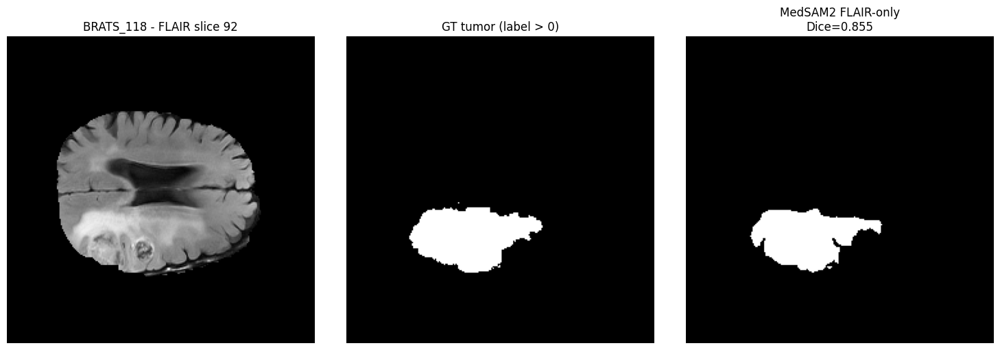

MedSAM2 FLAIR-only on BRATS test set:  98%|█████████▊| 95/97 [16:16<00:20, 10.12s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_118_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_028 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_028.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_028.nii.gz
  -> key_slice_idx: 57
  -> bbox [x_min, y_min, x_max, y_max]: [ 75  48 154  99]



propagate in video: 100%|██████████| 98/98 [00:02<00:00, 35.64it/s]

propagate in video: 100%|██████████| 58/58 [00:01<00:00, 36.16it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.8569


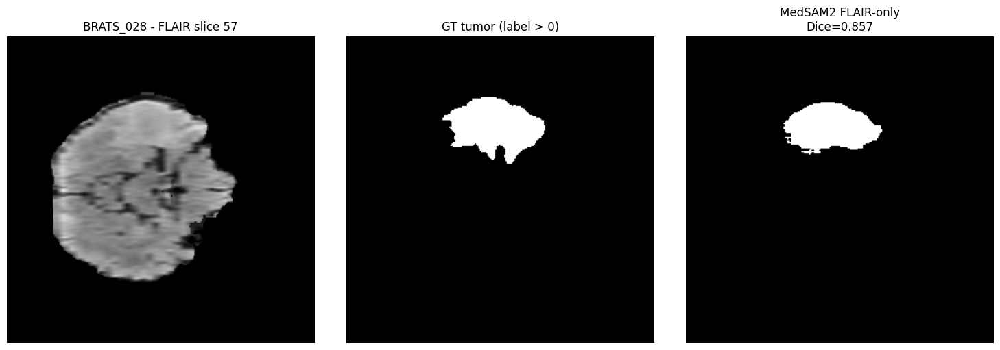

MedSAM2 FLAIR-only on BRATS test set:  99%|█████████▉| 96/97 [16:27<00:10, 10.21s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_028_MedSAM2_FLAIR_mask.nii.gz

=== Processing case: BRATS_455 ===
 Image: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/imagesTr/BRATS_455.nii.gz
 Label: /content/drive/MyDrive/Task01_BrainTumour_extracted/Task01_BrainTumour/labelsTr/BRATS_455.nii.gz
  -> key_slice_idx: 67
  -> bbox [x_min, y_min, x_max, y_max]: [ 78 107 162 184]



propagate in video: 100%|██████████| 88/88 [00:02<00:00, 35.59it/s]

propagate in video: 100%|██████████| 68/68 [00:01<00:00, 35.85it/s]


  -> prediction shape: (155, 240, 240)
  -> Dice (whole tumor, FLAIR-only): 0.9266


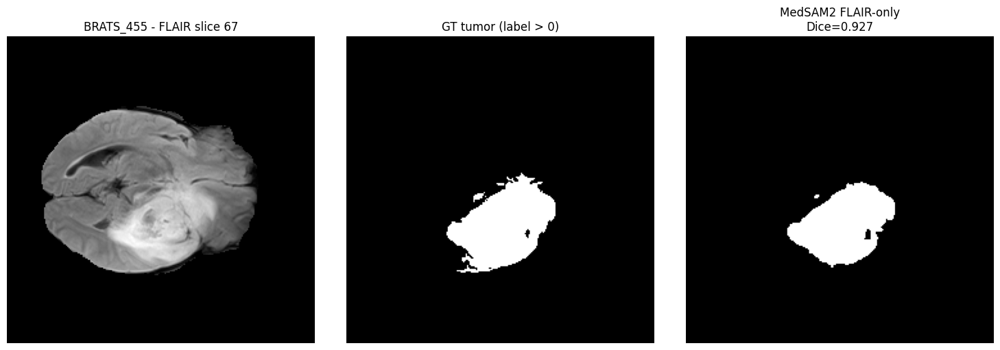

MedSAM2 FLAIR-only on BRATS test set: 100%|██████████| 97/97 [16:37<00:00, 10.29s/it]

Saved: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/BRATS_455_MedSAM2_FLAIR_mask.nii.gz

✅ Finished MedSAM2 FLAIR-only on all test cases.
Total cases processed: 97
Saved results CSV: /content/drive/MyDrive/MedSAM2_BRATS_FLAIR_results/MedSAM2_BRATS_FLAIR_only_test_results.csv


In [ ]:
# Cell 7: Run MedSAM2 FLAIR-only All Cases

from tqdm import tqdm
import pandas as pd

def dice_coefficient(pred, target, eps=1e-8):
    """
    pred, target: 3D arrays (D,H,W) with {0,1} or bool.
    Computes Dice on the whole tumor (all non-zero labels).
    """
    pred = pred.astype(bool)
    target = target.astype(bool)

    intersection = np.logical_and(pred, target).sum()
    denom = pred.sum() + target.sum()
    if denom == 0:
        return 1.0  # both empty -> perfect by convention
    return 2.0 * intersection / (denom + eps)

batch_results = []

for case in tqdm(test_cases, desc="MedSAM2 FLAIR-only on BRATS test set"):
    image_path = case["image"]
    label_path = case["label"]

    if not os.path.exists(image_path) or not os.path.exists(label_path):
        print("Skipping (missing files):", image_path)
        continue

    case_id = os.path.basename(image_path).replace(".nii.gz", "")
    print(f"\n=== Processing case: {case_id} ===")
    print(" Image:", image_path)
    print(" Label:", label_path)

    # 1) Load FLAIR + label in (D,H,W)
    flair_3d, lbl_3d, img_nii, lbl_nii = load_flair_and_label(
        image_path, label_path
    )

    # 2) Choose key slice + bbox from label (whole tumor = label > 0)
    key_slice_idx, bbox = get_key_slice_and_bbox_from_label(lbl_3d)
    if key_slice_idx is None or bbox is None:
        print(f"  -> No tumor voxels found, skipping {case_id}.")
        continue

    print("  -> key_slice_idx:", key_slice_idx)
    print("  -> bbox [x_min, y_min, x_max, y_max]:", bbox)

    # 3) Run MedSAM2 on FLAIR only
    pred_3d = run_medsam2_on_flair_volume(flair_3d, key_slice_idx, bbox)
    print("  -> prediction shape:", pred_3d.shape)

    # 4) Compute Dice vs GT for whole tumor (label > 0)
    gt_tumor = (lbl_3d > 0).astype(np.uint8)
    dice_whole = dice_coefficient(pred_3d, gt_tumor)
    print(f"  -> Dice (whole tumor, FLAIR-only): {dice_whole:.4f}")

    # 5) Visualization: FLAIR slice + GT + MedSAM2 FLAIR mask
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    axs[0].imshow(normalize_to_uint8(flair_3d[key_slice_idx]), cmap="gray")
    axs[0].set_title(f"{case_id} - FLAIR slice {key_slice_idx}")

    axs[1].imshow(gt_tumor[key_slice_idx] > 0, cmap="gray")
    axs[1].set_title("GT tumor (label > 0)")

    axs[2].imshow(pred_3d[key_slice_idx] > 0, cmap="gray")
    axs[2].set_title(f"MedSAM2 FLAIR-only\nDice={dice_whole:.3f}")

    for ax in axs:
        ax.axis("off")

    plt.tight_layout()
    plt.show()

    # 6) Save FLAIR-only MedSAM2 mask as NIfTI in Drive
    out_mask_path = os.path.join(
        OUTPUT_ROOT,
        f"{case_id}_MedSAM2_FLAIR_mask.nii.gz"
    )
    save_pred_as_nifti(pred_3d, img_nii, out_mask_path)

    # 7) Record metadata & Dice for later analysis/CSV
    batch_results.append({
        "case_id": case_id,
        "image_path": image_path,
        "label_path": label_path,
        "out_mask_path": out_mask_path,
        "key_slice_idx": int(key_slice_idx),
        "bbox_xmin": int(bbox[0]),
        "bbox_ymin": int(bbox[1]),
        "bbox_xmax": int(bbox[2]),
        "bbox_ymax": int(bbox[3]),
        "dice_whole_tumor_flair_only": float(dice_whole),
    })

print("\n✅ Finished MedSAM2 FLAIR-only on all test cases.")
print("Total cases processed:", len(batch_results))

# Save a CSV summary alongside the NIfTIs
if len(batch_results) > 0:
    df = pd.DataFrame(batch_results)
    csv_path = os.path.join(OUTPUT_ROOT, "MedSAM2_BRATS_FLAIR_only_test_results.csv")
    df.to_csv(csv_path, index=False)
    print("Saved results CSV:", csv_path)
else:
    print("No cases processed; no CSV saved.")
